In [1]:
# cell 1: setup and configuration
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers, mixed_precision
from tqdm.notebook import tqdm
from sklearn.metrics import confusion_matrix, classification_report
import random
import glob
import csv
import zipfile

# enable mixed precision for p100 gpu
mixed_precision.set_global_policy("mixed_float16")

# set seeds
tf.random.set_seed(42)
np.random.seed(42)
random.seed(42)

# gpu setup
gpus = tf.config.list_physical_devices("GPU")
if gpus:
    for gpu in gpus:
        tf.config.experimental.set_memory_growth(gpu, True)

# configuration dictionary
CONFIG = {
    "img_size": 64,
    "latent_dim": 100,
    "batch_size": 64,
    "epochs": 1620,
    "lr": 1e-3,
    "beta1": 0.0,
    "sample_size": 10280,
    "selected_attrs": ["Smiling", "Eyeglasses", "Male"],
    "n_attrs": 3,
    "checkpoint_dir": "/kaggle/working/checkpoints",
    "samples_dir": "/kaggle/working/samples",
    "exports_dir": "/kaggle/working/exports",
}

# create directories
os.makedirs(CONFIG["checkpoint_dir"], exist_ok=True)
os.makedirs(CONFIG["samples_dir"], exist_ok=True)
os.makedirs(CONFIG["exports_dir"], exist_ok=True)

# print info
print(f"tensorflow: {tf.__version__}")
print(f"gpu: {tf.config.list_physical_devices('GPU')}")
print(f"\nconfig:")
for k, v in CONFIG.items():
    print(f"  {k}: {v}")

2025-10-31 06:31:26.275808: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1761892286.457817      19 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1761892286.517532      19 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


tensorflow: 2.18.0
gpu: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

config:
  img_size: 64
  latent_dim: 100
  batch_size: 64
  epochs: 1620
  lr: 0.001
  beta1: 0.0
  sample_size: 10280
  selected_attrs: ['Smiling', 'Eyeglasses', 'Male']
  n_attrs: 3
  checkpoint_dir: /kaggle/working/checkpoints
  samples_dir: /kaggle/working/samples
  exports_dir: /kaggle/working/exports


dataset shape: (202599, 41)

columns: ['image_id', '5_o_Clock_Shadow', 'Arched_Eyebrows', 'Attractive', 'Bags_Under_Eyes', 'Bald', 'Bangs', 'Big_Lips', 'Big_Nose', 'Black_Hair']...


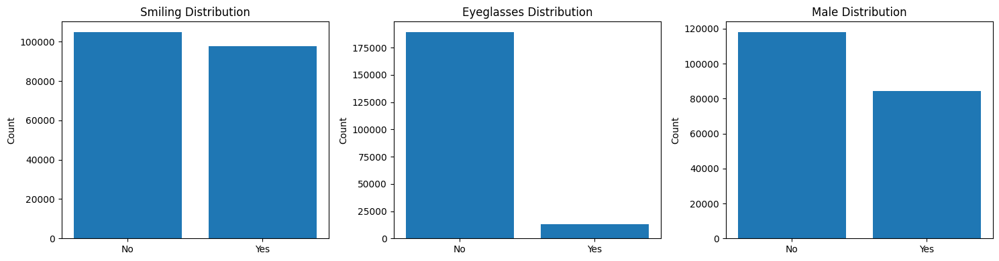


selected attributes balance:
  Smiling: {0: 104930, 1: 97669}
  Eyeglasses: {0: 189406, 1: 13193}
  Male: {0: 118165, 1: 84434}


In [2]:
# cell 2: dataset exploration
# load attributes csv
attr_path = "/kaggle/input/celeba-dataset/list_attr_celeba.csv"
df = pd.read_csv(attr_path)

print(f"dataset shape: {df.shape}")
print(f"\ncolumns: {list(df.columns[:10])}...")

# convert -1/1 to 0/1
for col in df.columns[1:]:
    df[col] = (df[col] + 1) // 2

# plot selected attribute distribution
fig, axes = plt.subplots(1, 3, figsize=(15, 4))
for i, attr in enumerate(CONFIG["selected_attrs"]):
    counts = df[attr].value_counts()
    axes[i].bar(["No", "Yes"], [counts[0], counts[1]])
    axes[i].set_title(f"{attr} Distribution")
    axes[i].set_ylabel("Count")
plt.tight_layout()
plt.show()

print(f"\nselected attributes balance:")
for attr in CONFIG["selected_attrs"]:
    print(f"  {attr}: {df[attr].value_counts().to_dict()}")

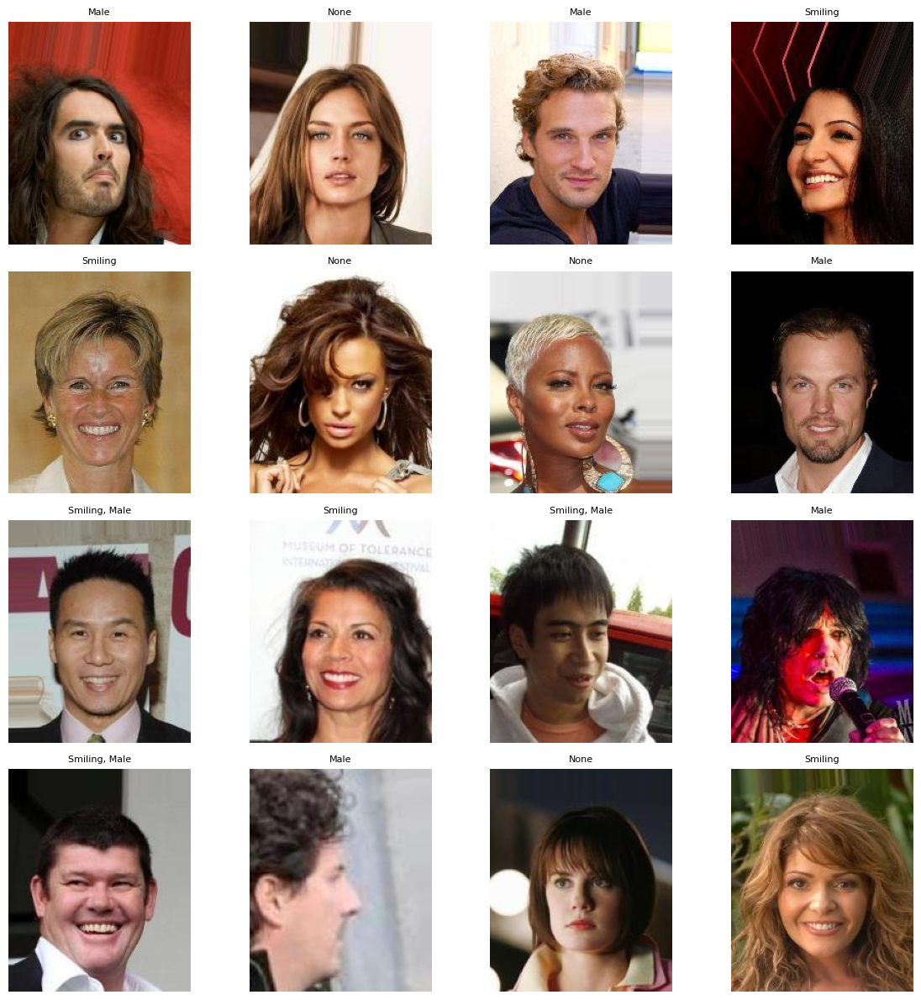

In [3]:
# cell 3: display sample images
images_dir = "/kaggle/input/celeba-dataset/img_align_celeba/img_align_celeba"

# get random sample files
sample_indices = np.random.choice(len(df), 16, replace=False)
sample_files = df.iloc[sample_indices]["image_id"].values

fig, axes = plt.subplots(4, 4, figsize=(12, 12))
axes = axes.flatten()

for i, fname in enumerate(sample_files):
    img_path = os.path.join(images_dir, fname)
    img = plt.imread(img_path)
    axes[i].imshow(img)

    # get attributes
    row = df[df["image_id"] == fname].iloc[0]
    attrs_text = ", ".join(
        [attr for attr in CONFIG["selected_attrs"] if row[attr] == 1]
    )
    axes[i].set_title(attrs_text if attrs_text else "None", fontsize=8)
    axes[i].axis("off")

plt.tight_layout()
plt.show()

attribute combinations (8 total):
  (1, 0, 0): 62586 images
  (0, 0, 0): 52864 images
  (0, 0, 1): 44175 images
  (1, 0, 1): 29781 images
  (0, 1, 1): 6461 images
  (1, 1, 1): 4017 images
  (0, 1, 0): 1430 images
  (1, 1, 0): 1285 images

sampled 10280 images


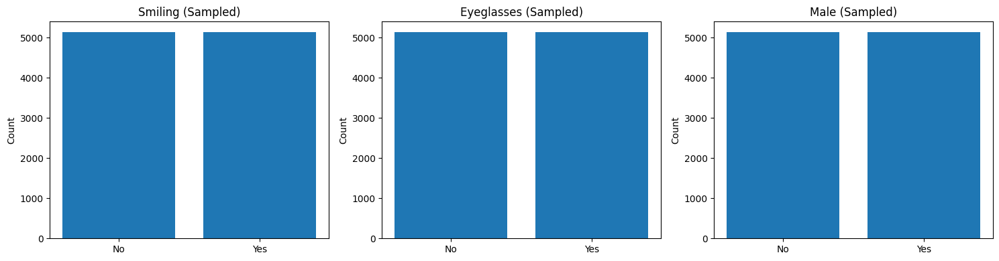

files ready: 10280
attributes shape: (10280, 3)


In [4]:
# cell 4: balanced sampling
# create combination buckets
df["attr_combo"] = df[CONFIG["selected_attrs"]].apply(lambda x: tuple(x), axis=1)
combo_counts = df["attr_combo"].value_counts()

print(f"attribute combinations (8 total):")
for combo, count in combo_counts.items():
    print(f"  {combo}: {count} images")

# balanced sampling
per_bucket = CONFIG["sample_size"] // len(combo_counts)
sampled_indices = []

for combo in combo_counts.index:
    combo_df = df[df["attr_combo"] == combo]
    n_sample = min(per_bucket, len(combo_df))
    sampled_indices.extend(combo_df.sample(n_sample, random_state=42).index.tolist())

# limit to target size
sampled_indices = sampled_indices[: CONFIG["sample_size"]]
sampled_df = df.loc[sampled_indices]

print(f"\nsampled {len(sampled_df)} images")

# get file paths and attributes
sampled_files = [
    os.path.join(images_dir, fname) for fname in sampled_df["image_id"].values
]
sampled_attrs = sampled_df[CONFIG["selected_attrs"]].values.astype(np.float32)

# plot sampled distribution
fig, axes = plt.subplots(1, 3, figsize=(15, 4))
for i, attr in enumerate(CONFIG["selected_attrs"]):
    counts = sampled_df[attr].value_counts()
    axes[i].bar(["No", "Yes"], [counts.get(0, 0), counts.get(1, 0)])
    axes[i].set_title(f"{attr} (Sampled)")
    axes[i].set_ylabel("Count")
plt.tight_layout()
plt.show()

print(f"files ready: {len(sampled_files)}")
print(f"attributes shape: {sampled_attrs.shape}")

## Step 1: Define Combinations

There are 8 possible combinations (2³ = 8) based on the attributes (Smiling, Eyeglasses, Male).

* **(1,0,0)**: Smiling, No glasses, Female → 62,586 images
* **(0,0,0)**: Not smiling, No glasses, Female → 52,864 images
* **(0,0,1)**: Not smiling, No glasses, Male → 44,175 images
* **(1,0,1)**: Smiling, No glasses, Male → 29,781 images
* **(0,1,1)**: Not smiling, Glasses, Male → 6,461 images
* **(1,1,1)**: Smiling, Glasses, Male → 4,017 images
* **(0,1,0)**: Not smiling, Glasses, Female → 1,430 images (*Very rare!*)
* **(1,1,0)**: Smiling, Glasses, Female → 1,285 images (*Rarest!*)

---

## Step 2: Calculate Target per Bucket

The target is 40,000 images total, so the ideal number per combination (bucket) is:

**10,280 / 8 = 1,285 images per combination**

---

## Step 3: Sample from Each Bucket

We attempt to sample 1,285 images from each bucket.

* **(1,0,0)**: Has 62,586 available → **Take 1,285**
* **(0,0,0)**: Has 52,864 available → **Take 1,285**
* **(0,0,1)**: Has 44,175 available → **Take 1,285**
* **(1,0,1)**: Has 29,781 available → **Take 1,285**
* **(0,1,1)**: Has 6,461 available → **Take 1,285**
* **(1,1,1)**: Has 4,017 available → **Take 1,285**
* **(0,1,0)**: Has 1,430 available → **Take 1,285**
* **(1,1,0)**: Has 1,285 available → **Take 1,285**

---

## Step 4: Calculate Total Sampled

* **From 8 combinations with enough data:** 8 × 1,285 = **10,280** images
* **Total:** = **10,280 images**

The final dataset contains 10,280 image (some combination may fall short of the goal because the rarest combinations lack sufficient data).

---

**ATTRIBUTES LIST**

- '5_o_Clock_Shadow', 'Arched_Eyebrows', 'Attractive',
- 'Bags_Under_Eyes', 'Bald', 'Bangs', 'Big_Lips', 'Big_Nose',
- 'Black_Hair', 'Blond_Hair', 'Blurry', 'Brown_Hair', 'Bushy_Eyebrows',
- 'Chubby', 'Double_Chin', 'Eyeglasses', 'Goatee', 'Gray_Hair',
- 'Heavy_Makeup', 'High_Cheekbones', 'Male', 'Mouth_Slightly_Open',
- 'Mustache', 'Narrow_Eyes', 'No_Beard', 'Oval_Face', 'Pale_Skin',
- 'Pointy_Nose', 'Receding_Hairline', 'Rosy_Cheeks', 'Sideburns',
- 'Smiling', 'Straight_Hair', 'Wavy_Hair', 'Wearing_Earrings',
- 'Wearing_Hat', 'Wearing_Lipstick', 'Wearing_Necklace',
- 'Wearing_Necktie', 'Young'

I0000 00:00:1761892302.692128      19 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 15513 MB memory:  -> device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0


train samples: 9252
val samples: 1028
batch shapes - images: (64, 64, 64, 3), attributes: (64, 3)
image range: [-1.000, 1.000]


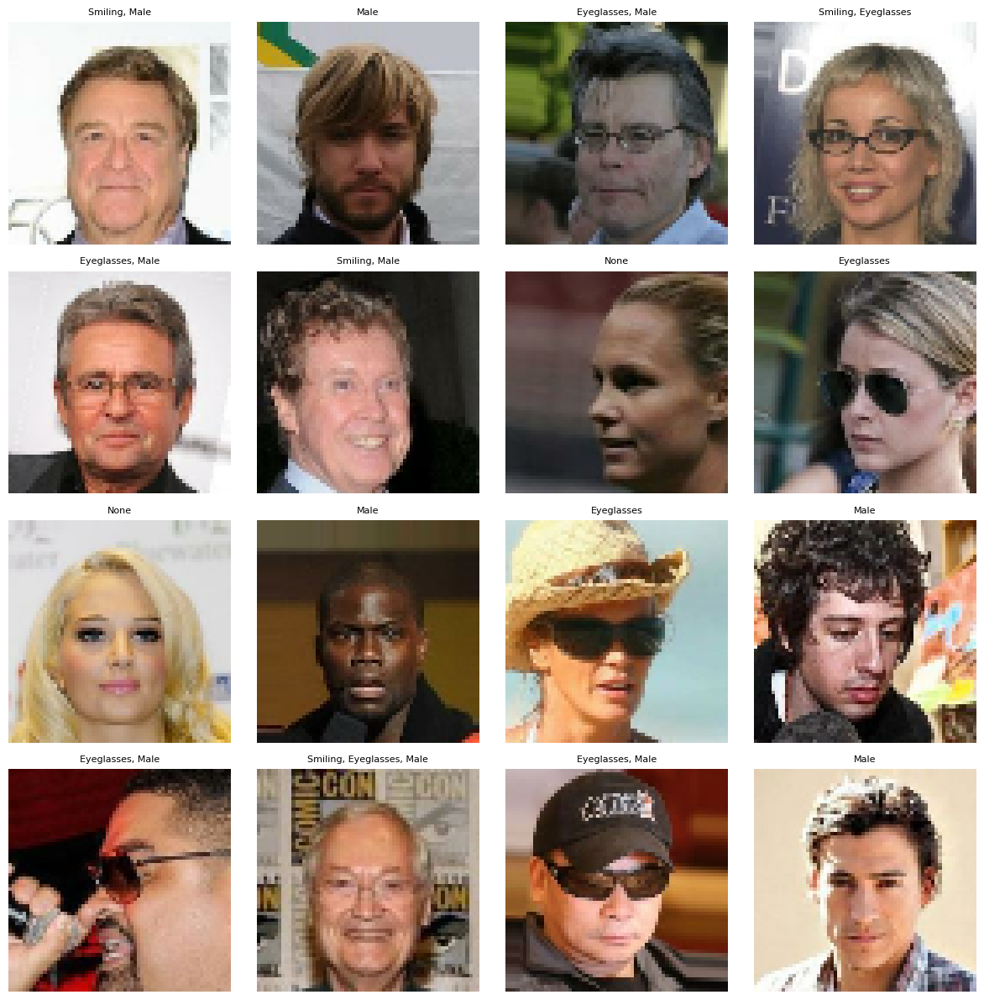

In [5]:
# cell 5: build tf.data pipeline
def load_and_preprocess(path, attrs):
    # read image
    img = tf.io.read_file(path)
    img = tf.io.decode_jpeg(img, channels=3)
    img = tf.cast(img, tf.float32)

    # center crop
    h, w = tf.shape(img)[0], tf.shape(img)[1]
    m = tf.minimum(h, w)
    top = (h - m) // 2
    left = (w - m) // 2
    img = tf.image.crop_to_bounding_box(img, top, left, m, m)

    # resize and normalize
    img = tf.image.resize(img, [CONFIG["img_size"], CONFIG["img_size"]])
    img = (img / 127.5) - 1.0
    img = tf.clip_by_value(img, -1.0, 1.0)

    return img, attrs

# create dataset
ds = tf.data.Dataset.from_tensor_slices((sampled_files, sampled_attrs))
ds = ds.map(load_and_preprocess, num_parallel_calls=tf.data.AUTOTUNE)
ds = ds.cache()
ds = ds.shuffle(10000, seed=42)

# train/val split
val_size = int(0.1 * len(sampled_files)) # have to change 0.1 to 0.2 for 80-20 split
val_ds = ds.take(val_size).batch(CONFIG["batch_size"]).prefetch(tf.data.AUTOTUNE)
train_ds = ds.skip(val_size).batch(CONFIG["batch_size"]).prefetch(tf.data.AUTOTUNE)

print(f"train samples: {len(sampled_files) - val_size}")
print(f"val samples: {val_size}")

# visualize one batch
for imgs, attrs in train_ds.take(1):
    print(f"batch shapes - images: {imgs.shape}, attributes: {attrs.shape}")
    print(
        f"image range: [{tf.reduce_min(imgs).numpy():.3f}, {tf.reduce_max(imgs).numpy():.3f}]"
    )

    # display 16 images
    fig, axes = plt.subplots(4, 4, figsize=(12, 12))
    axes = axes.flatten()
    for i in range(16):
        img = (imgs[i].numpy() + 1.0) * 0.5
        axes[i].imshow(img)
        attr_labels = [
            CONFIG["selected_attrs"][j] for j in range(3) if attrs[i, j].numpy() > 0.5
        ]
        axes[i].set_title(", ".join(attr_labels) if attr_labels else "None", fontsize=8)
        axes[i].axis("off")
    plt.tight_layout()
    plt.show()

Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ z (InputLayer)      │ (None, 100)       │          0 │ -                 │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ attrs (InputLayer)  │ (None, 3)         │          0 │ -                 │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ cast (Cast)         │ (None, 100)       │          0 │ z[0][0]           │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ cast_1 (Cast)       │ (None, 3)         │          0 │ attrs[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate         │ (None, 103)       │          0 │ cast[0][0],       │
│ (Concatenate)       │                   │            │ cast_1[0][0]      │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense (Dense)       │ (None, 4096)      │    421,888 │ concatenate[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reshape (Reshape)   │ (None, 4, 4, 256) │          0 │ dense[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 4, 4, 256) │      1,024 │ reshape[0][0]     │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu         │ (None, 4, 4, 256) │          0 │ batch_normalizat… │
│ (LeakyReLU)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose    │ (None, 8, 8, 128) │    524,288 │ leaky_re_lu[0][0] │
│ (Conv2DTranspose)   │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 8, 8, 128) │        512 │ conv2d_transpose… │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_1       │ (None, 8, 8, 128) │          0 │ batch_normalizat… │
│ (LeakyReLU)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose_1  │ (None, 16, 16,    │    131,072 │ leaky_re_lu_1[0]… │
│ (Conv2DTranspose)   │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 16, 16,    │        256 │ conv2d_transpose… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_2       │ (None, 16, 16,    │          0 │ batch_normalizat… │
│ (LeakyReLU)         │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose_2  │ (None, 32, 32,    │     32,768 │ leaky_re_lu_2[0]… │
│ (Conv2DTranspose)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │        128 │ conv2d_transpose… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_3       │ (None, 32, 32,    │          0 │ batch_normalizat… │
│ (LeakyReLU)         │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose_3  │ (None, 64, 64, 3) │      1,536 │ leaky_re_lu_3[0]

 Total params: 1,113,472 (4.25 MB)

 Trainable params: 1,112,512 (4.24 MB)

 Non-trainable params: 960 (3.75 KB)

I0000 00:00:1761892325.676849      19 cuda_dnn.cc:529] Loaded cuDNN version 90300



test generation:
  output shape: (4, 64, 64, 3)
  output range: [-0.033, 0.031]


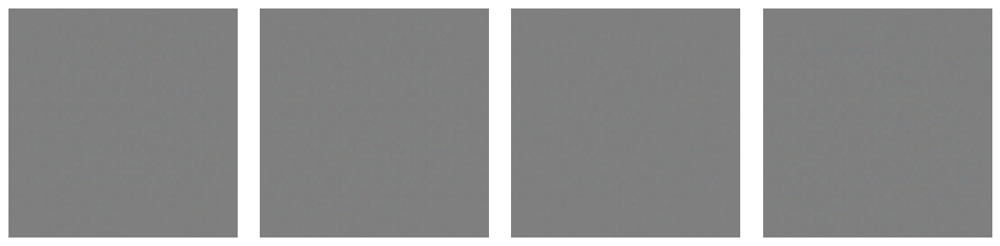

In [6]:
# cell 6: generator definition
def build_generator():
    # inputs
    z = layers.Input(shape=(CONFIG["latent_dim"],), name="z")
    attrs = layers.Input(shape=(CONFIG["n_attrs"],), name="attrs")

    # concat
    x = layers.Concatenate()([z, attrs])

    # dense and reshape
    x = layers.Dense(4 * 4 * 256, use_bias=False)(x)
    x = layers.Reshape((4, 4, 256))(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(0.2)(x)

    # upsample 4x4 -> 8x8
    x = layers.Conv2DTranspose(128, 4, strides=2, padding="same", use_bias=False)(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(0.2)(x)

    # upsample 8x8 -> 16x16
    x = layers.Conv2DTranspose(64, 4, strides=2, padding="same", use_bias=False)(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(0.2)(x)

    # upsample 16x16 -> 32x32
    x = layers.Conv2DTranspose(32, 4, strides=2, padding="same", use_bias=False)(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(0.2)(x)

    # upsample 32x32 -> 64x64
    x = layers.Conv2DTranspose(3, 4, strides=2, padding="same", use_bias=False)(x)
    x = layers.Activation("tanh", dtype="float32")(x)

    model = keras.Model([z, attrs], x, name="generator")
    return model

generator = build_generator()
generator.summary()

# test forward pass
test_z = tf.random.normal([4, CONFIG["latent_dim"]])
test_attrs = tf.constant([[1, 0, 0], [0, 1, 0], [0, 0, 1], [1, 1, 1]], dtype=tf.float32)
test_imgs = generator([test_z, test_attrs], training=False)

print(f"\ntest generation:")
print(f"  output shape: {test_imgs.shape}")
print(f"  output range: [{tf.reduce_min(test_imgs).numpy():.3f}, {tf.reduce_max(test_imgs).numpy():.3f}]")

# display test images [expected to be grey]
fig, axes = plt.subplots(1, 4, figsize=(12, 3))
for i in range(4):
    img = (test_imgs[i].numpy() + 1.0) * 0.5
    img = img.astype(np.float32) # convert from float16 to float32
    axes[i].imshow(img)
    axes[i].axis('off')
plt.tight_layout()
plt.show()

In [7]:
# cell 7: discriminator definition
def build_discriminator():
    # inputs
    img = layers.Input(shape=(CONFIG["img_size"], CONFIG["img_size"], 3), name="image")
    attrs = layers.Input(shape=(CONFIG["n_attrs"],), name="attrs")

    # downsample 64x64 -> 32x32
    x = layers.Conv2D(32, 4, strides=2, padding='same')(img)
    x = layers.LeakyReLU(0.2)(x)

    # downsample 32x32 -> 16x16
    x = layers.Conv2D(64, 4, strides=2, padding="same")(x)
    x = layers.LeakyReLU(0.2)(x)

    # downsample 16x16 -> 8x8
    x = layers.Conv2D(128, 4, strides=2, padding="same")(x)
    x = layers.LeakyReLU(0.2)(x)

    # downsample 8x8 -> 4x4
    x = layers.Conv2D(256, 4, strides=2, padding="same")(x)
    x = layers.LeakyReLU(0.2)(x)

    # flatten
    x = layers.Flatten()(x)
    feat = layers.Dense(128, dtype="float32")(x)

    # attribute classifier head
    attr_pred = layers.Dense(
        CONFIG["n_attrs"], activation="sigmoid", dtype="float32", name="attr_pred"
    )(feat)

    # conditional projection (simplified - no normalization)
    attr_proj = layers.Dense(128, use_bias=False, dtype='float32')(attrs)
    projection = layers.Dot(axes=1)([feat, attr_proj])
    projection = layers.Reshape((-1, 1))(projection)

    # real/fake logit
    real_fake = layers.Dense(1, dtype="float32")(feat)
    output = real_fake + projection

    model = keras.Model([img, attrs], [output, attr_pred], name="discriminator")
    return model

discriminator = build_discriminator()
discriminator.summary()

# test forward pass
test_real, _ = next(iter(train_ds.take(1)))
test_logits, test_attr_pred = discriminator([test_real[:4], test_attrs], training=False)

print(f"\ntest discrimination:")
print(f"  logits shape: {test_logits.shape}")
print(f"  attr_pred shape: {test_attr_pred.shape}")
print(f"  logits sample: {test_logits[:2].numpy().flatten()}")
print(f"  attr_pred sample: {test_attr_pred[0].numpy()}")

Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ image (InputLayer)  │ (None, 64, 64, 3) │          0 │ -                 │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ cast_3 (Cast)       │ (None, 64, 64, 3) │          0 │ image[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 32, 32,    │      1,568 │ cast_3[0][0]      │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_4       │ (None, 32, 32,    │          0 │ conv2d[0][0]      │
│ (LeakyReLU)         │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 16, 16,    │     32,832 │ leaky_re_lu_4[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_5       │ (None, 16, 16,    │          0 │ conv2d_1[0][0]    │
│ (LeakyReLU)         │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 8, 8, 128) │    131,200 │ leaky_re_lu_5[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_6       │ (None, 8, 8, 128) │          0 │ conv2d_2[0][0]    │
│ (LeakyReLU)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 4, 4, 256) │    524,544 │ leaky_re_lu_6[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_7       │ (None, 4, 4, 256) │          0 │ conv2d_3[0][0]    │
│ (LeakyReLU)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ flatten (Flatten)   │ (None, 4096)      │          0 │ leaky_re_lu_7[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ cast_4 (Cast)       │ (None, 4096)      │          0 │ flatten[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ attrs (InputLayer)  │ (None, 3)         │          0 │ -                 │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_1 (Dense)     │ (None, 128)       │    524,416 │ cast_4[0][0]      │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_2 (Dense)     │ (None, 128)       │        384 │ attrs[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ cast_5 (Cast)       │ (None, 128)       │          0 │ dense_1[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ cast_6 (Cast)       │ (None, 128)       │          0 │ dense_2[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dot (Dot)           │ (None, 1)         │          0 │ cast_5[0][0],     │
│                     │                   │            │ cast_6[0][0]      │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_3 (Dense)     │ (None, 1)         │        129 │ dense_1[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reshape_1 (Reshape) │ (None, 1, 1)      │          0 │ dot[0][0]         │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add (Add)           │ (None, None, 1)   │          0 │ dense_3[0][0],    │
│                     │                   │            │ reshape_1[0][0] 

 Total params: 1,215,460 (4.64 MB)

 Trainable params: 1,215,460 (4.64 MB)

 Non-trainable params: 0 (0.00 B)


test discrimination:
  logits shape: (4, 4, 1)
  attr_pred shape: (4, 3)
  logits sample: [0.01852398 0.03848355 0.09272325 0.03703985 0.13134748 0.15130703
 0.20554674 0.14986333]
  attr_pred sample: [0.4776832  0.49588928 0.483204  ]


In [8]:
# cell 8: loss functions and optimizers
# hinge loss
def discriminator_hinge_loss(real_logits, fake_logits):
    real_loss = tf.reduce_mean(tf.nn.relu(1.0 - real_logits))
    fake_loss = tf.reduce_mean(tf.nn.relu(1.0 + fake_logits))
    return real_loss + fake_loss

def generator_hinge_loss(fake_logits):
    return -tf.reduce_mean(fake_logits)

# attribute loss
def attribute_loss(pred, target):
    return tf.reduce_mean(keras.losses.binary_crossentropy(target, pred))

# optimizers
opt_d_inner = keras.optimizers.Adam(learning_rate=CONFIG["lr"], beta_1=CONFIG["beta1"])
opt_g_inner = keras.optimizers.Adam(learning_rate=CONFIG["lr"], beta_1=CONFIG["beta1"])
opt_d = mixed_precision.LossScaleOptimizer(opt_d_inner)
opt_g = mixed_precision.LossScaleOptimizer(opt_g_inner)

print("loss functions:")
print("  discriminator: hinge loss + attribute bce")
print("  generator: hinge loss + attribute bce")
print(f"\noptimizer config:")
print(f"  lr: {CONFIG['lr']}, beta1: {CONFIG['beta1']}")

loss functions:
  discriminator: hinge loss + attribute bce
  generator: hinge loss + attribute bce

optimizer config:
  lr: 0.001, beta1: 0.0


In [9]:
# cell 9: training metrics setup
# metrics
train_d_loss = keras.metrics.Mean(name="train_d_loss")
train_g_loss = keras.metrics.Mean(name="train_g_loss")
train_d_adv = keras.metrics.Mean(name="train_d_adv")
train_d_attr = keras.metrics.Mean(name="train_d_attr")
train_g_adv = keras.metrics.Mean(name="train_g_adv")
train_g_attr = keras.metrics.Mean(name="train_g_attr")
val_attr_acc = keras.metrics.BinaryAccuracy(name="val_attr_acc")
train_attr_acc = keras.metrics.BinaryAccuracy(name='train_attr_acc')

# history for plotting
history = {
    "d_loss": [],
    "g_loss": [],
    "d_adv": [],
    "d_attr": [],
    "g_adv": [],
    "g_attr": [],
    "val_attr_acc": [],
    "train_attr_acc": []
}

# checkpoint
ckpt = tf.train.Checkpoint(
    generator=generator,
    discriminator=discriminator,
    opt_g=opt_g_inner,
    opt_d=opt_d_inner,
    epoch=tf.Variable(1),
)
manager = tf.train.CheckpointManager(ckpt, CONFIG["checkpoint_dir"], max_to_keep=3)

# early stopping on val_attr_acc
best_val_acc = 0.0
patience_counter = 0
patience = 1620 # has to equal the number of epochs for better picture quality

# reduce lr on plateau
plateau_counter = 0
plateau_patience = 162

# restore if exists
start_epoch = 1
if manager.latest_checkpoint:
    ckpt.restore(manager.latest_checkpoint)
    start_epoch = int(ckpt.epoch.numpy())
    print(f"restored from checkpoint: epoch {start_epoch}")
else:
    print("starting from scratch")

# fixed noise for visualization
fixed_z = tf.random.normal([64, CONFIG["latent_dim"]], seed=42)
fixed_attrs = np.zeros((64, 3), dtype=np.float32)
for i in range(64):
    fixed_attrs[i, 0] = (i >> 0) & 1
    fixed_attrs[i, 1] = (i >> 1) & 1
    fixed_attrs[i, 2] = (i >> 2) & 1
fixed_attrs = tf.constant(fixed_attrs, dtype=tf.float32)

print(f"\nmetrics initialized")
print(f"starting epoch: {start_epoch}")
print(f"fixed visualization: 64 samples with 8 attribute combinations")

starting from scratch

metrics initialized
starting epoch: 1
fixed visualization: 64 samples with 8 attribute combinations


In [10]:
# cell 10: training step definition
@tf.function
def train_step(real_imgs, real_attrs):
    batch_size = tf.shape(real_imgs)[0]
    z = tf.random.normal([batch_size, CONFIG["latent_dim"]])

    # train discriminator
    with tf.GradientTape() as d_tape:
        fake_imgs = generator([z, real_attrs], training=True)

        real_logits, real_attr_pred = discriminator(
            [real_imgs, real_attrs], training=True
        )
        fake_logits, fake_attr_pred = discriminator(
            [fake_imgs, real_attrs], training=True
        )

        d_adv_loss = discriminator_hinge_loss(real_logits, fake_logits)
        d_attr_loss = attribute_loss(real_attr_pred, real_attrs)
        d_loss = d_adv_loss + d_attr_loss

    d_grads = d_tape.gradient(d_loss, discriminator.trainable_variables)
    d_grads, _ = tf.clip_by_global_norm(d_grads, 1.0)
    opt_d.apply_gradients(zip(d_grads, discriminator.trainable_variables))

    # train generator
    with tf.GradientTape() as g_tape:
        fake_imgs = generator([z, real_attrs], training=True)
        fake_logits, fake_attr_pred = discriminator(
            [fake_imgs, real_attrs], training=True
        )

        g_adv_loss = generator_hinge_loss(fake_logits)
        g_attr_loss = attribute_loss(fake_attr_pred, real_attrs)
        g_loss = g_adv_loss + g_attr_loss

    g_grads = g_tape.gradient(g_loss, generator.trainable_variables)
    g_grads, _ = tf.clip_by_global_norm(g_grads, 1.0)
    opt_g.apply_gradients(zip(g_grads, generator.trainable_variables))

    return {
        "d_loss": d_loss,
        "g_loss": g_loss,
        "d_adv": d_adv_loss,
        "d_attr": d_attr_loss,
        "g_adv": g_adv_loss,
        "g_attr": g_attr_loss,
    }

# test single step
test_batch = next(iter(train_ds))
test_losses = train_step(test_batch[0], test_batch[1])

print("test training step:")
for k, v in test_losses.items():
    print(f"  {k}: {v.numpy():.4f}")

test training step:
  d_loss: 2.6540
  g_loss: 0.6476
  d_adv: 1.9609
  d_attr: 0.6932
  g_adv: -0.0465
  g_attr: 0.6941


In [11]:
# cell 11: visualization functions
def plot_losses(history, epoch):
    fig, axes = plt.subplots(2, 2, figsize=(12, 8))

    # d and g loss
    axes[0, 0].plot(history["d_loss"], label="D Loss")
    axes[0, 0].plot(history["g_loss"], label="G Loss")
    axes[0, 0].set_title("Adversarial Losses")
    axes[0, 0].set_xlabel("Epoch")
    axes[0, 0].set_ylabel("Loss")
    axes[0, 0].legend()
    axes[0, 0].grid(True)

    # d components
    axes[0, 1].plot(history["d_adv"], label="D Adv")
    axes[0, 1].plot(history["d_attr"], label="D Attr")
    axes[0, 1].set_title("Discriminator Components")
    axes[0, 1].set_xlabel("Epoch")
    axes[0, 1].set_ylabel("Loss")
    axes[0, 1].legend()
    axes[0, 1].grid(True)

    # g components
    axes[1, 0].plot(history["g_adv"], label="G Adv")
    axes[1, 0].plot(history["g_attr"], label="G Attr")
    axes[1, 0].set_title("Generator Components")
    axes[1, 0].set_xlabel("Epoch")
    axes[1, 0].set_ylabel("Loss")
    axes[1, 0].legend()
    axes[1, 0].grid(True)

    # val attr acc
    ax2 = axes[1, 1]
    ax2.plot(history["val_attr_acc"], "g-", label="Val Attr Acc")
    ax2.set_xlabel("Epoch")
    ax2.set_ylabel("Accuracy", color="g")
    ax2.tick_params(axis="y", labelcolor="g")
    ax2.grid(True)

    plt.tight_layout()
    plt.savefig(
        os.path.join(CONFIG["samples_dir"], f"losses_epoch_{epoch:03d}.png"), dpi=100
    )
    plt.show()

def plot_generated_samples(imgs, epoch, nrow=8):
    n = len(imgs)
    ncol = nrow
    nrow = (n + ncol - 1) // ncol

    fig, axes = plt.subplots(nrow, ncol, figsize=(ncol * 1.5, nrow * 1.5))
    if nrow == 1:
        axes = axes.reshape(1, -1)

    for i in range(nrow * ncol):
        r, c = i // ncol, i % ncol
        if i < n:
            img = (imgs[i] + 1.0) * 0.5
            img = np.clip(img, 0, 1).astype(np.float32) # convert float16 to float32
            axes[r, c].imshow(img)

    plt.tight_layout()
    plt.savefig(
        os.path.join(CONFIG["samples_dir"], f"samples_epoch_{epoch:03d}.png"), dpi=100
    )
    plt.show()

def compute_confusion_matrices(val_ds, discriminator):
    all_true = []
    all_pred = []

    for imgs, attrs in val_ds:
        _, pred = discriminator([imgs, attrs], training=False)
        all_true.append(attrs.numpy())
        all_pred.append((pred.numpy() > 0.5).astype(np.float32))

    all_true = np.concatenate(all_true, axis=0)
    all_pred = np.concatenate(all_pred, axis=0)

    fig, axes = plt.subplots(1, 3, figsize=(15, 4))

    for i, attr_name in enumerate(CONFIG["selected_attrs"]):
        cm = confusion_matrix(all_true[:, i], all_pred[:, i])
        sns.heatmap(
            cm,
            annot=True,
            fmt="d",
            cmap="Blues",
            ax=axes[i],
            xticklabels=["No", "Yes"],
            yticklabels=["No", "Yes"],
        )
        axes[i].set_title(f"{attr_name}")
        axes[i].set_ylabel("True")
        axes[i].set_xlabel("Predicted")

    plt.tight_layout()
    plt.show()

    # print classification report
    print("\nclassification report:")
    for i, attr_name in enumerate(CONFIG["selected_attrs"]):
        print(f"\n{attr_name}:")
        print(
            classification_report(
                all_true[:, i], all_pred[:, i], target_names=["No", "Yes"], digits=4
            )
        )

print("visualization functions ready")

visualization functions ready



epoch 1/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.6412
new best val_acc: 0.7208
d_loss: 1.9484 | g_loss: 1.5312 | val_attr_acc: 0.7208

epoch 2/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.7731
new best val_acc: 0.8110
d_loss: 2.1966 | g_loss: 1.1713 | val_attr_acc: 0.8110

epoch 3/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.8421
new best val_acc: 0.8508
d_loss: 1.8693 | g_loss: 1.1293 | val_attr_acc: 0.8508

epoch 4/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.8725
new best val_acc: 0.8771
d_loss: 1.7708 | g_loss: 1.0977 | val_attr_acc: 0.8771

epoch 5/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.8907
new best val_acc: 0.8949
d_loss: 1.5928 | g_loss: 1.0996 | val_attr_acc: 0.8949

epoch 6/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9006
new best val_acc: 0.8956
d_loss: 1.4649 | g_loss: 1.0636 | val_attr_acc: 0.8956

epoch 7/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9078
new best val_acc: 0.9024
d_loss: 1.4654 | g_loss: 1.0789 | val_attr_acc: 0.9024

epoch 8/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9120
new best val_acc: 0.9060
d_loss: 1.4312 | g_loss: 1.0815 | val_attr_acc: 0.9060

epoch 9/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9154
new best val_acc: 0.9076
d_loss: 1.4101 | g_loss: 1.1117 | val_attr_acc: 0.9076

epoch 10/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9168
new best val_acc: 0.9189
d_loss: 1.1816 | g_loss: 1.1403 | val_attr_acc: 0.9189

epoch 11/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9205
d_loss: 1.1376 | g_loss: 1.1595 | val_attr_acc: 0.9173

epoch 12/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9222
new best val_acc: 0.9209
d_loss: 1.1780 | g_loss: 1.1606 | val_attr_acc: 0.9209

epoch 13/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9227
new best val_acc: 0.9248
d_loss: 1.1837 | g_loss: 1.1580 | val_attr_acc: 0.9248

epoch 14/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9238
new best val_acc: 0.9274
d_loss: 1.1484 | g_loss: 1.1835 | val_attr_acc: 0.9274

epoch 15/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9250
d_loss: 0.9741 | g_loss: 1.2077 | val_attr_acc: 0.9157

epoch 16/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9270
d_loss: 0.9609 | g_loss: 1.2402 | val_attr_acc: 0.9228

epoch 17/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9268
new best val_acc: 0.9280
d_loss: 0.9593 | g_loss: 1.2535 | val_attr_acc: 0.9280

epoch 18/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9292
d_loss: 0.9540 | g_loss: 1.2564 | val_attr_acc: 0.9228

epoch 19/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9290
d_loss: 0.8753 | g_loss: 1.2819 | val_attr_acc: 0.9215

epoch 20/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9285
new best val_acc: 0.9290
d_loss: 0.8173 | g_loss: 1.3178 | val_attr_acc: 0.9290

epoch 21/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9307
new best val_acc: 0.9296
d_loss: 0.8022 | g_loss: 1.3368 | val_attr_acc: 0.9296

epoch 22/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9309
d_loss: 0.8012 | g_loss: 1.3397 | val_attr_acc: 0.9283

epoch 23/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9308
d_loss: 0.7902 | g_loss: 1.3604 | val_attr_acc: 0.9248

epoch 24/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9321
new best val_acc: 0.9296
d_loss: 0.7369 | g_loss: 1.3682 | val_attr_acc: 0.9296

epoch 25/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9319
d_loss: 0.7237 | g_loss: 1.3900 | val_attr_acc: 0.9293

epoch 26/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9329
d_loss: 0.7152 | g_loss: 1.3942 | val_attr_acc: 0.9283

epoch 27/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9330
new best val_acc: 0.9329
d_loss: 0.7024 | g_loss: 1.4018 | val_attr_acc: 0.9329

epoch 28/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9329
d_loss: 0.6809 | g_loss: 1.4284 | val_attr_acc: 0.9326

epoch 29/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9320
d_loss: 0.6630 | g_loss: 1.4259 | val_attr_acc: 0.9306

epoch 30/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9337
new best val_acc: 0.9397
d_loss: 0.6471 | g_loss: 1.4487 | val_attr_acc: 0.9397

epoch 31/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9328
d_loss: 0.6471 | g_loss: 1.4493 | val_attr_acc: 0.9277

epoch 32/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9338
d_loss: 0.6428 | g_loss: 1.4496 | val_attr_acc: 0.9326

epoch 33/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9335
d_loss: 0.6281 | g_loss: 1.4555 | val_attr_acc: 0.9361

epoch 34/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9335
d_loss: 0.6206 | g_loss: 1.4672 | val_attr_acc: 0.9319

epoch 35/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9334
d_loss: 0.6163 | g_loss: 1.4709 | val_attr_acc: 0.9381

epoch 36/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.6057 | g_loss: 1.4768 | val_attr_acc: 0.9342

epoch 37/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.6050 | g_loss: 1.4822 | val_attr_acc: 0.9361

epoch 38/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9339
d_loss: 0.6000 | g_loss: 1.4789 | val_attr_acc: 0.9319

epoch 39/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5995 | g_loss: 1.4798 | val_attr_acc: 0.9290

epoch 40/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5975 | g_loss: 1.4748 | val_attr_acc: 0.9361

epoch 41/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9339
d_loss: 0.5934 | g_loss: 1.4960 | val_attr_acc: 0.9274

epoch 42/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5884 | g_loss: 1.4889 | val_attr_acc: 0.9248

epoch 43/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5862 | g_loss: 1.4851 | val_attr_acc: 0.9384

epoch 44/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5847 | g_loss: 1.4865 | val_attr_acc: 0.9377

epoch 45/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5930 | g_loss: 1.4852 | val_attr_acc: 0.9355

epoch 46/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5908 | g_loss: 1.4855 | val_attr_acc: 0.9381

epoch 47/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5926 | g_loss: 1.4831 | val_attr_acc: 0.9283

epoch 48/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5892 | g_loss: 1.4853 | val_attr_acc: 0.9390

epoch 49/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5907 | g_loss: 1.4816 | val_attr_acc: 0.9355

epoch 50/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
new best val_acc: 0.9413
d_loss: 0.5880 | g_loss: 1.4852 | val_attr_acc: 0.9413

epoch 51/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5861 | g_loss: 1.4874 | val_attr_acc: 0.9290

epoch 52/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5791 | g_loss: 1.4880 | val_attr_acc: 0.9306

epoch 53/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5772 | g_loss: 1.4988 | val_attr_acc: 0.9351

epoch 54/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9359
d_loss: 0.5776 | g_loss: 1.4983 | val_attr_acc: 0.9235

epoch 55/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5882 | g_loss: 1.4856 | val_attr_acc: 0.9322

epoch 56/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5830 | g_loss: 1.4875 | val_attr_acc: 0.9348

epoch 57/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5805 | g_loss: 1.4912 | val_attr_acc: 0.9348

epoch 58/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5767 | g_loss: 1.4910 | val_attr_acc: 0.9413

epoch 59/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9358
d_loss: 0.5737 | g_loss: 1.4944 | val_attr_acc: 0.9377

epoch 60/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5781 | g_loss: 1.4967 | val_attr_acc: 0.9316

epoch 61/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5760 | g_loss: 1.4977 | val_attr_acc: 0.9283

epoch 62/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5749 | g_loss: 1.5033 | val_attr_acc: 0.9326

epoch 63/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5760 | g_loss: 1.4973 | val_attr_acc: 0.9342

epoch 64/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9339
new best val_acc: 0.9416
d_loss: 0.5800 | g_loss: 1.4981 | val_attr_acc: 0.9416

epoch 65/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5789 | g_loss: 1.4945 | val_attr_acc: 0.9335

epoch 66/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5739 | g_loss: 1.5031 | val_attr_acc: 0.9270

epoch 67/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5774 | g_loss: 1.4934 | val_attr_acc: 0.9368

epoch 68/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5760 | g_loss: 1.5026 | val_attr_acc: 0.9270

epoch 69/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5747 | g_loss: 1.4989 | val_attr_acc: 0.9368

epoch 70/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5721 | g_loss: 1.5040 | val_attr_acc: 0.9377

epoch 71/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5822 | g_loss: 1.4910 | val_attr_acc: 0.9364

epoch 72/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5720 | g_loss: 1.5077 | val_attr_acc: 0.9329

epoch 73/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5734 | g_loss: 1.4975 | val_attr_acc: 0.9332

epoch 74/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5843 | g_loss: 1.4885 | val_attr_acc: 0.9345

epoch 75/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5775 | g_loss: 1.4963 | val_attr_acc: 0.9290

epoch 76/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5825 | g_loss: 1.4886 | val_attr_acc: 0.9364

epoch 77/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5749 | g_loss: 1.4969 | val_attr_acc: 0.9319

epoch 78/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5806 | g_loss: 1.4914 | val_attr_acc: 0.9329

epoch 79/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5792 | g_loss: 1.4922 | val_attr_acc: 0.9329

epoch 80/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
new best val_acc: 0.9420
d_loss: 0.5700 | g_loss: 1.5140 | val_attr_acc: 0.9420

epoch 81/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5740 | g_loss: 1.5014 | val_attr_acc: 0.9277

epoch 82/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5775 | g_loss: 1.4964 | val_attr_acc: 0.9306

epoch 83/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5753 | g_loss: 1.4969 | val_attr_acc: 0.9400

epoch 84/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5784 | g_loss: 1.4919 | val_attr_acc: 0.9261

epoch 85/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
new best val_acc: 0.9423
d_loss: 0.5750 | g_loss: 1.4914 | val_attr_acc: 0.9423

epoch 86/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5817 | g_loss: 1.4940 | val_attr_acc: 0.9306

epoch 87/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9336
d_loss: 0.5802 | g_loss: 1.4998 | val_attr_acc: 0.9351

epoch 88/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5738 | g_loss: 1.5055 | val_attr_acc: 0.9400

epoch 89/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5763 | g_loss: 1.4988 | val_attr_acc: 0.9309

epoch 90/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5760 | g_loss: 1.4998 | val_attr_acc: 0.9293

epoch 91/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9356
new best val_acc: 0.9436
d_loss: 0.5788 | g_loss: 1.4875 | val_attr_acc: 0.9436

epoch 92/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5746 | g_loss: 1.5010 | val_attr_acc: 0.9326

epoch 93/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5757 | g_loss: 1.5010 | val_attr_acc: 0.9326

epoch 94/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5756 | g_loss: 1.5039 | val_attr_acc: 0.9364

epoch 95/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5734 | g_loss: 1.4957 | val_attr_acc: 0.9351

epoch 96/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5778 | g_loss: 1.4913 | val_attr_acc: 0.9397

epoch 97/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5729 | g_loss: 1.4977 | val_attr_acc: 0.9381

epoch 98/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9336
d_loss: 0.5779 | g_loss: 1.4955 | val_attr_acc: 0.9374

epoch 99/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5727 | g_loss: 1.5024 | val_attr_acc: 0.9403

epoch 100/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5796 | g_loss: 1.4884 | val_attr_acc: 0.9397

epoch 101/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9339
d_loss: 0.5794 | g_loss: 1.4980 | val_attr_acc: 0.9429

epoch 102/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9356
d_loss: 0.5780 | g_loss: 1.4977 | val_attr_acc: 0.9387

epoch 103/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5728 | g_loss: 1.5041 | val_attr_acc: 0.9313

epoch 104/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5760 | g_loss: 1.4989 | val_attr_acc: 0.9322

epoch 105/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5757 | g_loss: 1.5080 | val_attr_acc: 0.9313

epoch 106/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5755 | g_loss: 1.5011 | val_attr_acc: 0.9332

epoch 107/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5760 | g_loss: 1.4992 | val_attr_acc: 0.9368

epoch 108/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5755 | g_loss: 1.4995 | val_attr_acc: 0.9293

epoch 109/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5804 | g_loss: 1.4934 | val_attr_acc: 0.9342

epoch 110/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5777 | g_loss: 1.4928 | val_attr_acc: 0.9407

epoch 111/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5693 | g_loss: 1.5201 | val_attr_acc: 0.9403

epoch 112/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5795 | g_loss: 1.4925 | val_attr_acc: 0.9381

epoch 113/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5763 | g_loss: 1.4997 | val_attr_acc: 0.9364

epoch 114/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5827 | g_loss: 1.4896 | val_attr_acc: 0.9303

epoch 115/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9338
d_loss: 0.5758 | g_loss: 1.4977 | val_attr_acc: 0.9316

epoch 116/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5768 | g_loss: 1.4967 | val_attr_acc: 0.9345

epoch 117/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5828 | g_loss: 1.4869 | val_attr_acc: 0.9316

epoch 118/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5767 | g_loss: 1.5016 | val_attr_acc: 0.9368

epoch 119/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9339
d_loss: 0.5799 | g_loss: 1.4943 | val_attr_acc: 0.9374

epoch 120/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5773 | g_loss: 1.4956 | val_attr_acc: 0.9351

epoch 121/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9358
d_loss: 0.5769 | g_loss: 1.4945 | val_attr_acc: 0.9313

epoch 122/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5726 | g_loss: 1.5058 | val_attr_acc: 0.9342

epoch 123/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
new best val_acc: 0.9449
d_loss: 0.5769 | g_loss: 1.4906 | val_attr_acc: 0.9449

epoch 124/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5764 | g_loss: 1.4982 | val_attr_acc: 0.9371

epoch 125/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5754 | g_loss: 1.4922 | val_attr_acc: 0.9381

epoch 126/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5764 | g_loss: 1.5070 | val_attr_acc: 0.9332

epoch 127/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9338
d_loss: 0.5756 | g_loss: 1.5066 | val_attr_acc: 0.9309

epoch 128/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5747 | g_loss: 1.4989 | val_attr_acc: 0.9416

epoch 129/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5720 | g_loss: 1.5033 | val_attr_acc: 0.9326

epoch 130/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5786 | g_loss: 1.4923 | val_attr_acc: 0.9351

epoch 131/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5740 | g_loss: 1.5086 | val_attr_acc: 0.9384

epoch 132/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5785 | g_loss: 1.4994 | val_attr_acc: 0.9364

epoch 133/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5812 | g_loss: 1.4825 | val_attr_acc: 0.9355

epoch 134/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5752 | g_loss: 1.5079 | val_attr_acc: 0.9326

epoch 135/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5770 | g_loss: 1.4948 | val_attr_acc: 0.9387

epoch 136/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5763 | g_loss: 1.5023 | val_attr_acc: 0.9390

epoch 137/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5748 | g_loss: 1.4942 | val_attr_acc: 0.9332

epoch 138/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5807 | g_loss: 1.5007 | val_attr_acc: 0.9381

epoch 139/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5719 | g_loss: 1.5008 | val_attr_acc: 0.9313

epoch 140/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5771 | g_loss: 1.4953 | val_attr_acc: 0.9423

epoch 141/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5799 | g_loss: 1.4886 | val_attr_acc: 0.9348

epoch 142/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5755 | g_loss: 1.5017 | val_attr_acc: 0.9390

epoch 143/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5790 | g_loss: 1.4954 | val_attr_acc: 0.9371

epoch 144/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5795 | g_loss: 1.4911 | val_attr_acc: 0.9339

epoch 145/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5743 | g_loss: 1.4985 | val_attr_acc: 0.9397

epoch 146/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5737 | g_loss: 1.4974 | val_attr_acc: 0.9296

epoch 147/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5779 | g_loss: 1.4848 | val_attr_acc: 0.9436

epoch 148/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5666 | g_loss: 1.5067 | val_attr_acc: 0.9335

epoch 149/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5737 | g_loss: 1.5087 | val_attr_acc: 0.9326

epoch 150/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5783 | g_loss: 1.4998 | val_attr_acc: 0.9332

epoch 151/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5722 | g_loss: 1.5040 | val_attr_acc: 0.9332

epoch 152/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9339
d_loss: 0.5747 | g_loss: 1.5129 | val_attr_acc: 0.9313

epoch 153/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5795 | g_loss: 1.4936 | val_attr_acc: 0.9332

epoch 154/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5819 | g_loss: 1.4863 | val_attr_acc: 0.9309

epoch 155/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5746 | g_loss: 1.4943 | val_attr_acc: 0.9335

epoch 156/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9359
d_loss: 0.5703 | g_loss: 1.5121 | val_attr_acc: 0.9374

epoch 157/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5777 | g_loss: 1.4960 | val_attr_acc: 0.9342

epoch 158/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5800 | g_loss: 1.4910 | val_attr_acc: 0.9377

epoch 159/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5736 | g_loss: 1.4986 | val_attr_acc: 0.9361

epoch 160/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5729 | g_loss: 1.5075 | val_attr_acc: 0.9287

epoch 161/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5765 | g_loss: 1.4945 | val_attr_acc: 0.9358

epoch 162/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5746 | g_loss: 1.5074 | val_attr_acc: 0.9335


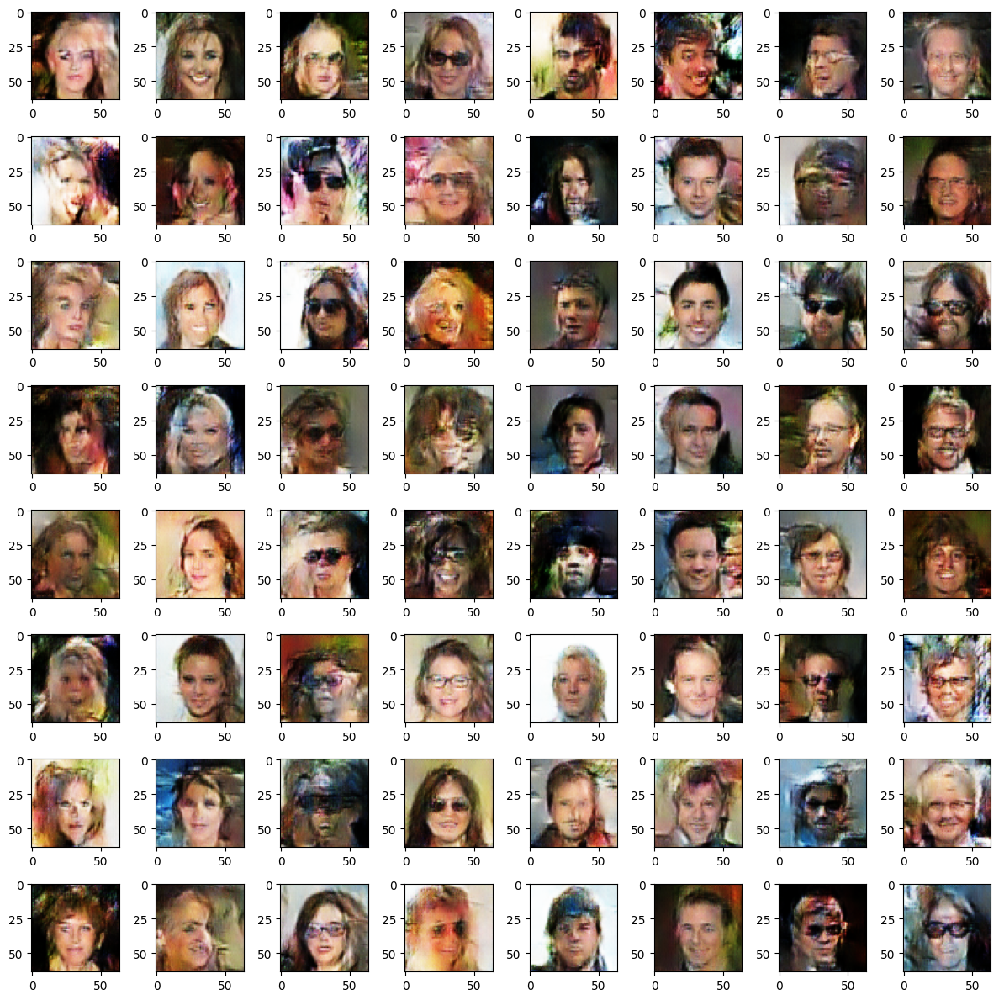


epoch 163/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5756 | g_loss: 1.5001 | val_attr_acc: 0.9374

epoch 164/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5763 | g_loss: 1.4950 | val_attr_acc: 0.9374

epoch 165/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5732 | g_loss: 1.5003 | val_attr_acc: 0.9270

epoch 166/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5730 | g_loss: 1.5076 | val_attr_acc: 0.9332

epoch 167/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5751 | g_loss: 1.4957 | val_attr_acc: 0.9387

epoch 168/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5739 | g_loss: 1.5007 | val_attr_acc: 0.9309

epoch 169/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5715 | g_loss: 1.5112 | val_attr_acc: 0.9371

epoch 170/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5761 | g_loss: 1.5047 | val_attr_acc: 0.9335

epoch 171/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5759 | g_loss: 1.4959 | val_attr_acc: 0.9374

epoch 172/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5785 | g_loss: 1.4951 | val_attr_acc: 0.9257

epoch 173/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5788 | g_loss: 1.4932 | val_attr_acc: 0.9316

epoch 174/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5780 | g_loss: 1.4894 | val_attr_acc: 0.9287

epoch 175/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5817 | g_loss: 1.4861 | val_attr_acc: 0.9303

epoch 176/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5758 | g_loss: 1.5026 | val_attr_acc: 0.9277

epoch 177/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9358
d_loss: 0.5778 | g_loss: 1.5007 | val_attr_acc: 0.9403

epoch 178/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5813 | g_loss: 1.4925 | val_attr_acc: 0.9339

epoch 179/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5733 | g_loss: 1.4988 | val_attr_acc: 0.9364

epoch 180/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5772 | g_loss: 1.4963 | val_attr_acc: 0.9313

epoch 181/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5749 | g_loss: 1.4957 | val_attr_acc: 0.9238

epoch 182/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5789 | g_loss: 1.4904 | val_attr_acc: 0.9306

epoch 183/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5735 | g_loss: 1.5019 | val_attr_acc: 0.9348

epoch 184/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5804 | g_loss: 1.4978 | val_attr_acc: 0.9339

epoch 185/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9339
d_loss: 0.5782 | g_loss: 1.4918 | val_attr_acc: 0.9377

epoch 186/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5751 | g_loss: 1.4980 | val_attr_acc: 0.9387

epoch 187/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5725 | g_loss: 1.5019 | val_attr_acc: 0.9287

epoch 188/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5754 | g_loss: 1.4933 | val_attr_acc: 0.9309

epoch 189/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5764 | g_loss: 1.4894 | val_attr_acc: 0.9394

epoch 190/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5758 | g_loss: 1.4936 | val_attr_acc: 0.9400

epoch 191/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5814 | g_loss: 1.4938 | val_attr_acc: 0.9381

epoch 192/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5825 | g_loss: 1.4827 | val_attr_acc: 0.9332

epoch 193/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5724 | g_loss: 1.5055 | val_attr_acc: 0.9306

epoch 194/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5764 | g_loss: 1.5022 | val_attr_acc: 0.9374

epoch 195/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5810 | g_loss: 1.4967 | val_attr_acc: 0.9403

epoch 196/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5698 | g_loss: 1.5026 | val_attr_acc: 0.9313

epoch 197/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5775 | g_loss: 1.5001 | val_attr_acc: 0.9313

epoch 198/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5786 | g_loss: 1.4941 | val_attr_acc: 0.9306

epoch 199/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5760 | g_loss: 1.4976 | val_attr_acc: 0.9368

epoch 200/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5787 | g_loss: 1.5023 | val_attr_acc: 0.9407

epoch 201/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9361
d_loss: 0.5738 | g_loss: 1.5057 | val_attr_acc: 0.9326

epoch 202/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5769 | g_loss: 1.5050 | val_attr_acc: 0.9351

epoch 203/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5757 | g_loss: 1.4894 | val_attr_acc: 0.9381

epoch 204/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5705 | g_loss: 1.5080 | val_attr_acc: 0.9319

epoch 205/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9361
d_loss: 0.5771 | g_loss: 1.4910 | val_attr_acc: 0.9436

epoch 206/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5717 | g_loss: 1.5047 | val_attr_acc: 0.9342

epoch 207/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5762 | g_loss: 1.4967 | val_attr_acc: 0.9433

epoch 208/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5753 | g_loss: 1.4912 | val_attr_acc: 0.9358

epoch 209/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5798 | g_loss: 1.5013 | val_attr_acc: 0.9403

epoch 210/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5790 | g_loss: 1.4942 | val_attr_acc: 0.9433

epoch 211/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9339
d_loss: 0.5775 | g_loss: 1.5028 | val_attr_acc: 0.9335

epoch 212/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5741 | g_loss: 1.5012 | val_attr_acc: 0.9384

epoch 213/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5771 | g_loss: 1.4930 | val_attr_acc: 0.9322

epoch 214/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5801 | g_loss: 1.4793 | val_attr_acc: 0.9361

epoch 215/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5765 | g_loss: 1.4873 | val_attr_acc: 0.9436

epoch 216/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5753 | g_loss: 1.5097 | val_attr_acc: 0.9381

epoch 217/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5767 | g_loss: 1.5036 | val_attr_acc: 0.9400

epoch 218/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5758 | g_loss: 1.4960 | val_attr_acc: 0.9313

epoch 219/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9359
d_loss: 0.5737 | g_loss: 1.4915 | val_attr_acc: 0.9309

epoch 220/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5762 | g_loss: 1.4990 | val_attr_acc: 0.9332

epoch 221/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5734 | g_loss: 1.4990 | val_attr_acc: 0.9390

epoch 222/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5817 | g_loss: 1.4911 | val_attr_acc: 0.9410

epoch 223/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5751 | g_loss: 1.5017 | val_attr_acc: 0.9400

epoch 224/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5796 | g_loss: 1.4956 | val_attr_acc: 0.9326

epoch 225/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
new best val_acc: 0.9468
d_loss: 0.5791 | g_loss: 1.4967 | val_attr_acc: 0.9468

epoch 226/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5719 | g_loss: 1.5064 | val_attr_acc: 0.9420

epoch 227/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5766 | g_loss: 1.4954 | val_attr_acc: 0.9374

epoch 228/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5740 | g_loss: 1.5054 | val_attr_acc: 0.9316

epoch 229/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5812 | g_loss: 1.4901 | val_attr_acc: 0.9387

epoch 230/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5729 | g_loss: 1.5127 | val_attr_acc: 0.9293

epoch 231/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5787 | g_loss: 1.5027 | val_attr_acc: 0.9407

epoch 232/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9335
d_loss: 0.5803 | g_loss: 1.5001 | val_attr_acc: 0.9296

epoch 233/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5772 | g_loss: 1.4982 | val_attr_acc: 0.9394

epoch 234/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5749 | g_loss: 1.4994 | val_attr_acc: 0.9332

epoch 235/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5781 | g_loss: 1.5037 | val_attr_acc: 0.9348

epoch 236/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5796 | g_loss: 1.4969 | val_attr_acc: 0.9368

epoch 237/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5803 | g_loss: 1.4873 | val_attr_acc: 0.9410

epoch 238/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5784 | g_loss: 1.4892 | val_attr_acc: 0.9274

epoch 239/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5794 | g_loss: 1.4891 | val_attr_acc: 0.9342

epoch 240/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5790 | g_loss: 1.4887 | val_attr_acc: 0.9296

epoch 241/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5800 | g_loss: 1.4882 | val_attr_acc: 0.9309

epoch 242/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5746 | g_loss: 1.5000 | val_attr_acc: 0.9339

epoch 243/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5774 | g_loss: 1.5009 | val_attr_acc: 0.9394

epoch 244/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5746 | g_loss: 1.5006 | val_attr_acc: 0.9300

epoch 245/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5878 | g_loss: 1.4809 | val_attr_acc: 0.9339

epoch 246/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5755 | g_loss: 1.5024 | val_attr_acc: 0.9358

epoch 247/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5766 | g_loss: 1.5054 | val_attr_acc: 0.9235

epoch 248/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5740 | g_loss: 1.4994 | val_attr_acc: 0.9377

epoch 249/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5820 | g_loss: 1.4921 | val_attr_acc: 0.9364

epoch 250/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5729 | g_loss: 1.5013 | val_attr_acc: 0.9351

epoch 251/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9358
d_loss: 0.5736 | g_loss: 1.5032 | val_attr_acc: 0.9394

epoch 252/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5763 | g_loss: 1.4947 | val_attr_acc: 0.9361

epoch 253/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5771 | g_loss: 1.4987 | val_attr_acc: 0.9274

epoch 254/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5777 | g_loss: 1.4973 | val_attr_acc: 0.9332

epoch 255/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5791 | g_loss: 1.4932 | val_attr_acc: 0.9329

epoch 256/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5763 | g_loss: 1.4963 | val_attr_acc: 0.9397

epoch 257/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5731 | g_loss: 1.5048 | val_attr_acc: 0.9436

epoch 258/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5779 | g_loss: 1.4907 | val_attr_acc: 0.9342

epoch 259/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5770 | g_loss: 1.5010 | val_attr_acc: 0.9306

epoch 260/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5782 | g_loss: 1.4957 | val_attr_acc: 0.9355

epoch 261/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5705 | g_loss: 1.5051 | val_attr_acc: 0.9426

epoch 262/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5773 | g_loss: 1.4991 | val_attr_acc: 0.9342

epoch 263/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5707 | g_loss: 1.5100 | val_attr_acc: 0.9332

epoch 264/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5794 | g_loss: 1.4883 | val_attr_acc: 0.9345

epoch 265/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5775 | g_loss: 1.4981 | val_attr_acc: 0.9377

epoch 266/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5761 | g_loss: 1.4931 | val_attr_acc: 0.9400

epoch 267/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5767 | g_loss: 1.4958 | val_attr_acc: 0.9332

epoch 268/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5705 | g_loss: 1.5099 | val_attr_acc: 0.9374

epoch 269/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5763 | g_loss: 1.4962 | val_attr_acc: 0.9339

epoch 270/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5701 | g_loss: 1.5124 | val_attr_acc: 0.9420

epoch 271/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5795 | g_loss: 1.4829 | val_attr_acc: 0.9309

epoch 272/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5764 | g_loss: 1.5007 | val_attr_acc: 0.9335

epoch 273/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9339
d_loss: 0.5814 | g_loss: 1.4935 | val_attr_acc: 0.9452

epoch 274/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5751 | g_loss: 1.4954 | val_attr_acc: 0.9420

epoch 275/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5776 | g_loss: 1.4928 | val_attr_acc: 0.9316

epoch 276/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5745 | g_loss: 1.5069 | val_attr_acc: 0.9358

epoch 277/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5719 | g_loss: 1.4994 | val_attr_acc: 0.9374

epoch 278/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5741 | g_loss: 1.5003 | val_attr_acc: 0.9329

epoch 279/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5737 | g_loss: 1.4956 | val_attr_acc: 0.9335

epoch 280/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5775 | g_loss: 1.5109 | val_attr_acc: 0.9403

epoch 281/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5774 | g_loss: 1.4944 | val_attr_acc: 0.9387

epoch 282/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5740 | g_loss: 1.5064 | val_attr_acc: 0.9339

epoch 283/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5714 | g_loss: 1.5022 | val_attr_acc: 0.9416

epoch 284/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5773 | g_loss: 1.4960 | val_attr_acc: 0.9355

epoch 285/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5732 | g_loss: 1.5051 | val_attr_acc: 0.9322

epoch 286/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5714 | g_loss: 1.5058 | val_attr_acc: 0.9374

epoch 287/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5729 | g_loss: 1.4988 | val_attr_acc: 0.9348

epoch 288/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9360
d_loss: 0.5743 | g_loss: 1.5081 | val_attr_acc: 0.9228

epoch 289/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5727 | g_loss: 1.5081 | val_attr_acc: 0.9355

epoch 290/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5794 | g_loss: 1.4962 | val_attr_acc: 0.9342

epoch 291/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5744 | g_loss: 1.4940 | val_attr_acc: 0.9374

epoch 292/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5779 | g_loss: 1.4981 | val_attr_acc: 0.9351

epoch 293/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5787 | g_loss: 1.4816 | val_attr_acc: 0.9371

epoch 294/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5776 | g_loss: 1.4985 | val_attr_acc: 0.9397

epoch 295/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5763 | g_loss: 1.4977 | val_attr_acc: 0.9355

epoch 296/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5727 | g_loss: 1.5134 | val_attr_acc: 0.9319

epoch 297/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5764 | g_loss: 1.4893 | val_attr_acc: 0.9420

epoch 298/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5721 | g_loss: 1.5007 | val_attr_acc: 0.9371

epoch 299/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5719 | g_loss: 1.5027 | val_attr_acc: 0.9287

epoch 300/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5752 | g_loss: 1.5014 | val_attr_acc: 0.9235

epoch 301/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5763 | g_loss: 1.4964 | val_attr_acc: 0.9394

epoch 302/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5757 | g_loss: 1.4972 | val_attr_acc: 0.9374

epoch 303/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5749 | g_loss: 1.4975 | val_attr_acc: 0.9374

epoch 304/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5770 | g_loss: 1.4947 | val_attr_acc: 0.9345

epoch 305/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5725 | g_loss: 1.4904 | val_attr_acc: 0.9358

epoch 306/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5780 | g_loss: 1.5005 | val_attr_acc: 0.9403

epoch 307/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5725 | g_loss: 1.5000 | val_attr_acc: 0.9277

epoch 308/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5797 | g_loss: 1.5017 | val_attr_acc: 0.9361

epoch 309/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5743 | g_loss: 1.4984 | val_attr_acc: 0.9413

epoch 310/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5743 | g_loss: 1.4926 | val_attr_acc: 0.9313

epoch 311/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5748 | g_loss: 1.5002 | val_attr_acc: 0.9400

epoch 312/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5754 | g_loss: 1.5040 | val_attr_acc: 0.9355

epoch 313/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5745 | g_loss: 1.5003 | val_attr_acc: 0.9410

epoch 314/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5753 | g_loss: 1.5030 | val_attr_acc: 0.9351

epoch 315/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5832 | g_loss: 1.4873 | val_attr_acc: 0.9322

epoch 316/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5766 | g_loss: 1.4967 | val_attr_acc: 0.9358

epoch 317/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5798 | g_loss: 1.4896 | val_attr_acc: 0.9348

epoch 318/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5781 | g_loss: 1.4996 | val_attr_acc: 0.9287

epoch 319/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5765 | g_loss: 1.5037 | val_attr_acc: 0.9322

epoch 320/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5718 | g_loss: 1.5064 | val_attr_acc: 0.9290

epoch 321/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5757 | g_loss: 1.4991 | val_attr_acc: 0.9374

epoch 322/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5747 | g_loss: 1.5048 | val_attr_acc: 0.9361

epoch 323/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5752 | g_loss: 1.5025 | val_attr_acc: 0.9394

epoch 324/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5848 | g_loss: 1.4796 | val_attr_acc: 0.9400


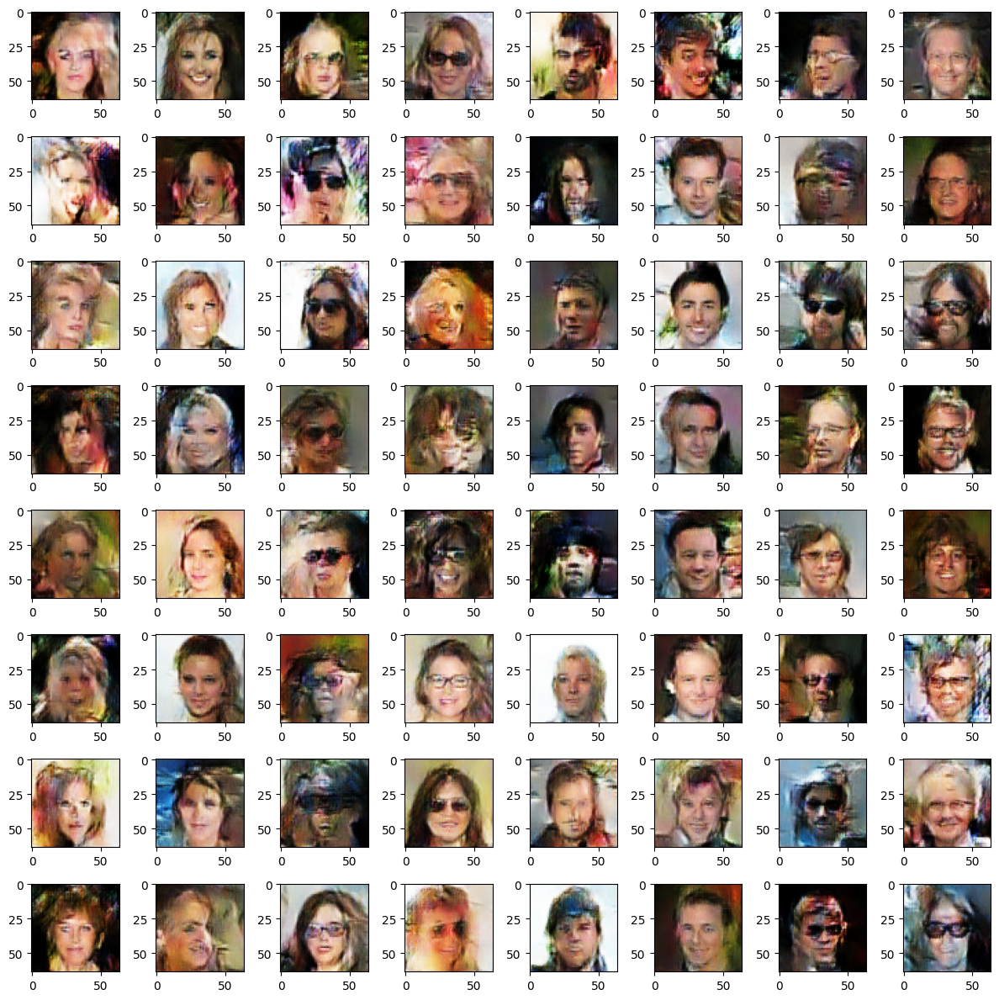


epoch 325/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5753 | g_loss: 1.4869 | val_attr_acc: 0.9287

epoch 326/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5761 | g_loss: 1.4983 | val_attr_acc: 0.9270

epoch 327/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5754 | g_loss: 1.4871 | val_attr_acc: 0.9290

epoch 328/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5756 | g_loss: 1.4954 | val_attr_acc: 0.9326

epoch 329/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5772 | g_loss: 1.4945 | val_attr_acc: 0.9335

epoch 330/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5798 | g_loss: 1.4915 | val_attr_acc: 0.9293

epoch 331/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5791 | g_loss: 1.4919 | val_attr_acc: 0.9355

epoch 332/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5749 | g_loss: 1.4960 | val_attr_acc: 0.9377

epoch 333/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5774 | g_loss: 1.5014 | val_attr_acc: 0.9345

epoch 334/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5797 | g_loss: 1.5001 | val_attr_acc: 0.9348

epoch 335/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5772 | g_loss: 1.4963 | val_attr_acc: 0.9348

epoch 336/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5763 | g_loss: 1.4993 | val_attr_acc: 0.9283

epoch 337/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5798 | g_loss: 1.4957 | val_attr_acc: 0.9420

epoch 338/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5795 | g_loss: 1.4942 | val_attr_acc: 0.9277

epoch 339/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5746 | g_loss: 1.4981 | val_attr_acc: 0.9313

epoch 340/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5731 | g_loss: 1.4995 | val_attr_acc: 0.9394

epoch 341/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9356
d_loss: 0.5783 | g_loss: 1.4908 | val_attr_acc: 0.9387

epoch 342/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5753 | g_loss: 1.5006 | val_attr_acc: 0.9364

epoch 343/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5730 | g_loss: 1.5020 | val_attr_acc: 0.9306

epoch 344/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5748 | g_loss: 1.5008 | val_attr_acc: 0.9384

epoch 345/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5718 | g_loss: 1.5070 | val_attr_acc: 0.9290

epoch 346/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5719 | g_loss: 1.5116 | val_attr_acc: 0.9433

epoch 347/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5731 | g_loss: 1.4971 | val_attr_acc: 0.9420

epoch 348/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5745 | g_loss: 1.5016 | val_attr_acc: 0.9364

epoch 349/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5814 | g_loss: 1.4892 | val_attr_acc: 0.9364

epoch 350/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5767 | g_loss: 1.4927 | val_attr_acc: 0.9267

epoch 351/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5785 | g_loss: 1.4916 | val_attr_acc: 0.9326

epoch 352/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5763 | g_loss: 1.4950 | val_attr_acc: 0.9326

epoch 353/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5796 | g_loss: 1.4862 | val_attr_acc: 0.9332

epoch 354/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5728 | g_loss: 1.5009 | val_attr_acc: 0.9377

epoch 355/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5750 | g_loss: 1.4966 | val_attr_acc: 0.9306

epoch 356/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5714 | g_loss: 1.4926 | val_attr_acc: 0.9361

epoch 357/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5750 | g_loss: 1.5017 | val_attr_acc: 0.9355

epoch 358/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5753 | g_loss: 1.4932 | val_attr_acc: 0.9313

epoch 359/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5766 | g_loss: 1.5006 | val_attr_acc: 0.9309

epoch 360/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5774 | g_loss: 1.4868 | val_attr_acc: 0.9416

epoch 361/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5719 | g_loss: 1.5013 | val_attr_acc: 0.9345

epoch 362/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5743 | g_loss: 1.4991 | val_attr_acc: 0.9364

epoch 363/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5756 | g_loss: 1.4968 | val_attr_acc: 0.9345

epoch 364/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5766 | g_loss: 1.5005 | val_attr_acc: 0.9403

epoch 365/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5803 | g_loss: 1.4889 | val_attr_acc: 0.9277

epoch 366/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5779 | g_loss: 1.5041 | val_attr_acc: 0.9400

epoch 367/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5706 | g_loss: 1.5099 | val_attr_acc: 0.9316

epoch 368/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5829 | g_loss: 1.4901 | val_attr_acc: 0.9313

epoch 369/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5774 | g_loss: 1.4933 | val_attr_acc: 0.9345

epoch 370/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5777 | g_loss: 1.4999 | val_attr_acc: 0.9374

epoch 371/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5812 | g_loss: 1.4947 | val_attr_acc: 0.9322

epoch 372/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5789 | g_loss: 1.4897 | val_attr_acc: 0.9326

epoch 373/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5804 | g_loss: 1.4932 | val_attr_acc: 0.9316

epoch 374/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5762 | g_loss: 1.4989 | val_attr_acc: 0.9351

epoch 375/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5831 | g_loss: 1.4869 | val_attr_acc: 0.9355

epoch 376/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5767 | g_loss: 1.4990 | val_attr_acc: 0.9296

epoch 377/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5764 | g_loss: 1.5006 | val_attr_acc: 0.9355

epoch 378/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5759 | g_loss: 1.5020 | val_attr_acc: 0.9293

epoch 379/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5735 | g_loss: 1.5071 | val_attr_acc: 0.9358

epoch 380/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5755 | g_loss: 1.4980 | val_attr_acc: 0.9407

epoch 381/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9356
d_loss: 0.5798 | g_loss: 1.4908 | val_attr_acc: 0.9364

epoch 382/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5793 | g_loss: 1.5002 | val_attr_acc: 0.9394

epoch 383/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5760 | g_loss: 1.4944 | val_attr_acc: 0.9345

epoch 384/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5750 | g_loss: 1.5047 | val_attr_acc: 0.9335

epoch 385/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5733 | g_loss: 1.5123 | val_attr_acc: 0.9306

epoch 386/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5757 | g_loss: 1.5100 | val_attr_acc: 0.9313

epoch 387/1620 - lr: 0.001000


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
reduced lr to 0.000500
d_loss: 0.5827 | g_loss: 1.4900 | val_attr_acc: 0.9342

epoch 388/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5727 | g_loss: 1.5011 | val_attr_acc: 0.9339

epoch 389/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5757 | g_loss: 1.4993 | val_attr_acc: 0.9381

epoch 390/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5804 | g_loss: 1.4934 | val_attr_acc: 0.9332

epoch 391/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5781 | g_loss: 1.4956 | val_attr_acc: 0.9420

epoch 392/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5715 | g_loss: 1.5042 | val_attr_acc: 0.9335

epoch 393/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5827 | g_loss: 1.4984 | val_attr_acc: 0.9342

epoch 394/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5778 | g_loss: 1.4925 | val_attr_acc: 0.9371

epoch 395/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5795 | g_loss: 1.4881 | val_attr_acc: 0.9313

epoch 396/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5722 | g_loss: 1.5061 | val_attr_acc: 0.9306

epoch 397/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5736 | g_loss: 1.5029 | val_attr_acc: 0.9261

epoch 398/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5796 | g_loss: 1.4970 | val_attr_acc: 0.9322

epoch 399/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5801 | g_loss: 1.4967 | val_attr_acc: 0.9342

epoch 400/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5800 | g_loss: 1.4951 | val_attr_acc: 0.9254

epoch 401/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5760 | g_loss: 1.5038 | val_attr_acc: 0.9394

epoch 402/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5800 | g_loss: 1.4957 | val_attr_acc: 0.9332

epoch 403/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5768 | g_loss: 1.5003 | val_attr_acc: 0.9377

epoch 404/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5786 | g_loss: 1.4924 | val_attr_acc: 0.9332

epoch 405/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9356
d_loss: 0.5748 | g_loss: 1.4984 | val_attr_acc: 0.9377

epoch 406/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9359
d_loss: 0.5742 | g_loss: 1.5050 | val_attr_acc: 0.9423

epoch 407/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5712 | g_loss: 1.4969 | val_attr_acc: 0.9423

epoch 408/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9338
d_loss: 0.5729 | g_loss: 1.5084 | val_attr_acc: 0.9335

epoch 409/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5769 | g_loss: 1.5024 | val_attr_acc: 0.9277

epoch 410/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5719 | g_loss: 1.5069 | val_attr_acc: 0.9423

epoch 411/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5761 | g_loss: 1.4980 | val_attr_acc: 0.9377

epoch 412/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5755 | g_loss: 1.5069 | val_attr_acc: 0.9300

epoch 413/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5764 | g_loss: 1.5004 | val_attr_acc: 0.9303

epoch 414/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5781 | g_loss: 1.4837 | val_attr_acc: 0.9351

epoch 415/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5734 | g_loss: 1.4991 | val_attr_acc: 0.9368

epoch 416/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5735 | g_loss: 1.5057 | val_attr_acc: 0.9348

epoch 417/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5837 | g_loss: 1.4905 | val_attr_acc: 0.9371

epoch 418/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5762 | g_loss: 1.4975 | val_attr_acc: 0.9400

epoch 419/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5700 | g_loss: 1.4984 | val_attr_acc: 0.9377

epoch 420/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5754 | g_loss: 1.4986 | val_attr_acc: 0.9345

epoch 421/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5724 | g_loss: 1.5066 | val_attr_acc: 0.9410

epoch 422/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5738 | g_loss: 1.4896 | val_attr_acc: 0.9381

epoch 423/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5770 | g_loss: 1.4950 | val_attr_acc: 0.9254

epoch 424/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5777 | g_loss: 1.5019 | val_attr_acc: 0.9316

epoch 425/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9361
d_loss: 0.5836 | g_loss: 1.4924 | val_attr_acc: 0.9283

epoch 426/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5758 | g_loss: 1.4981 | val_attr_acc: 0.9303

epoch 427/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5796 | g_loss: 1.5001 | val_attr_acc: 0.9303

epoch 428/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5796 | g_loss: 1.4914 | val_attr_acc: 0.9313

epoch 429/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5716 | g_loss: 1.4993 | val_attr_acc: 0.9384

epoch 430/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5782 | g_loss: 1.4983 | val_attr_acc: 0.9364

epoch 431/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5726 | g_loss: 1.4999 | val_attr_acc: 0.9355

epoch 432/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5757 | g_loss: 1.4965 | val_attr_acc: 0.9368

epoch 433/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5778 | g_loss: 1.4956 | val_attr_acc: 0.9436

epoch 434/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5710 | g_loss: 1.5037 | val_attr_acc: 0.9374

epoch 435/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5743 | g_loss: 1.5002 | val_attr_acc: 0.9329

epoch 436/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5704 | g_loss: 1.5122 | val_attr_acc: 0.9329

epoch 437/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5731 | g_loss: 1.4935 | val_attr_acc: 0.9339

epoch 438/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9358
d_loss: 0.5720 | g_loss: 1.5054 | val_attr_acc: 0.9439

epoch 439/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5722 | g_loss: 1.5033 | val_attr_acc: 0.9274

epoch 440/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5787 | g_loss: 1.4934 | val_attr_acc: 0.9371

epoch 441/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5789 | g_loss: 1.5032 | val_attr_acc: 0.9248

epoch 442/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5787 | g_loss: 1.4972 | val_attr_acc: 0.9407

epoch 443/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9358
d_loss: 0.5754 | g_loss: 1.4952 | val_attr_acc: 0.9381

epoch 444/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5762 | g_loss: 1.5036 | val_attr_acc: 0.9313

epoch 445/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5735 | g_loss: 1.4995 | val_attr_acc: 0.9364

epoch 446/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5773 | g_loss: 1.4992 | val_attr_acc: 0.9381

epoch 447/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5769 | g_loss: 1.4960 | val_attr_acc: 0.9287

epoch 448/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5750 | g_loss: 1.5027 | val_attr_acc: 0.9442

epoch 449/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5807 | g_loss: 1.4933 | val_attr_acc: 0.9368

epoch 450/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5783 | g_loss: 1.4910 | val_attr_acc: 0.9342

epoch 451/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5738 | g_loss: 1.5049 | val_attr_acc: 0.9339

epoch 452/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5760 | g_loss: 1.4940 | val_attr_acc: 0.9368

epoch 453/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5753 | g_loss: 1.4867 | val_attr_acc: 0.9364

epoch 454/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5759 | g_loss: 1.4989 | val_attr_acc: 0.9335

epoch 455/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5756 | g_loss: 1.5036 | val_attr_acc: 0.9277

epoch 456/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5762 | g_loss: 1.4974 | val_attr_acc: 0.9394

epoch 457/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5759 | g_loss: 1.5020 | val_attr_acc: 0.9452

epoch 458/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5752 | g_loss: 1.5005 | val_attr_acc: 0.9345

epoch 459/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5710 | g_loss: 1.5060 | val_attr_acc: 0.9300

epoch 460/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5773 | g_loss: 1.4932 | val_attr_acc: 0.9387

epoch 461/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5752 | g_loss: 1.4931 | val_attr_acc: 0.9348

epoch 462/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5791 | g_loss: 1.4977 | val_attr_acc: 0.9364

epoch 463/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5782 | g_loss: 1.4939 | val_attr_acc: 0.9397

epoch 464/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5792 | g_loss: 1.4939 | val_attr_acc: 0.9342

epoch 465/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9356
d_loss: 0.5752 | g_loss: 1.4952 | val_attr_acc: 0.9313

epoch 466/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5710 | g_loss: 1.5029 | val_attr_acc: 0.9306

epoch 467/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5771 | g_loss: 1.4935 | val_attr_acc: 0.9300

epoch 468/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5757 | g_loss: 1.5025 | val_attr_acc: 0.9374

epoch 469/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5834 | g_loss: 1.4861 | val_attr_acc: 0.9309

epoch 470/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5744 | g_loss: 1.5092 | val_attr_acc: 0.9300

epoch 471/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5768 | g_loss: 1.4972 | val_attr_acc: 0.9361

epoch 472/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5761 | g_loss: 1.4983 | val_attr_acc: 0.9300

epoch 473/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5728 | g_loss: 1.5004 | val_attr_acc: 0.9387

epoch 474/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5733 | g_loss: 1.5046 | val_attr_acc: 0.9306

epoch 475/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5740 | g_loss: 1.4945 | val_attr_acc: 0.9390

epoch 476/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5735 | g_loss: 1.5013 | val_attr_acc: 0.9361

epoch 477/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5770 | g_loss: 1.4979 | val_attr_acc: 0.9361

epoch 478/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5775 | g_loss: 1.5008 | val_attr_acc: 0.9316

epoch 479/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5744 | g_loss: 1.5029 | val_attr_acc: 0.9351

epoch 480/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5760 | g_loss: 1.5051 | val_attr_acc: 0.9351

epoch 481/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5778 | g_loss: 1.4872 | val_attr_acc: 0.9387

epoch 482/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9339
d_loss: 0.5772 | g_loss: 1.4933 | val_attr_acc: 0.9339

epoch 483/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5747 | g_loss: 1.4960 | val_attr_acc: 0.9228

epoch 484/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5765 | g_loss: 1.5105 | val_attr_acc: 0.9309

epoch 485/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5778 | g_loss: 1.5046 | val_attr_acc: 0.9371

epoch 486/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5804 | g_loss: 1.5070 | val_attr_acc: 0.9371


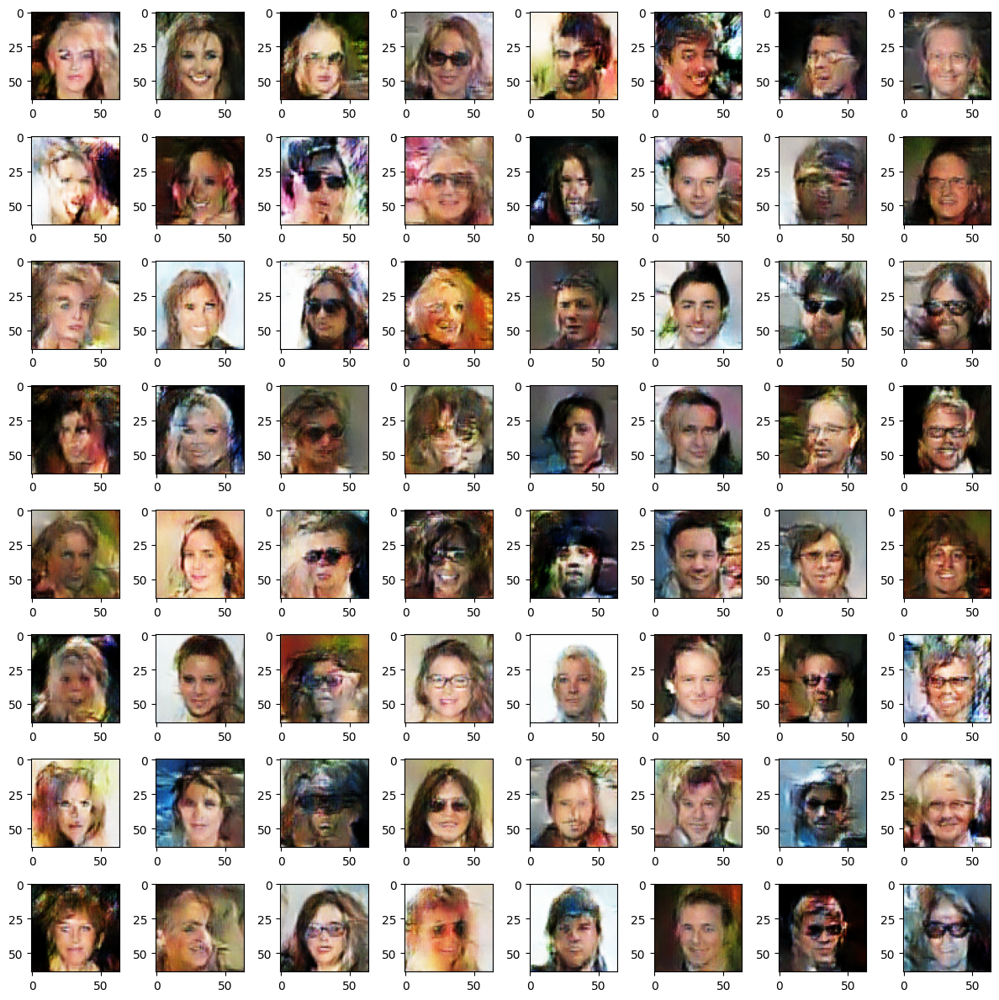


epoch 487/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5809 | g_loss: 1.4936 | val_attr_acc: 0.9358

epoch 488/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5766 | g_loss: 1.4870 | val_attr_acc: 0.9332

epoch 489/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5804 | g_loss: 1.4973 | val_attr_acc: 0.9342

epoch 490/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5793 | g_loss: 1.4940 | val_attr_acc: 0.9394

epoch 491/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5743 | g_loss: 1.5031 | val_attr_acc: 0.9319

epoch 492/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5743 | g_loss: 1.4978 | val_attr_acc: 0.9274

epoch 493/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5808 | g_loss: 1.5014 | val_attr_acc: 0.9387

epoch 494/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5753 | g_loss: 1.5019 | val_attr_acc: 0.9332

epoch 495/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5747 | g_loss: 1.5018 | val_attr_acc: 0.9371

epoch 496/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5761 | g_loss: 1.4904 | val_attr_acc: 0.9390

epoch 497/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9339
d_loss: 0.5789 | g_loss: 1.4999 | val_attr_acc: 0.9394

epoch 498/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9336
d_loss: 0.5789 | g_loss: 1.4865 | val_attr_acc: 0.9394

epoch 499/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5737 | g_loss: 1.5023 | val_attr_acc: 0.9322

epoch 500/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5778 | g_loss: 1.4961 | val_attr_acc: 0.9309

epoch 501/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5763 | g_loss: 1.5092 | val_attr_acc: 0.9351

epoch 502/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5668 | g_loss: 1.5106 | val_attr_acc: 0.9257

epoch 503/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5746 | g_loss: 1.4929 | val_attr_acc: 0.9339

epoch 504/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5770 | g_loss: 1.5047 | val_attr_acc: 0.9403

epoch 505/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5755 | g_loss: 1.5033 | val_attr_acc: 0.9332

epoch 506/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5773 | g_loss: 1.4944 | val_attr_acc: 0.9309

epoch 507/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5726 | g_loss: 1.5029 | val_attr_acc: 0.9368

epoch 508/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5787 | g_loss: 1.5005 | val_attr_acc: 0.9371

epoch 509/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5741 | g_loss: 1.5086 | val_attr_acc: 0.9345

epoch 510/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5788 | g_loss: 1.4963 | val_attr_acc: 0.9290

epoch 511/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5776 | g_loss: 1.4945 | val_attr_acc: 0.9316

epoch 512/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5762 | g_loss: 1.5039 | val_attr_acc: 0.9345

epoch 513/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5787 | g_loss: 1.4984 | val_attr_acc: 0.9374

epoch 514/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5776 | g_loss: 1.4931 | val_attr_acc: 0.9377

epoch 515/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5802 | g_loss: 1.4911 | val_attr_acc: 0.9342

epoch 516/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5776 | g_loss: 1.4965 | val_attr_acc: 0.9361

epoch 517/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5767 | g_loss: 1.4906 | val_attr_acc: 0.9403

epoch 518/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5751 | g_loss: 1.4998 | val_attr_acc: 0.9313

epoch 519/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9358
d_loss: 0.5744 | g_loss: 1.5001 | val_attr_acc: 0.9348

epoch 520/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5760 | g_loss: 1.5011 | val_attr_acc: 0.9355

epoch 521/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5776 | g_loss: 1.5000 | val_attr_acc: 0.9345

epoch 522/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5825 | g_loss: 1.4936 | val_attr_acc: 0.9387

epoch 523/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5796 | g_loss: 1.4903 | val_attr_acc: 0.9329

epoch 524/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5756 | g_loss: 1.4960 | val_attr_acc: 0.9313

epoch 525/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5762 | g_loss: 1.5033 | val_attr_acc: 0.9270

epoch 526/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5741 | g_loss: 1.5051 | val_attr_acc: 0.9326

epoch 527/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5745 | g_loss: 1.4961 | val_attr_acc: 0.9303

epoch 528/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5814 | g_loss: 1.4903 | val_attr_acc: 0.9371

epoch 529/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5730 | g_loss: 1.4997 | val_attr_acc: 0.9423

epoch 530/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5797 | g_loss: 1.4984 | val_attr_acc: 0.9267

epoch 531/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9358
d_loss: 0.5793 | g_loss: 1.4924 | val_attr_acc: 0.9339

epoch 532/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5783 | g_loss: 1.4940 | val_attr_acc: 0.9306

epoch 533/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5800 | g_loss: 1.4821 | val_attr_acc: 0.9423

epoch 534/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9362
d_loss: 0.5745 | g_loss: 1.5008 | val_attr_acc: 0.9371

epoch 535/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5717 | g_loss: 1.4954 | val_attr_acc: 0.9351

epoch 536/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5740 | g_loss: 1.5100 | val_attr_acc: 0.9377

epoch 537/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5807 | g_loss: 1.4899 | val_attr_acc: 0.9374

epoch 538/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5798 | g_loss: 1.4882 | val_attr_acc: 0.9397

epoch 539/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5750 | g_loss: 1.4999 | val_attr_acc: 0.9371

epoch 540/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5780 | g_loss: 1.5007 | val_attr_acc: 0.9342

epoch 541/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5760 | g_loss: 1.4951 | val_attr_acc: 0.9326

epoch 542/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5753 | g_loss: 1.5011 | val_attr_acc: 0.9387

epoch 543/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5811 | g_loss: 1.4851 | val_attr_acc: 0.9290

epoch 544/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5820 | g_loss: 1.4871 | val_attr_acc: 0.9374

epoch 545/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5768 | g_loss: 1.4955 | val_attr_acc: 0.9342

epoch 546/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5763 | g_loss: 1.5043 | val_attr_acc: 0.9413

epoch 547/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5798 | g_loss: 1.4984 | val_attr_acc: 0.9267

epoch 548/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5751 | g_loss: 1.5047 | val_attr_acc: 0.9264

epoch 549/1620 - lr: 0.000500


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
reduced lr to 0.000250
d_loss: 0.5742 | g_loss: 1.5079 | val_attr_acc: 0.9319

epoch 550/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5764 | g_loss: 1.4988 | val_attr_acc: 0.9316

epoch 551/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5796 | g_loss: 1.4901 | val_attr_acc: 0.9413

epoch 552/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5787 | g_loss: 1.5003 | val_attr_acc: 0.9368

epoch 553/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5790 | g_loss: 1.4955 | val_attr_acc: 0.9332

epoch 554/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5753 | g_loss: 1.4989 | val_attr_acc: 0.9368

epoch 555/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5713 | g_loss: 1.5147 | val_attr_acc: 0.9313

epoch 556/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5739 | g_loss: 1.5037 | val_attr_acc: 0.9270

epoch 557/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5728 | g_loss: 1.5081 | val_attr_acc: 0.9290

epoch 558/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5744 | g_loss: 1.4956 | val_attr_acc: 0.9368

epoch 559/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5775 | g_loss: 1.4936 | val_attr_acc: 0.9280

epoch 560/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5783 | g_loss: 1.4909 | val_attr_acc: 0.9345

epoch 561/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5738 | g_loss: 1.5033 | val_attr_acc: 0.9358

epoch 562/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5789 | g_loss: 1.5062 | val_attr_acc: 0.9326

epoch 563/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5797 | g_loss: 1.4913 | val_attr_acc: 0.9287

epoch 564/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5788 | g_loss: 1.4905 | val_attr_acc: 0.9368

epoch 565/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5771 | g_loss: 1.4953 | val_attr_acc: 0.9322

epoch 566/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5729 | g_loss: 1.5063 | val_attr_acc: 0.9348

epoch 567/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5788 | g_loss: 1.4981 | val_attr_acc: 0.9355

epoch 568/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5741 | g_loss: 1.4984 | val_attr_acc: 0.9254

epoch 569/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5777 | g_loss: 1.4914 | val_attr_acc: 0.9329

epoch 570/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5774 | g_loss: 1.4970 | val_attr_acc: 0.9371

epoch 571/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5769 | g_loss: 1.4988 | val_attr_acc: 0.9326

epoch 572/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5773 | g_loss: 1.4979 | val_attr_acc: 0.9361

epoch 573/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5761 | g_loss: 1.4996 | val_attr_acc: 0.9410

epoch 574/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5831 | g_loss: 1.4873 | val_attr_acc: 0.9348

epoch 575/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9359
d_loss: 0.5766 | g_loss: 1.4979 | val_attr_acc: 0.9335

epoch 576/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5751 | g_loss: 1.5014 | val_attr_acc: 0.9280

epoch 577/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5859 | g_loss: 1.4812 | val_attr_acc: 0.9283

epoch 578/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5762 | g_loss: 1.4996 | val_attr_acc: 0.9355

epoch 579/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5741 | g_loss: 1.4958 | val_attr_acc: 0.9345

epoch 580/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5743 | g_loss: 1.4993 | val_attr_acc: 0.9355

epoch 581/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5757 | g_loss: 1.4991 | val_attr_acc: 0.9339

epoch 582/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5758 | g_loss: 1.5046 | val_attr_acc: 0.9355

epoch 583/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5720 | g_loss: 1.5006 | val_attr_acc: 0.9329

epoch 584/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5759 | g_loss: 1.5006 | val_attr_acc: 0.9355

epoch 585/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5762 | g_loss: 1.4969 | val_attr_acc: 0.9358

epoch 586/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5781 | g_loss: 1.4993 | val_attr_acc: 0.9342

epoch 587/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5772 | g_loss: 1.5015 | val_attr_acc: 0.9335

epoch 588/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5742 | g_loss: 1.5019 | val_attr_acc: 0.9306

epoch 589/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5730 | g_loss: 1.5033 | val_attr_acc: 0.9384

epoch 590/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5770 | g_loss: 1.4959 | val_attr_acc: 0.9303

epoch 591/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5706 | g_loss: 1.4979 | val_attr_acc: 0.9342

epoch 592/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5741 | g_loss: 1.4964 | val_attr_acc: 0.9410

epoch 593/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5764 | g_loss: 1.4970 | val_attr_acc: 0.9361

epoch 594/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5754 | g_loss: 1.4968 | val_attr_acc: 0.9348

epoch 595/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5779 | g_loss: 1.4871 | val_attr_acc: 0.9377

epoch 596/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5768 | g_loss: 1.4971 | val_attr_acc: 0.9413

epoch 597/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5756 | g_loss: 1.5043 | val_attr_acc: 0.9342

epoch 598/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5728 | g_loss: 1.4988 | val_attr_acc: 0.9374

epoch 599/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5732 | g_loss: 1.4987 | val_attr_acc: 0.9361

epoch 600/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5785 | g_loss: 1.4950 | val_attr_acc: 0.9316

epoch 601/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5719 | g_loss: 1.5079 | val_attr_acc: 0.9332

epoch 602/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5707 | g_loss: 1.5091 | val_attr_acc: 0.9326

epoch 603/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5774 | g_loss: 1.5028 | val_attr_acc: 0.9277

epoch 604/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5783 | g_loss: 1.4930 | val_attr_acc: 0.9277

epoch 605/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5749 | g_loss: 1.5080 | val_attr_acc: 0.9403

epoch 606/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5751 | g_loss: 1.5067 | val_attr_acc: 0.9374

epoch 607/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5757 | g_loss: 1.5093 | val_attr_acc: 0.9348

epoch 608/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5780 | g_loss: 1.4881 | val_attr_acc: 0.9326

epoch 609/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5793 | g_loss: 1.4887 | val_attr_acc: 0.9364

epoch 610/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5757 | g_loss: 1.4965 | val_attr_acc: 0.9287

epoch 611/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5802 | g_loss: 1.4929 | val_attr_acc: 0.9329

epoch 612/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5783 | g_loss: 1.4909 | val_attr_acc: 0.9361

epoch 613/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5747 | g_loss: 1.5058 | val_attr_acc: 0.9332

epoch 614/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5729 | g_loss: 1.4961 | val_attr_acc: 0.9329

epoch 615/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5791 | g_loss: 1.4946 | val_attr_acc: 0.9351

epoch 616/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5755 | g_loss: 1.5000 | val_attr_acc: 0.9394

epoch 617/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5777 | g_loss: 1.4918 | val_attr_acc: 0.9257

epoch 618/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5718 | g_loss: 1.5012 | val_attr_acc: 0.9316

epoch 619/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9360
d_loss: 0.5779 | g_loss: 1.4979 | val_attr_acc: 0.9364

epoch 620/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5741 | g_loss: 1.5016 | val_attr_acc: 0.9351

epoch 621/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5787 | g_loss: 1.4832 | val_attr_acc: 0.9332

epoch 622/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5796 | g_loss: 1.4906 | val_attr_acc: 0.9403

epoch 623/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5772 | g_loss: 1.5052 | val_attr_acc: 0.9351

epoch 624/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5760 | g_loss: 1.5030 | val_attr_acc: 0.9335

epoch 625/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5752 | g_loss: 1.4988 | val_attr_acc: 0.9309

epoch 626/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5749 | g_loss: 1.5069 | val_attr_acc: 0.9345

epoch 627/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5732 | g_loss: 1.4880 | val_attr_acc: 0.9267

epoch 628/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5767 | g_loss: 1.4898 | val_attr_acc: 0.9277

epoch 629/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5757 | g_loss: 1.5044 | val_attr_acc: 0.9322

epoch 630/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5776 | g_loss: 1.4967 | val_attr_acc: 0.9257

epoch 631/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5760 | g_loss: 1.4982 | val_attr_acc: 0.9306

epoch 632/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5771 | g_loss: 1.4939 | val_attr_acc: 0.9358

epoch 633/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5748 | g_loss: 1.4971 | val_attr_acc: 0.9413

epoch 634/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5744 | g_loss: 1.4982 | val_attr_acc: 0.9345

epoch 635/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5738 | g_loss: 1.5034 | val_attr_acc: 0.9300

epoch 636/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5743 | g_loss: 1.5026 | val_attr_acc: 0.9410

epoch 637/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5791 | g_loss: 1.4910 | val_attr_acc: 0.9296

epoch 638/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5751 | g_loss: 1.4995 | val_attr_acc: 0.9377

epoch 639/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5706 | g_loss: 1.5009 | val_attr_acc: 0.9381

epoch 640/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5752 | g_loss: 1.5017 | val_attr_acc: 0.9387

epoch 641/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5813 | g_loss: 1.4827 | val_attr_acc: 0.9332

epoch 642/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5793 | g_loss: 1.4908 | val_attr_acc: 0.9377

epoch 643/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5744 | g_loss: 1.5086 | val_attr_acc: 0.9368

epoch 644/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5753 | g_loss: 1.4998 | val_attr_acc: 0.9267

epoch 645/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5735 | g_loss: 1.4973 | val_attr_acc: 0.9403

epoch 646/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5723 | g_loss: 1.5028 | val_attr_acc: 0.9351

epoch 647/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5749 | g_loss: 1.4970 | val_attr_acc: 0.9351

epoch 648/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5737 | g_loss: 1.4984 | val_attr_acc: 0.9358


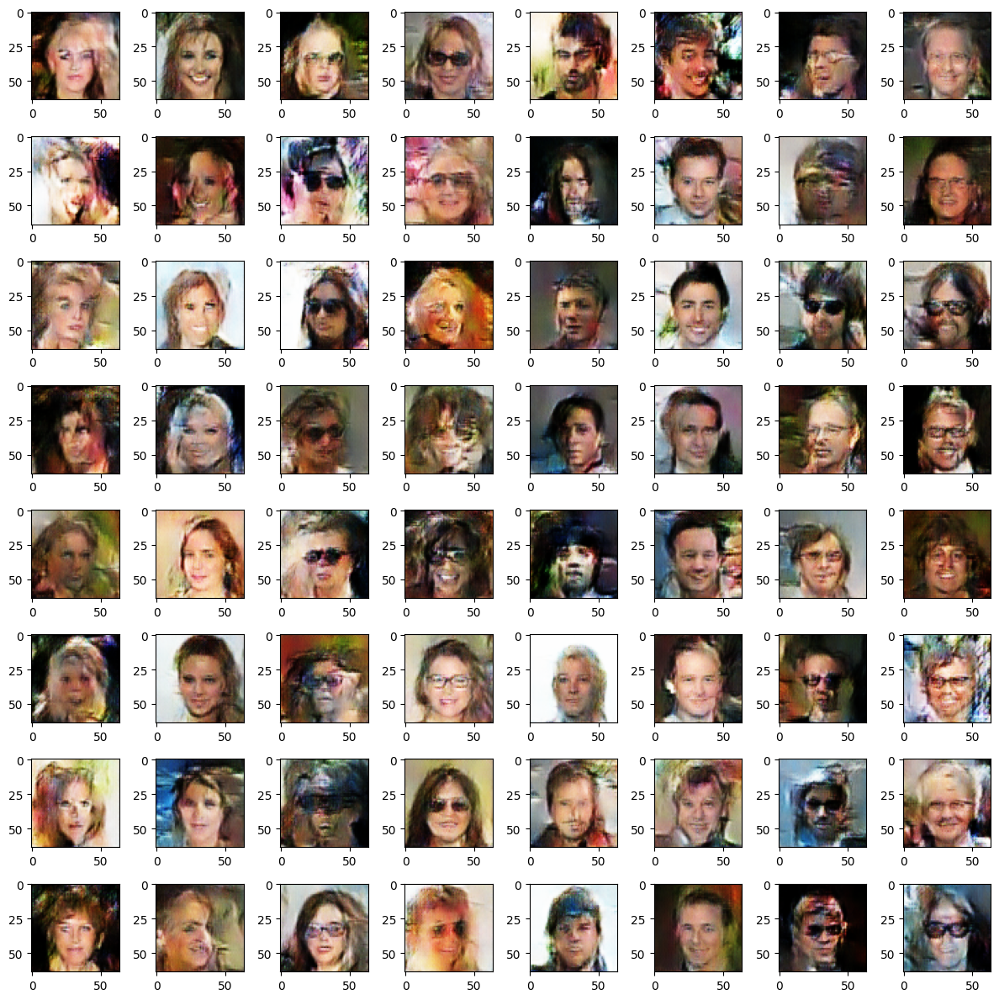


epoch 649/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5764 | g_loss: 1.4977 | val_attr_acc: 0.9329

epoch 650/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5852 | g_loss: 1.4852 | val_attr_acc: 0.9364

epoch 651/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5779 | g_loss: 1.5018 | val_attr_acc: 0.9309

epoch 652/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5790 | g_loss: 1.4924 | val_attr_acc: 0.9364

epoch 653/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5762 | g_loss: 1.4984 | val_attr_acc: 0.9296

epoch 654/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9359
d_loss: 0.5774 | g_loss: 1.4919 | val_attr_acc: 0.9332

epoch 655/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5733 | g_loss: 1.4987 | val_attr_acc: 0.9329

epoch 656/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5769 | g_loss: 1.4945 | val_attr_acc: 0.9319

epoch 657/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5753 | g_loss: 1.5051 | val_attr_acc: 0.9394

epoch 658/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5740 | g_loss: 1.4982 | val_attr_acc: 0.9326

epoch 659/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5748 | g_loss: 1.5100 | val_attr_acc: 0.9377

epoch 660/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5761 | g_loss: 1.5086 | val_attr_acc: 0.9348

epoch 661/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5729 | g_loss: 1.5028 | val_attr_acc: 0.9293

epoch 662/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5753 | g_loss: 1.4991 | val_attr_acc: 0.9390

epoch 663/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5705 | g_loss: 1.5079 | val_attr_acc: 0.9339

epoch 664/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5764 | g_loss: 1.5022 | val_attr_acc: 0.9329

epoch 665/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5783 | g_loss: 1.4987 | val_attr_acc: 0.9403

epoch 666/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5732 | g_loss: 1.5047 | val_attr_acc: 0.9283

epoch 667/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5753 | g_loss: 1.5027 | val_attr_acc: 0.9371

epoch 668/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5748 | g_loss: 1.5017 | val_attr_acc: 0.9374

epoch 669/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5801 | g_loss: 1.4916 | val_attr_acc: 0.9329

epoch 670/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5727 | g_loss: 1.5071 | val_attr_acc: 0.9384

epoch 671/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5756 | g_loss: 1.5039 | val_attr_acc: 0.9394

epoch 672/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5735 | g_loss: 1.4952 | val_attr_acc: 0.9342

epoch 673/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5780 | g_loss: 1.4985 | val_attr_acc: 0.9416

epoch 674/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5769 | g_loss: 1.4884 | val_attr_acc: 0.9329

epoch 675/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5764 | g_loss: 1.4997 | val_attr_acc: 0.9374

epoch 676/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5800 | g_loss: 1.4924 | val_attr_acc: 0.9394

epoch 677/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5780 | g_loss: 1.4956 | val_attr_acc: 0.9342

epoch 678/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5743 | g_loss: 1.5011 | val_attr_acc: 0.9358

epoch 679/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5791 | g_loss: 1.5025 | val_attr_acc: 0.9342

epoch 680/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5763 | g_loss: 1.4858 | val_attr_acc: 0.9400

epoch 681/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5743 | g_loss: 1.5112 | val_attr_acc: 0.9280

epoch 682/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5778 | g_loss: 1.4999 | val_attr_acc: 0.9280

epoch 683/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5746 | g_loss: 1.4989 | val_attr_acc: 0.9364

epoch 684/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5795 | g_loss: 1.4926 | val_attr_acc: 0.9345

epoch 685/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5833 | g_loss: 1.4926 | val_attr_acc: 0.9335

epoch 686/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5786 | g_loss: 1.4897 | val_attr_acc: 0.9332

epoch 687/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5762 | g_loss: 1.5052 | val_attr_acc: 0.9400

epoch 688/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5759 | g_loss: 1.4986 | val_attr_acc: 0.9303

epoch 689/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5777 | g_loss: 1.4991 | val_attr_acc: 0.9394

epoch 690/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5751 | g_loss: 1.4952 | val_attr_acc: 0.9235

epoch 691/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5736 | g_loss: 1.5080 | val_attr_acc: 0.9387

epoch 692/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5727 | g_loss: 1.5048 | val_attr_acc: 0.9429

epoch 693/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5722 | g_loss: 1.4974 | val_attr_acc: 0.9390

epoch 694/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5740 | g_loss: 1.5066 | val_attr_acc: 0.9319

epoch 695/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5787 | g_loss: 1.4955 | val_attr_acc: 0.9368

epoch 696/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5776 | g_loss: 1.4904 | val_attr_acc: 0.9377

epoch 697/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5725 | g_loss: 1.5078 | val_attr_acc: 0.9377

epoch 698/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5732 | g_loss: 1.5097 | val_attr_acc: 0.9355

epoch 699/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5763 | g_loss: 1.4996 | val_attr_acc: 0.9342

epoch 700/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5758 | g_loss: 1.5035 | val_attr_acc: 0.9371

epoch 701/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5819 | g_loss: 1.4939 | val_attr_acc: 0.9287

epoch 702/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5741 | g_loss: 1.5050 | val_attr_acc: 0.9322

epoch 703/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9359
d_loss: 0.5796 | g_loss: 1.4981 | val_attr_acc: 0.9339

epoch 704/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5751 | g_loss: 1.4961 | val_attr_acc: 0.9384

epoch 705/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5783 | g_loss: 1.4978 | val_attr_acc: 0.9442

epoch 706/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5794 | g_loss: 1.4938 | val_attr_acc: 0.9277

epoch 707/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5766 | g_loss: 1.4948 | val_attr_acc: 0.9309

epoch 708/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5773 | g_loss: 1.4900 | val_attr_acc: 0.9351

epoch 709/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5719 | g_loss: 1.5077 | val_attr_acc: 0.9277

epoch 710/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5783 | g_loss: 1.4935 | val_attr_acc: 0.9368

epoch 711/1620 - lr: 0.000250


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
reduced lr to 0.000125
d_loss: 0.5759 | g_loss: 1.4948 | val_attr_acc: 0.9420

epoch 712/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5760 | g_loss: 1.5074 | val_attr_acc: 0.9381

epoch 713/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5794 | g_loss: 1.4941 | val_attr_acc: 0.9342

epoch 714/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5755 | g_loss: 1.5019 | val_attr_acc: 0.9364

epoch 715/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5748 | g_loss: 1.4991 | val_attr_acc: 0.9283

epoch 716/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5768 | g_loss: 1.4989 | val_attr_acc: 0.9326

epoch 717/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9339
d_loss: 0.5752 | g_loss: 1.5068 | val_attr_acc: 0.9309

epoch 718/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5759 | g_loss: 1.5011 | val_attr_acc: 0.9403

epoch 719/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5702 | g_loss: 1.5143 | val_attr_acc: 0.9319

epoch 720/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5827 | g_loss: 1.4849 | val_attr_acc: 0.9436

epoch 721/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5761 | g_loss: 1.5006 | val_attr_acc: 0.9264

epoch 722/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5727 | g_loss: 1.5050 | val_attr_acc: 0.9329

epoch 723/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5760 | g_loss: 1.4939 | val_attr_acc: 0.9335

epoch 724/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5772 | g_loss: 1.4955 | val_attr_acc: 0.9410

epoch 725/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5767 | g_loss: 1.4930 | val_attr_acc: 0.9387

epoch 726/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5796 | g_loss: 1.4926 | val_attr_acc: 0.9423

epoch 727/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5793 | g_loss: 1.4890 | val_attr_acc: 0.9313

epoch 728/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5745 | g_loss: 1.5003 | val_attr_acc: 0.9248

epoch 729/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5761 | g_loss: 1.5025 | val_attr_acc: 0.9322

epoch 730/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5759 | g_loss: 1.5000 | val_attr_acc: 0.9339

epoch 731/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5744 | g_loss: 1.5013 | val_attr_acc: 0.9371

epoch 732/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5760 | g_loss: 1.5004 | val_attr_acc: 0.9287

epoch 733/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5749 | g_loss: 1.4991 | val_attr_acc: 0.9296

epoch 734/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5793 | g_loss: 1.4894 | val_attr_acc: 0.9400

epoch 735/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5740 | g_loss: 1.4954 | val_attr_acc: 0.9381

epoch 736/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5768 | g_loss: 1.4996 | val_attr_acc: 0.9322

epoch 737/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5754 | g_loss: 1.5081 | val_attr_acc: 0.9364

epoch 738/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5788 | g_loss: 1.4991 | val_attr_acc: 0.9384

epoch 739/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5774 | g_loss: 1.4931 | val_attr_acc: 0.9368

epoch 740/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5714 | g_loss: 1.5076 | val_attr_acc: 0.9371

epoch 741/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5804 | g_loss: 1.4956 | val_attr_acc: 0.9384

epoch 742/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5758 | g_loss: 1.5024 | val_attr_acc: 0.9394

epoch 743/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5778 | g_loss: 1.5015 | val_attr_acc: 0.9335

epoch 744/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5779 | g_loss: 1.4959 | val_attr_acc: 0.9355

epoch 745/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5742 | g_loss: 1.5017 | val_attr_acc: 0.9364

epoch 746/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5730 | g_loss: 1.5005 | val_attr_acc: 0.9345

epoch 747/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5801 | g_loss: 1.5015 | val_attr_acc: 0.9381

epoch 748/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9359
d_loss: 0.5773 | g_loss: 1.4999 | val_attr_acc: 0.9322

epoch 749/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5800 | g_loss: 1.4968 | val_attr_acc: 0.9303

epoch 750/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5764 | g_loss: 1.4893 | val_attr_acc: 0.9309

epoch 751/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5736 | g_loss: 1.5049 | val_attr_acc: 0.9384

epoch 752/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5759 | g_loss: 1.5063 | val_attr_acc: 0.9342

epoch 753/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5774 | g_loss: 1.5056 | val_attr_acc: 0.9309

epoch 754/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5699 | g_loss: 1.5091 | val_attr_acc: 0.9364

epoch 755/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5789 | g_loss: 1.4991 | val_attr_acc: 0.9387

epoch 756/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5816 | g_loss: 1.4956 | val_attr_acc: 0.9270

epoch 757/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5774 | g_loss: 1.4892 | val_attr_acc: 0.9364

epoch 758/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5742 | g_loss: 1.4960 | val_attr_acc: 0.9293

epoch 759/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5701 | g_loss: 1.5097 | val_attr_acc: 0.9296

epoch 760/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5774 | g_loss: 1.4930 | val_attr_acc: 0.9303

epoch 761/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5776 | g_loss: 1.5027 | val_attr_acc: 0.9326

epoch 762/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5701 | g_loss: 1.5045 | val_attr_acc: 0.9361

epoch 763/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5754 | g_loss: 1.5022 | val_attr_acc: 0.9296

epoch 764/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5744 | g_loss: 1.4983 | val_attr_acc: 0.9339

epoch 765/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9359
d_loss: 0.5760 | g_loss: 1.4956 | val_attr_acc: 0.9351

epoch 766/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5788 | g_loss: 1.4907 | val_attr_acc: 0.9364

epoch 767/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5747 | g_loss: 1.4941 | val_attr_acc: 0.9348

epoch 768/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5761 | g_loss: 1.5010 | val_attr_acc: 0.9397

epoch 769/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5781 | g_loss: 1.5002 | val_attr_acc: 0.9326

epoch 770/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5750 | g_loss: 1.4969 | val_attr_acc: 0.9423

epoch 771/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5738 | g_loss: 1.4934 | val_attr_acc: 0.9377

epoch 772/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5775 | g_loss: 1.4873 | val_attr_acc: 0.9387

epoch 773/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5767 | g_loss: 1.4939 | val_attr_acc: 0.9319

epoch 774/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5702 | g_loss: 1.5050 | val_attr_acc: 0.9371

epoch 775/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5792 | g_loss: 1.4949 | val_attr_acc: 0.9361

epoch 776/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5748 | g_loss: 1.5060 | val_attr_acc: 0.9309

epoch 777/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5767 | g_loss: 1.5033 | val_attr_acc: 0.9296

epoch 778/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5795 | g_loss: 1.4949 | val_attr_acc: 0.9368

epoch 779/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5762 | g_loss: 1.4942 | val_attr_acc: 0.9348

epoch 780/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5766 | g_loss: 1.5021 | val_attr_acc: 0.9293

epoch 781/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5747 | g_loss: 1.5070 | val_attr_acc: 0.9345

epoch 782/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5754 | g_loss: 1.5045 | val_attr_acc: 0.9394

epoch 783/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5765 | g_loss: 1.4975 | val_attr_acc: 0.9348

epoch 784/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5733 | g_loss: 1.5064 | val_attr_acc: 0.9329

epoch 785/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5733 | g_loss: 1.5044 | val_attr_acc: 0.9371

epoch 786/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5742 | g_loss: 1.5007 | val_attr_acc: 0.9348

epoch 787/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5797 | g_loss: 1.5021 | val_attr_acc: 0.9400

epoch 788/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5788 | g_loss: 1.4893 | val_attr_acc: 0.9329

epoch 789/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5808 | g_loss: 1.4950 | val_attr_acc: 0.9351

epoch 790/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9358
d_loss: 0.5779 | g_loss: 1.4981 | val_attr_acc: 0.9329

epoch 791/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5783 | g_loss: 1.4958 | val_attr_acc: 0.9371

epoch 792/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5826 | g_loss: 1.4898 | val_attr_acc: 0.9458

epoch 793/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9356
d_loss: 0.5713 | g_loss: 1.5015 | val_attr_acc: 0.9377

epoch 794/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5744 | g_loss: 1.4961 | val_attr_acc: 0.9387

epoch 795/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5755 | g_loss: 1.4950 | val_attr_acc: 0.9387

epoch 796/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5791 | g_loss: 1.4895 | val_attr_acc: 0.9368

epoch 797/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5775 | g_loss: 1.4989 | val_attr_acc: 0.9342

epoch 798/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5778 | g_loss: 1.4993 | val_attr_acc: 0.9384

epoch 799/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5760 | g_loss: 1.4933 | val_attr_acc: 0.9238

epoch 800/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5727 | g_loss: 1.5096 | val_attr_acc: 0.9400

epoch 801/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5750 | g_loss: 1.4950 | val_attr_acc: 0.9339

epoch 802/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5742 | g_loss: 1.5023 | val_attr_acc: 0.9368

epoch 803/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5762 | g_loss: 1.4994 | val_attr_acc: 0.9342

epoch 804/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5770 | g_loss: 1.4924 | val_attr_acc: 0.9267

epoch 805/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5810 | g_loss: 1.4906 | val_attr_acc: 0.9290

epoch 806/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5794 | g_loss: 1.4990 | val_attr_acc: 0.9342

epoch 807/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5757 | g_loss: 1.5010 | val_attr_acc: 0.9316

epoch 808/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5794 | g_loss: 1.4900 | val_attr_acc: 0.9371

epoch 809/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5742 | g_loss: 1.4933 | val_attr_acc: 0.9381

epoch 810/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5789 | g_loss: 1.4949 | val_attr_acc: 0.9429


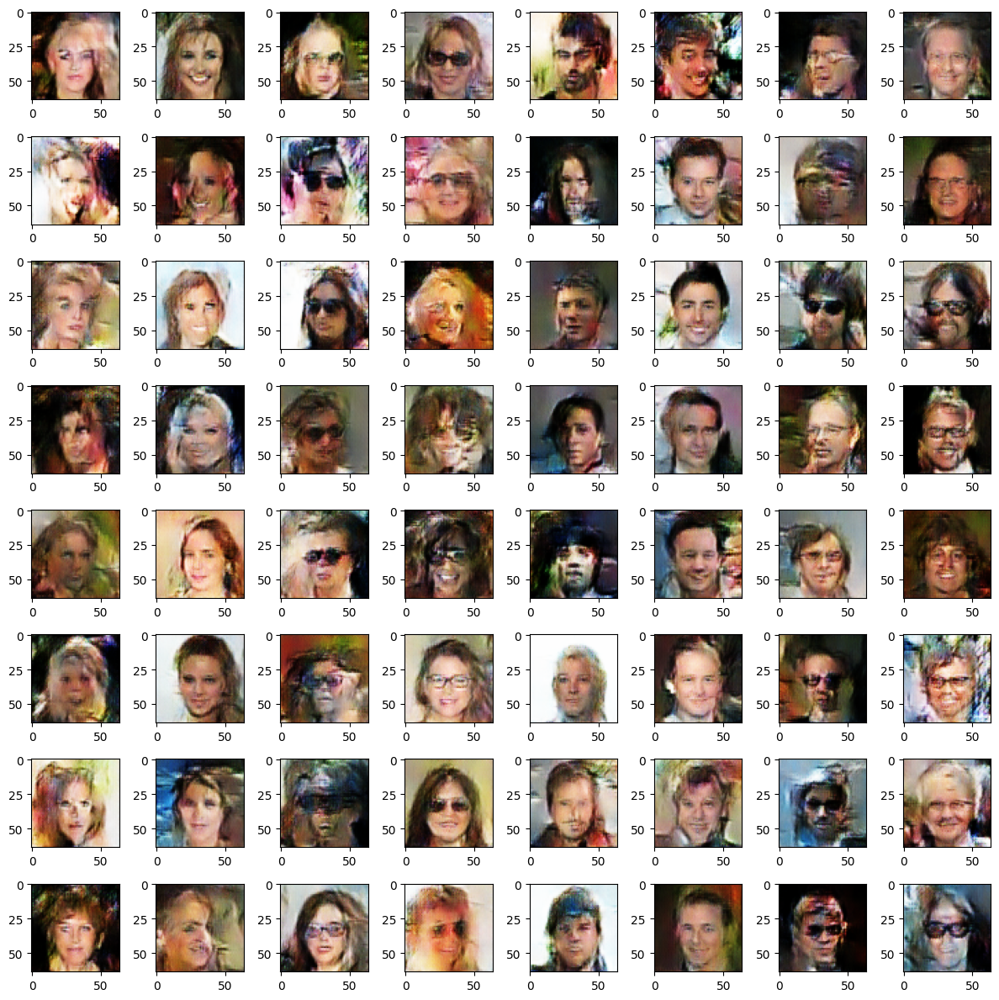


epoch 811/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5757 | g_loss: 1.4946 | val_attr_acc: 0.9345

epoch 812/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5699 | g_loss: 1.5102 | val_attr_acc: 0.9332

epoch 813/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5725 | g_loss: 1.5108 | val_attr_acc: 0.9400

epoch 814/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5702 | g_loss: 1.5068 | val_attr_acc: 0.9377

epoch 815/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5817 | g_loss: 1.4837 | val_attr_acc: 0.9351

epoch 816/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5796 | g_loss: 1.4890 | val_attr_acc: 0.9283

epoch 817/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5797 | g_loss: 1.5011 | val_attr_acc: 0.9384

epoch 818/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5779 | g_loss: 1.4951 | val_attr_acc: 0.9309

epoch 819/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5774 | g_loss: 1.5021 | val_attr_acc: 0.9400

epoch 820/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5778 | g_loss: 1.4947 | val_attr_acc: 0.9387

epoch 821/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5781 | g_loss: 1.4998 | val_attr_acc: 0.9394

epoch 822/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5741 | g_loss: 1.5008 | val_attr_acc: 0.9351

epoch 823/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5780 | g_loss: 1.4984 | val_attr_acc: 0.9264

epoch 824/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5767 | g_loss: 1.5001 | val_attr_acc: 0.9290

epoch 825/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9359
d_loss: 0.5727 | g_loss: 1.4993 | val_attr_acc: 0.9270

epoch 826/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5808 | g_loss: 1.4943 | val_attr_acc: 0.9332

epoch 827/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5806 | g_loss: 1.4919 | val_attr_acc: 0.9355

epoch 828/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5724 | g_loss: 1.5051 | val_attr_acc: 0.9348

epoch 829/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5730 | g_loss: 1.5065 | val_attr_acc: 0.9313

epoch 830/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5785 | g_loss: 1.4976 | val_attr_acc: 0.9251

epoch 831/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5802 | g_loss: 1.4932 | val_attr_acc: 0.9329

epoch 832/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5792 | g_loss: 1.4962 | val_attr_acc: 0.9436

epoch 833/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5768 | g_loss: 1.5001 | val_attr_acc: 0.9361

epoch 834/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5756 | g_loss: 1.5010 | val_attr_acc: 0.9394

epoch 835/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5755 | g_loss: 1.5036 | val_attr_acc: 0.9364

epoch 836/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5700 | g_loss: 1.5062 | val_attr_acc: 0.9339

epoch 837/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5763 | g_loss: 1.4995 | val_attr_acc: 0.9322

epoch 838/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5759 | g_loss: 1.5023 | val_attr_acc: 0.9374

epoch 839/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5798 | g_loss: 1.4917 | val_attr_acc: 0.9377

epoch 840/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
new best val_acc: 0.9510
d_loss: 0.5778 | g_loss: 1.4889 | val_attr_acc: 0.9510

epoch 841/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5765 | g_loss: 1.4959 | val_attr_acc: 0.9274

epoch 842/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5724 | g_loss: 1.5076 | val_attr_acc: 0.9348

epoch 843/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5798 | g_loss: 1.4873 | val_attr_acc: 0.9374

epoch 844/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5778 | g_loss: 1.4928 | val_attr_acc: 0.9342

epoch 845/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9338
d_loss: 0.5825 | g_loss: 1.4919 | val_attr_acc: 0.9306

epoch 846/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5741 | g_loss: 1.5012 | val_attr_acc: 0.9345

epoch 847/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5779 | g_loss: 1.5028 | val_attr_acc: 0.9339

epoch 848/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5765 | g_loss: 1.5021 | val_attr_acc: 0.9335

epoch 849/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5738 | g_loss: 1.5030 | val_attr_acc: 0.9335

epoch 850/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5723 | g_loss: 1.5065 | val_attr_acc: 0.9394

epoch 851/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5744 | g_loss: 1.5034 | val_attr_acc: 0.9345

epoch 852/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5759 | g_loss: 1.4888 | val_attr_acc: 0.9377

epoch 853/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5741 | g_loss: 1.4982 | val_attr_acc: 0.9374

epoch 854/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5738 | g_loss: 1.4959 | val_attr_acc: 0.9348

epoch 855/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5791 | g_loss: 1.4910 | val_attr_acc: 0.9381

epoch 856/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5761 | g_loss: 1.4987 | val_attr_acc: 0.9326

epoch 857/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5730 | g_loss: 1.5011 | val_attr_acc: 0.9290

epoch 858/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5697 | g_loss: 1.5061 | val_attr_acc: 0.9335

epoch 859/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5767 | g_loss: 1.4972 | val_attr_acc: 0.9364

epoch 860/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5760 | g_loss: 1.5016 | val_attr_acc: 0.9296

epoch 861/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9356
d_loss: 0.5795 | g_loss: 1.4989 | val_attr_acc: 0.9306

epoch 862/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5725 | g_loss: 1.5087 | val_attr_acc: 0.9420

epoch 863/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5775 | g_loss: 1.4948 | val_attr_acc: 0.9296

epoch 864/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5780 | g_loss: 1.5018 | val_attr_acc: 0.9319

epoch 865/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9339
d_loss: 0.5767 | g_loss: 1.5032 | val_attr_acc: 0.9384

epoch 866/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5767 | g_loss: 1.4995 | val_attr_acc: 0.9423

epoch 867/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5737 | g_loss: 1.4976 | val_attr_acc: 0.9358

epoch 868/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5749 | g_loss: 1.4966 | val_attr_acc: 0.9355

epoch 869/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5748 | g_loss: 1.4959 | val_attr_acc: 0.9410

epoch 870/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9337
d_loss: 0.5797 | g_loss: 1.4925 | val_attr_acc: 0.9332

epoch 871/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5826 | g_loss: 1.4861 | val_attr_acc: 0.9345

epoch 872/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5761 | g_loss: 1.5016 | val_attr_acc: 0.9287

epoch 873/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5732 | g_loss: 1.4997 | val_attr_acc: 0.9351

epoch 874/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5746 | g_loss: 1.4997 | val_attr_acc: 0.9261

epoch 875/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5745 | g_loss: 1.4986 | val_attr_acc: 0.9339

epoch 876/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5715 | g_loss: 1.4997 | val_attr_acc: 0.9452

epoch 877/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5789 | g_loss: 1.5007 | val_attr_acc: 0.9374

epoch 878/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5728 | g_loss: 1.5076 | val_attr_acc: 0.9290

epoch 879/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5766 | g_loss: 1.5054 | val_attr_acc: 0.9332

epoch 880/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5800 | g_loss: 1.4890 | val_attr_acc: 0.9329

epoch 881/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5773 | g_loss: 1.4979 | val_attr_acc: 0.9361

epoch 882/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5787 | g_loss: 1.4926 | val_attr_acc: 0.9322

epoch 883/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5739 | g_loss: 1.5043 | val_attr_acc: 0.9316

epoch 884/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9356
d_loss: 0.5742 | g_loss: 1.5030 | val_attr_acc: 0.9364

epoch 885/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9339
d_loss: 0.5771 | g_loss: 1.5011 | val_attr_acc: 0.9287

epoch 886/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5792 | g_loss: 1.4929 | val_attr_acc: 0.9335

epoch 887/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5794 | g_loss: 1.4939 | val_attr_acc: 0.9329

epoch 888/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5733 | g_loss: 1.5002 | val_attr_acc: 0.9364

epoch 889/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5757 | g_loss: 1.4944 | val_attr_acc: 0.9348

epoch 890/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5797 | g_loss: 1.4961 | val_attr_acc: 0.9358

epoch 891/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5798 | g_loss: 1.5009 | val_attr_acc: 0.9293

epoch 892/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5774 | g_loss: 1.5012 | val_attr_acc: 0.9348

epoch 893/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5789 | g_loss: 1.4923 | val_attr_acc: 0.9426

epoch 894/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5828 | g_loss: 1.4995 | val_attr_acc: 0.9361

epoch 895/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5780 | g_loss: 1.4992 | val_attr_acc: 0.9235

epoch 896/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5799 | g_loss: 1.4843 | val_attr_acc: 0.9355

epoch 897/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5765 | g_loss: 1.4993 | val_attr_acc: 0.9394

epoch 898/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5765 | g_loss: 1.4942 | val_attr_acc: 0.9371

epoch 899/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5760 | g_loss: 1.5001 | val_attr_acc: 0.9381

epoch 900/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5730 | g_loss: 1.5084 | val_attr_acc: 0.9332

epoch 901/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5765 | g_loss: 1.5006 | val_attr_acc: 0.9306

epoch 902/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5803 | g_loss: 1.4902 | val_attr_acc: 0.9387

epoch 903/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5808 | g_loss: 1.4875 | val_attr_acc: 0.9326

epoch 904/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5761 | g_loss: 1.5062 | val_attr_acc: 0.9361

epoch 905/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9356
d_loss: 0.5802 | g_loss: 1.4966 | val_attr_acc: 0.9277

epoch 906/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5735 | g_loss: 1.5008 | val_attr_acc: 0.9397

epoch 907/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5811 | g_loss: 1.4903 | val_attr_acc: 0.9290

epoch 908/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5783 | g_loss: 1.4865 | val_attr_acc: 0.9287

epoch 909/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5790 | g_loss: 1.4990 | val_attr_acc: 0.9390

epoch 910/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5806 | g_loss: 1.5000 | val_attr_acc: 0.9339

epoch 911/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5793 | g_loss: 1.4917 | val_attr_acc: 0.9394

epoch 912/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5817 | g_loss: 1.4888 | val_attr_acc: 0.9348

epoch 913/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5761 | g_loss: 1.4940 | val_attr_acc: 0.9374

epoch 914/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5772 | g_loss: 1.4991 | val_attr_acc: 0.9384

epoch 915/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5786 | g_loss: 1.4851 | val_attr_acc: 0.9342

epoch 916/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5749 | g_loss: 1.5036 | val_attr_acc: 0.9364

epoch 917/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5753 | g_loss: 1.5017 | val_attr_acc: 0.9342

epoch 918/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5805 | g_loss: 1.4970 | val_attr_acc: 0.9384

epoch 919/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5750 | g_loss: 1.5040 | val_attr_acc: 0.9374

epoch 920/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5790 | g_loss: 1.5003 | val_attr_acc: 0.9364

epoch 921/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5765 | g_loss: 1.4985 | val_attr_acc: 0.9361

epoch 922/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5741 | g_loss: 1.4973 | val_attr_acc: 0.9251

epoch 923/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5764 | g_loss: 1.4959 | val_attr_acc: 0.9322

epoch 924/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5797 | g_loss: 1.4965 | val_attr_acc: 0.9332

epoch 925/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5753 | g_loss: 1.4930 | val_attr_acc: 0.9348

epoch 926/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5765 | g_loss: 1.4959 | val_attr_acc: 0.9407

epoch 927/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5741 | g_loss: 1.4971 | val_attr_acc: 0.9358

epoch 928/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5795 | g_loss: 1.4894 | val_attr_acc: 0.9332

epoch 929/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5733 | g_loss: 1.4984 | val_attr_acc: 0.9364

epoch 930/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9358
d_loss: 0.5748 | g_loss: 1.5029 | val_attr_acc: 0.9420

epoch 931/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5728 | g_loss: 1.4968 | val_attr_acc: 0.9397

epoch 932/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5723 | g_loss: 1.5015 | val_attr_acc: 0.9329

epoch 933/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5801 | g_loss: 1.4930 | val_attr_acc: 0.9342

epoch 934/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5797 | g_loss: 1.4942 | val_attr_acc: 0.9377

epoch 935/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5775 | g_loss: 1.4953 | val_attr_acc: 0.9348

epoch 936/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5740 | g_loss: 1.4912 | val_attr_acc: 0.9377

epoch 937/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5791 | g_loss: 1.4921 | val_attr_acc: 0.9319

epoch 938/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9356
d_loss: 0.5756 | g_loss: 1.4976 | val_attr_acc: 0.9371

epoch 939/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5784 | g_loss: 1.4924 | val_attr_acc: 0.9377

epoch 940/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5745 | g_loss: 1.4988 | val_attr_acc: 0.9339

epoch 941/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5753 | g_loss: 1.4967 | val_attr_acc: 0.9332

epoch 942/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5804 | g_loss: 1.5052 | val_attr_acc: 0.9403

epoch 943/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5759 | g_loss: 1.4953 | val_attr_acc: 0.9413

epoch 944/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5744 | g_loss: 1.4979 | val_attr_acc: 0.9313

epoch 945/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5745 | g_loss: 1.5012 | val_attr_acc: 0.9371

epoch 946/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5715 | g_loss: 1.5006 | val_attr_acc: 0.9332

epoch 947/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5787 | g_loss: 1.4923 | val_attr_acc: 0.9345

epoch 948/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5766 | g_loss: 1.4971 | val_attr_acc: 0.9326

epoch 949/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5706 | g_loss: 1.4998 | val_attr_acc: 0.9345

epoch 950/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5754 | g_loss: 1.5085 | val_attr_acc: 0.9361

epoch 951/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5764 | g_loss: 1.4922 | val_attr_acc: 0.9364

epoch 952/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5799 | g_loss: 1.4949 | val_attr_acc: 0.9368

epoch 953/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5797 | g_loss: 1.5014 | val_attr_acc: 0.9387

epoch 954/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5750 | g_loss: 1.5010 | val_attr_acc: 0.9368

epoch 955/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5727 | g_loss: 1.5035 | val_attr_acc: 0.9339

epoch 956/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5713 | g_loss: 1.5032 | val_attr_acc: 0.9377

epoch 957/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5773 | g_loss: 1.4854 | val_attr_acc: 0.9342

epoch 958/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5782 | g_loss: 1.4978 | val_attr_acc: 0.9316

epoch 959/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5757 | g_loss: 1.4940 | val_attr_acc: 0.9309

epoch 960/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5781 | g_loss: 1.4918 | val_attr_acc: 0.9335

epoch 961/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9339
d_loss: 0.5821 | g_loss: 1.4939 | val_attr_acc: 0.9394

epoch 962/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9358
d_loss: 0.5729 | g_loss: 1.4904 | val_attr_acc: 0.9332

epoch 963/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5749 | g_loss: 1.5029 | val_attr_acc: 0.9410

epoch 964/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9360
d_loss: 0.5766 | g_loss: 1.4970 | val_attr_acc: 0.9348

epoch 965/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5786 | g_loss: 1.4998 | val_attr_acc: 0.9332

epoch 966/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5697 | g_loss: 1.5001 | val_attr_acc: 0.9413

epoch 967/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5755 | g_loss: 1.4926 | val_attr_acc: 0.9377

epoch 968/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5772 | g_loss: 1.4960 | val_attr_acc: 0.9345

epoch 969/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5778 | g_loss: 1.5063 | val_attr_acc: 0.9377

epoch 970/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9361
d_loss: 0.5738 | g_loss: 1.4965 | val_attr_acc: 0.9377

epoch 971/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5782 | g_loss: 1.5004 | val_attr_acc: 0.9342

epoch 972/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5762 | g_loss: 1.5003 | val_attr_acc: 0.9407


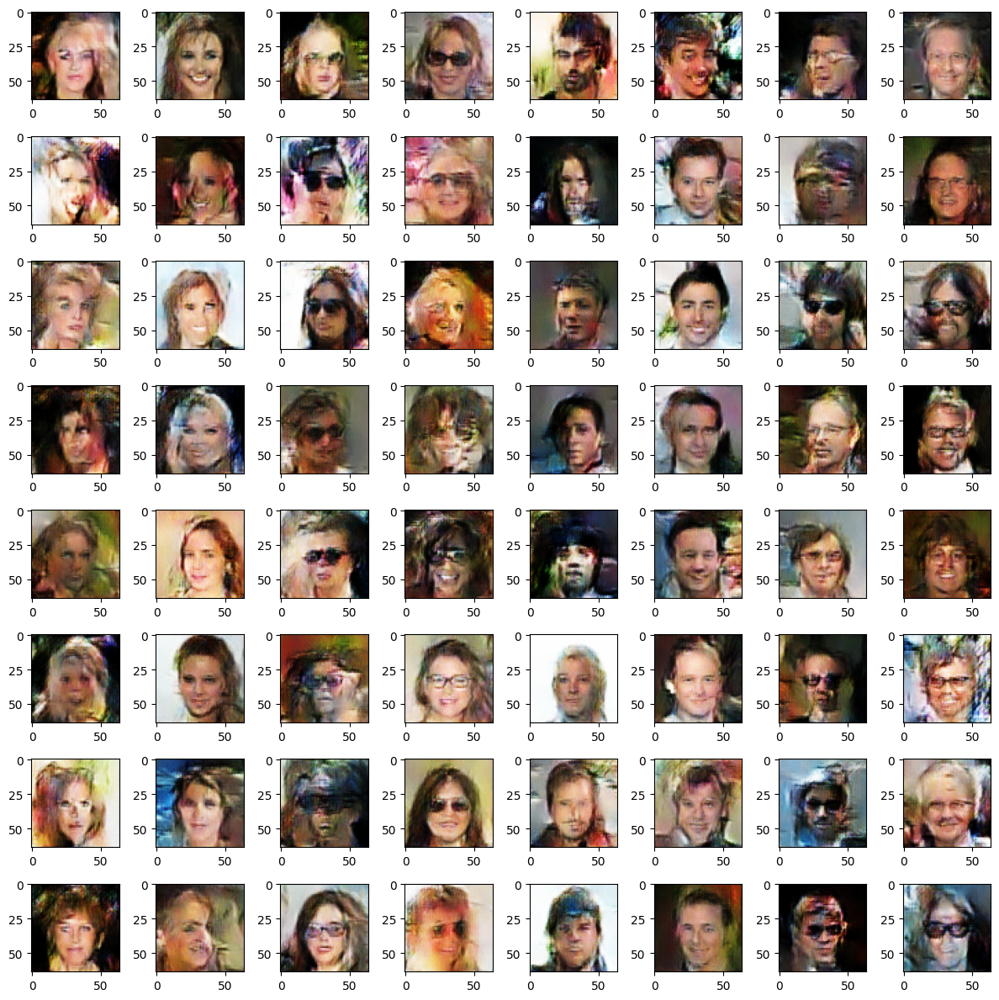


epoch 973/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5752 | g_loss: 1.5032 | val_attr_acc: 0.9355

epoch 974/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5803 | g_loss: 1.5062 | val_attr_acc: 0.9322

epoch 975/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5752 | g_loss: 1.5010 | val_attr_acc: 0.9371

epoch 976/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5749 | g_loss: 1.5021 | val_attr_acc: 0.9390

epoch 977/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5789 | g_loss: 1.4993 | val_attr_acc: 0.9322

epoch 978/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5753 | g_loss: 1.4985 | val_attr_acc: 0.9390

epoch 979/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5761 | g_loss: 1.4953 | val_attr_acc: 0.9410

epoch 980/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5766 | g_loss: 1.4995 | val_attr_acc: 0.9371

epoch 981/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5802 | g_loss: 1.5016 | val_attr_acc: 0.9329

epoch 982/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5742 | g_loss: 1.5001 | val_attr_acc: 0.9345

epoch 983/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5726 | g_loss: 1.4977 | val_attr_acc: 0.9342

epoch 984/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5787 | g_loss: 1.4877 | val_attr_acc: 0.9416

epoch 985/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5748 | g_loss: 1.4938 | val_attr_acc: 0.9342

epoch 986/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5807 | g_loss: 1.4916 | val_attr_acc: 0.9342

epoch 987/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5719 | g_loss: 1.5034 | val_attr_acc: 0.9481

epoch 988/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5766 | g_loss: 1.5056 | val_attr_acc: 0.9410

epoch 989/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5777 | g_loss: 1.4895 | val_attr_acc: 0.9316

epoch 990/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5739 | g_loss: 1.5000 | val_attr_acc: 0.9381

epoch 991/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5775 | g_loss: 1.5101 | val_attr_acc: 0.9416

epoch 992/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5751 | g_loss: 1.4980 | val_attr_acc: 0.9400

epoch 993/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5814 | g_loss: 1.4931 | val_attr_acc: 0.9371

epoch 994/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5720 | g_loss: 1.5081 | val_attr_acc: 0.9261

epoch 995/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5726 | g_loss: 1.5019 | val_attr_acc: 0.9364

epoch 996/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5803 | g_loss: 1.4951 | val_attr_acc: 0.9361

epoch 997/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9338
d_loss: 0.5823 | g_loss: 1.4871 | val_attr_acc: 0.9381

epoch 998/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5710 | g_loss: 1.5074 | val_attr_acc: 0.9264

epoch 999/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5801 | g_loss: 1.4968 | val_attr_acc: 0.9374

epoch 1000/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5772 | g_loss: 1.4994 | val_attr_acc: 0.9390

epoch 1001/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5807 | g_loss: 1.4916 | val_attr_acc: 0.9348

epoch 1002/1620 - lr: 0.000125


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
reduced lr to 0.000063
d_loss: 0.5807 | g_loss: 1.4985 | val_attr_acc: 0.9384

epoch 1003/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5799 | g_loss: 1.4909 | val_attr_acc: 0.9403

epoch 1004/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5739 | g_loss: 1.5005 | val_attr_acc: 0.9368

epoch 1005/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9339
d_loss: 0.5736 | g_loss: 1.5108 | val_attr_acc: 0.9390

epoch 1006/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5731 | g_loss: 1.5055 | val_attr_acc: 0.9355

epoch 1007/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5801 | g_loss: 1.4931 | val_attr_acc: 0.9329

epoch 1008/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5721 | g_loss: 1.4976 | val_attr_acc: 0.9348

epoch 1009/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5776 | g_loss: 1.5070 | val_attr_acc: 0.9390

epoch 1010/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5749 | g_loss: 1.5007 | val_attr_acc: 0.9261

epoch 1011/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5777 | g_loss: 1.5041 | val_attr_acc: 0.9322

epoch 1012/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5762 | g_loss: 1.5037 | val_attr_acc: 0.9348

epoch 1013/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5743 | g_loss: 1.5037 | val_attr_acc: 0.9293

epoch 1014/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5761 | g_loss: 1.5059 | val_attr_acc: 0.9329

epoch 1015/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5767 | g_loss: 1.4979 | val_attr_acc: 0.9244

epoch 1016/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5746 | g_loss: 1.4986 | val_attr_acc: 0.9300

epoch 1017/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5733 | g_loss: 1.4998 | val_attr_acc: 0.9377

epoch 1018/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5715 | g_loss: 1.5021 | val_attr_acc: 0.9322

epoch 1019/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5813 | g_loss: 1.4931 | val_attr_acc: 0.9374

epoch 1020/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5821 | g_loss: 1.4898 | val_attr_acc: 0.9326

epoch 1021/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5823 | g_loss: 1.4899 | val_attr_acc: 0.9313

epoch 1022/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9356
d_loss: 0.5709 | g_loss: 1.5141 | val_attr_acc: 0.9397

epoch 1023/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5762 | g_loss: 1.4937 | val_attr_acc: 0.9390

epoch 1024/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5800 | g_loss: 1.4998 | val_attr_acc: 0.9335

epoch 1025/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5741 | g_loss: 1.5036 | val_attr_acc: 0.9374

epoch 1026/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5755 | g_loss: 1.5053 | val_attr_acc: 0.9384

epoch 1027/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5729 | g_loss: 1.5042 | val_attr_acc: 0.9300

epoch 1028/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5796 | g_loss: 1.4865 | val_attr_acc: 0.9296

epoch 1029/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5744 | g_loss: 1.5027 | val_attr_acc: 0.9368

epoch 1030/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5763 | g_loss: 1.5022 | val_attr_acc: 0.9355

epoch 1031/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5783 | g_loss: 1.4966 | val_attr_acc: 0.9381

epoch 1032/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5816 | g_loss: 1.4897 | val_attr_acc: 0.9345

epoch 1033/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5763 | g_loss: 1.5056 | val_attr_acc: 0.9322

epoch 1034/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5755 | g_loss: 1.4986 | val_attr_acc: 0.9403

epoch 1035/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5815 | g_loss: 1.4923 | val_attr_acc: 0.9322

epoch 1036/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5715 | g_loss: 1.5133 | val_attr_acc: 0.9351

epoch 1037/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5789 | g_loss: 1.4943 | val_attr_acc: 0.9355

epoch 1038/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5786 | g_loss: 1.4889 | val_attr_acc: 0.9364

epoch 1039/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5707 | g_loss: 1.5036 | val_attr_acc: 0.9335

epoch 1040/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5763 | g_loss: 1.5047 | val_attr_acc: 0.9420

epoch 1041/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5734 | g_loss: 1.4986 | val_attr_acc: 0.9348

epoch 1042/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5764 | g_loss: 1.5068 | val_attr_acc: 0.9377

epoch 1043/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5744 | g_loss: 1.5038 | val_attr_acc: 0.9345

epoch 1044/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5750 | g_loss: 1.4950 | val_attr_acc: 0.9348

epoch 1045/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5786 | g_loss: 1.4902 | val_attr_acc: 0.9309

epoch 1046/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5823 | g_loss: 1.4846 | val_attr_acc: 0.9342

epoch 1047/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9339
d_loss: 0.5783 | g_loss: 1.4955 | val_attr_acc: 0.9442

epoch 1048/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5708 | g_loss: 1.4978 | val_attr_acc: 0.9348

epoch 1049/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5737 | g_loss: 1.5100 | val_attr_acc: 0.9351

epoch 1050/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5771 | g_loss: 1.4970 | val_attr_acc: 0.9368

epoch 1051/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5730 | g_loss: 1.5007 | val_attr_acc: 0.9339

epoch 1052/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9358
d_loss: 0.5780 | g_loss: 1.4908 | val_attr_acc: 0.9361

epoch 1053/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5720 | g_loss: 1.5011 | val_attr_acc: 0.9358

epoch 1054/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9356
d_loss: 0.5753 | g_loss: 1.4878 | val_attr_acc: 0.9342

epoch 1055/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5836 | g_loss: 1.4914 | val_attr_acc: 0.9400

epoch 1056/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5776 | g_loss: 1.4981 | val_attr_acc: 0.9368

epoch 1057/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5733 | g_loss: 1.5042 | val_attr_acc: 0.9358

epoch 1058/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5805 | g_loss: 1.4977 | val_attr_acc: 0.9326

epoch 1059/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5728 | g_loss: 1.5037 | val_attr_acc: 0.9326

epoch 1060/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5750 | g_loss: 1.5053 | val_attr_acc: 0.9361

epoch 1061/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5750 | g_loss: 1.5101 | val_attr_acc: 0.9335

epoch 1062/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5779 | g_loss: 1.4954 | val_attr_acc: 0.9293

epoch 1063/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5847 | g_loss: 1.4857 | val_attr_acc: 0.9371

epoch 1064/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5807 | g_loss: 1.4901 | val_attr_acc: 0.9329

epoch 1065/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5725 | g_loss: 1.5103 | val_attr_acc: 0.9361

epoch 1066/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5724 | g_loss: 1.5034 | val_attr_acc: 0.9296

epoch 1067/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5743 | g_loss: 1.4920 | val_attr_acc: 0.9303

epoch 1068/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5772 | g_loss: 1.4961 | val_attr_acc: 0.9267

epoch 1069/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5771 | g_loss: 1.4871 | val_attr_acc: 0.9326

epoch 1070/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5737 | g_loss: 1.5011 | val_attr_acc: 0.9326

epoch 1071/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5731 | g_loss: 1.4990 | val_attr_acc: 0.9326

epoch 1072/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5753 | g_loss: 1.5022 | val_attr_acc: 0.9319

epoch 1073/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5769 | g_loss: 1.5062 | val_attr_acc: 0.9277

epoch 1074/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5758 | g_loss: 1.4977 | val_attr_acc: 0.9348

epoch 1075/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9359
d_loss: 0.5791 | g_loss: 1.4993 | val_attr_acc: 0.9351

epoch 1076/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5812 | g_loss: 1.4978 | val_attr_acc: 0.9371

epoch 1077/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5766 | g_loss: 1.5017 | val_attr_acc: 0.9355

epoch 1078/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5790 | g_loss: 1.4990 | val_attr_acc: 0.9335

epoch 1079/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5755 | g_loss: 1.4985 | val_attr_acc: 0.9342

epoch 1080/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5791 | g_loss: 1.4924 | val_attr_acc: 0.9342

epoch 1081/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5796 | g_loss: 1.4914 | val_attr_acc: 0.9400

epoch 1082/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5726 | g_loss: 1.5072 | val_attr_acc: 0.9222

epoch 1083/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5772 | g_loss: 1.4984 | val_attr_acc: 0.9351

epoch 1084/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5797 | g_loss: 1.5070 | val_attr_acc: 0.9339

epoch 1085/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5746 | g_loss: 1.4994 | val_attr_acc: 0.9403

epoch 1086/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5722 | g_loss: 1.5047 | val_attr_acc: 0.9319

epoch 1087/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5750 | g_loss: 1.4969 | val_attr_acc: 0.9413

epoch 1088/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5735 | g_loss: 1.5008 | val_attr_acc: 0.9248

epoch 1089/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5757 | g_loss: 1.5011 | val_attr_acc: 0.9316

epoch 1090/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5779 | g_loss: 1.4932 | val_attr_acc: 0.9358

epoch 1091/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5743 | g_loss: 1.4973 | val_attr_acc: 0.9407

epoch 1092/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5759 | g_loss: 1.4989 | val_attr_acc: 0.9313

epoch 1093/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5753 | g_loss: 1.4992 | val_attr_acc: 0.9290

epoch 1094/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5781 | g_loss: 1.4962 | val_attr_acc: 0.9381

epoch 1095/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5748 | g_loss: 1.4948 | val_attr_acc: 0.9358

epoch 1096/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5708 | g_loss: 1.5096 | val_attr_acc: 0.9345

epoch 1097/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5850 | g_loss: 1.4937 | val_attr_acc: 0.9361

epoch 1098/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5756 | g_loss: 1.4986 | val_attr_acc: 0.9309

epoch 1099/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5724 | g_loss: 1.4993 | val_attr_acc: 0.9368

epoch 1100/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5810 | g_loss: 1.4881 | val_attr_acc: 0.9345

epoch 1101/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5722 | g_loss: 1.5066 | val_attr_acc: 0.9300

epoch 1102/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5733 | g_loss: 1.4995 | val_attr_acc: 0.9374

epoch 1103/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5747 | g_loss: 1.5021 | val_attr_acc: 0.9374

epoch 1104/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9337
d_loss: 0.5764 | g_loss: 1.5091 | val_attr_acc: 0.9342

epoch 1105/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5793 | g_loss: 1.4960 | val_attr_acc: 0.9390

epoch 1106/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5746 | g_loss: 1.5035 | val_attr_acc: 0.9381

epoch 1107/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5808 | g_loss: 1.4940 | val_attr_acc: 0.9374

epoch 1108/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5804 | g_loss: 1.4995 | val_attr_acc: 0.9326

epoch 1109/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5785 | g_loss: 1.4946 | val_attr_acc: 0.9316

epoch 1110/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5745 | g_loss: 1.4982 | val_attr_acc: 0.9335

epoch 1111/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5800 | g_loss: 1.4879 | val_attr_acc: 0.9358

epoch 1112/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5783 | g_loss: 1.4971 | val_attr_acc: 0.9290

epoch 1113/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5732 | g_loss: 1.4966 | val_attr_acc: 0.9329

epoch 1114/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5722 | g_loss: 1.5098 | val_attr_acc: 0.9335

epoch 1115/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5787 | g_loss: 1.5063 | val_attr_acc: 0.9371

epoch 1116/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5768 | g_loss: 1.4952 | val_attr_acc: 0.9345

epoch 1117/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5748 | g_loss: 1.5079 | val_attr_acc: 0.9303

epoch 1118/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5738 | g_loss: 1.4918 | val_attr_acc: 0.9410

epoch 1119/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5714 | g_loss: 1.5061 | val_attr_acc: 0.9306

epoch 1120/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5774 | g_loss: 1.4877 | val_attr_acc: 0.9329

epoch 1121/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5745 | g_loss: 1.4986 | val_attr_acc: 0.9390

epoch 1122/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9356
d_loss: 0.5772 | g_loss: 1.4931 | val_attr_acc: 0.9407

epoch 1123/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5741 | g_loss: 1.4990 | val_attr_acc: 0.9345

epoch 1124/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5696 | g_loss: 1.5039 | val_attr_acc: 0.9316

epoch 1125/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5748 | g_loss: 1.5054 | val_attr_acc: 0.9426

epoch 1126/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5796 | g_loss: 1.4938 | val_attr_acc: 0.9319

epoch 1127/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5812 | g_loss: 1.4899 | val_attr_acc: 0.9309

epoch 1128/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5752 | g_loss: 1.4976 | val_attr_acc: 0.9303

epoch 1129/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5731 | g_loss: 1.5073 | val_attr_acc: 0.9358

epoch 1130/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5718 | g_loss: 1.4984 | val_attr_acc: 0.9270

epoch 1131/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5802 | g_loss: 1.4964 | val_attr_acc: 0.9313

epoch 1132/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5745 | g_loss: 1.4953 | val_attr_acc: 0.9377

epoch 1133/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5792 | g_loss: 1.4913 | val_attr_acc: 0.9452

epoch 1134/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5761 | g_loss: 1.5004 | val_attr_acc: 0.9313


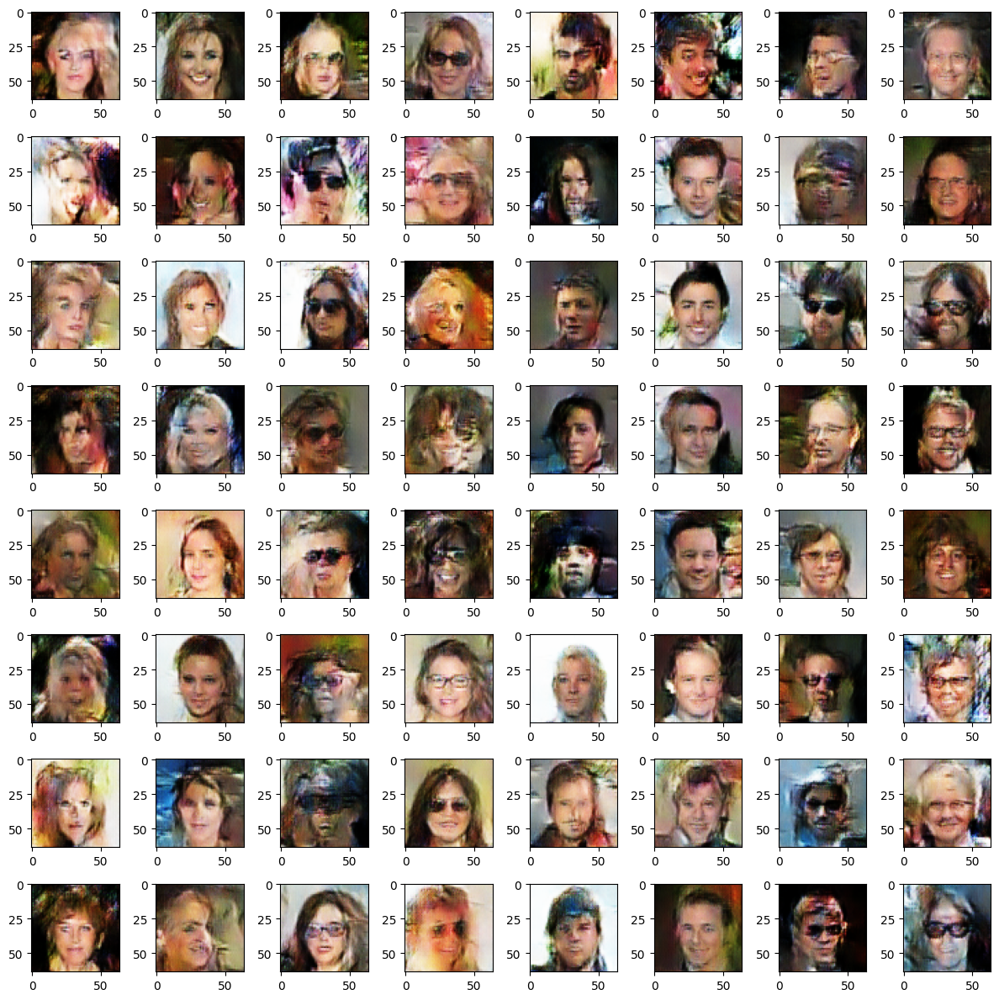


epoch 1135/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5785 | g_loss: 1.5018 | val_attr_acc: 0.9416

epoch 1136/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5784 | g_loss: 1.4840 | val_attr_acc: 0.9283

epoch 1137/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5781 | g_loss: 1.4955 | val_attr_acc: 0.9300

epoch 1138/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9360
d_loss: 0.5763 | g_loss: 1.5033 | val_attr_acc: 0.9416

epoch 1139/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5755 | g_loss: 1.4983 | val_attr_acc: 0.9371

epoch 1140/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9336
d_loss: 0.5788 | g_loss: 1.5057 | val_attr_acc: 0.9387

epoch 1141/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9358
d_loss: 0.5806 | g_loss: 1.4936 | val_attr_acc: 0.9277

epoch 1142/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5735 | g_loss: 1.4941 | val_attr_acc: 0.9400

epoch 1143/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5726 | g_loss: 1.5019 | val_attr_acc: 0.9364

epoch 1144/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5757 | g_loss: 1.4970 | val_attr_acc: 0.9351

epoch 1145/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5751 | g_loss: 1.5019 | val_attr_acc: 0.9313

epoch 1146/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5741 | g_loss: 1.5089 | val_attr_acc: 0.9364

epoch 1147/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5762 | g_loss: 1.5028 | val_attr_acc: 0.9387

epoch 1148/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5784 | g_loss: 1.5036 | val_attr_acc: 0.9345

epoch 1149/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5765 | g_loss: 1.4989 | val_attr_acc: 0.9351

epoch 1150/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5795 | g_loss: 1.4920 | val_attr_acc: 0.9433

epoch 1151/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5756 | g_loss: 1.4983 | val_attr_acc: 0.9329

epoch 1152/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5745 | g_loss: 1.4932 | val_attr_acc: 0.9377

epoch 1153/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5741 | g_loss: 1.4973 | val_attr_acc: 0.9361

epoch 1154/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5786 | g_loss: 1.4948 | val_attr_acc: 0.9228

epoch 1155/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5726 | g_loss: 1.5085 | val_attr_acc: 0.9329

epoch 1156/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9358
d_loss: 0.5771 | g_loss: 1.4973 | val_attr_acc: 0.9326

epoch 1157/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5800 | g_loss: 1.4877 | val_attr_acc: 0.9342

epoch 1158/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5746 | g_loss: 1.5018 | val_attr_acc: 0.9339

epoch 1159/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5799 | g_loss: 1.4939 | val_attr_acc: 0.9296

epoch 1160/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5804 | g_loss: 1.4889 | val_attr_acc: 0.9306

epoch 1161/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9335
d_loss: 0.5775 | g_loss: 1.4961 | val_attr_acc: 0.9384

epoch 1162/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5754 | g_loss: 1.4997 | val_attr_acc: 0.9264

epoch 1163/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5730 | g_loss: 1.4984 | val_attr_acc: 0.9384

epoch 1164/1620 - lr: 0.000063


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
reduced lr to 0.000031
d_loss: 0.5727 | g_loss: 1.5055 | val_attr_acc: 0.9332

epoch 1165/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5765 | g_loss: 1.4910 | val_attr_acc: 0.9345

epoch 1166/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5728 | g_loss: 1.4996 | val_attr_acc: 0.9429

epoch 1167/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5735 | g_loss: 1.5021 | val_attr_acc: 0.9280

epoch 1168/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9361
d_loss: 0.5767 | g_loss: 1.4989 | val_attr_acc: 0.9355

epoch 1169/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5767 | g_loss: 1.4965 | val_attr_acc: 0.9342

epoch 1170/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9356
d_loss: 0.5749 | g_loss: 1.5000 | val_attr_acc: 0.9377

epoch 1171/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5734 | g_loss: 1.5082 | val_attr_acc: 0.9361

epoch 1172/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5794 | g_loss: 1.4973 | val_attr_acc: 0.9371

epoch 1173/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5748 | g_loss: 1.4946 | val_attr_acc: 0.9300

epoch 1174/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9338
d_loss: 0.5752 | g_loss: 1.5011 | val_attr_acc: 0.9300

epoch 1175/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5753 | g_loss: 1.4950 | val_attr_acc: 0.9433

epoch 1176/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5764 | g_loss: 1.5012 | val_attr_acc: 0.9332

epoch 1177/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5764 | g_loss: 1.5015 | val_attr_acc: 0.9332

epoch 1178/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5771 | g_loss: 1.5007 | val_attr_acc: 0.9309

epoch 1179/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5732 | g_loss: 1.5065 | val_attr_acc: 0.9316

epoch 1180/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5738 | g_loss: 1.5040 | val_attr_acc: 0.9433

epoch 1181/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5745 | g_loss: 1.5067 | val_attr_acc: 0.9322

epoch 1182/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5759 | g_loss: 1.5059 | val_attr_acc: 0.9274

epoch 1183/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5776 | g_loss: 1.5000 | val_attr_acc: 0.9316

epoch 1184/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5769 | g_loss: 1.5005 | val_attr_acc: 0.9300

epoch 1185/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5663 | g_loss: 1.5114 | val_attr_acc: 0.9374

epoch 1186/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5791 | g_loss: 1.4965 | val_attr_acc: 0.9296

epoch 1187/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5739 | g_loss: 1.4982 | val_attr_acc: 0.9355

epoch 1188/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5756 | g_loss: 1.4999 | val_attr_acc: 0.9390

epoch 1189/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5784 | g_loss: 1.4971 | val_attr_acc: 0.9316

epoch 1190/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5805 | g_loss: 1.4969 | val_attr_acc: 0.9306

epoch 1191/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9362
d_loss: 0.5779 | g_loss: 1.4915 | val_attr_acc: 0.9345

epoch 1192/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5724 | g_loss: 1.4958 | val_attr_acc: 0.9371

epoch 1193/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5746 | g_loss: 1.4958 | val_attr_acc: 0.9420

epoch 1194/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5818 | g_loss: 1.4926 | val_attr_acc: 0.9348

epoch 1195/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5764 | g_loss: 1.4971 | val_attr_acc: 0.9355

epoch 1196/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5799 | g_loss: 1.4936 | val_attr_acc: 0.9403

epoch 1197/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5762 | g_loss: 1.4959 | val_attr_acc: 0.9394

epoch 1198/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5753 | g_loss: 1.5077 | val_attr_acc: 0.9309

epoch 1199/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5738 | g_loss: 1.5007 | val_attr_acc: 0.9413

epoch 1200/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5714 | g_loss: 1.4948 | val_attr_acc: 0.9364

epoch 1201/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5835 | g_loss: 1.4823 | val_attr_acc: 0.9309

epoch 1202/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9364
d_loss: 0.5753 | g_loss: 1.5009 | val_attr_acc: 0.9381

epoch 1203/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5753 | g_loss: 1.5011 | val_attr_acc: 0.9351

epoch 1204/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5779 | g_loss: 1.4937 | val_attr_acc: 0.9351

epoch 1205/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5716 | g_loss: 1.5007 | val_attr_acc: 0.9319

epoch 1206/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5801 | g_loss: 1.4970 | val_attr_acc: 0.9358

epoch 1207/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5749 | g_loss: 1.4966 | val_attr_acc: 0.9410

epoch 1208/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5735 | g_loss: 1.5085 | val_attr_acc: 0.9384

epoch 1209/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5761 | g_loss: 1.4941 | val_attr_acc: 0.9283

epoch 1210/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5704 | g_loss: 1.5055 | val_attr_acc: 0.9348

epoch 1211/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5846 | g_loss: 1.4869 | val_attr_acc: 0.9407

epoch 1212/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5747 | g_loss: 1.5042 | val_attr_acc: 0.9358

epoch 1213/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5728 | g_loss: 1.4937 | val_attr_acc: 0.9416

epoch 1214/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5796 | g_loss: 1.4896 | val_attr_acc: 0.9329

epoch 1215/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9337
d_loss: 0.5791 | g_loss: 1.4873 | val_attr_acc: 0.9342

epoch 1216/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5758 | g_loss: 1.4931 | val_attr_acc: 0.9303

epoch 1217/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5753 | g_loss: 1.4977 | val_attr_acc: 0.9355

epoch 1218/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5772 | g_loss: 1.4875 | val_attr_acc: 0.9403

epoch 1219/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5829 | g_loss: 1.4895 | val_attr_acc: 0.9326

epoch 1220/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5759 | g_loss: 1.4955 | val_attr_acc: 0.9387

epoch 1221/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5677 | g_loss: 1.5033 | val_attr_acc: 0.9355

epoch 1222/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5743 | g_loss: 1.4956 | val_attr_acc: 0.9358

epoch 1223/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5755 | g_loss: 1.4976 | val_attr_acc: 0.9446

epoch 1224/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5806 | g_loss: 1.4923 | val_attr_acc: 0.9332

epoch 1225/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5753 | g_loss: 1.4976 | val_attr_acc: 0.9303

epoch 1226/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5778 | g_loss: 1.5034 | val_attr_acc: 0.9436

epoch 1227/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5787 | g_loss: 1.4966 | val_attr_acc: 0.9416

epoch 1228/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5765 | g_loss: 1.4839 | val_attr_acc: 0.9348

epoch 1229/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5751 | g_loss: 1.4996 | val_attr_acc: 0.9426

epoch 1230/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5718 | g_loss: 1.5021 | val_attr_acc: 0.9326

epoch 1231/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5733 | g_loss: 1.5049 | val_attr_acc: 0.9309

epoch 1232/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5725 | g_loss: 1.4998 | val_attr_acc: 0.9293

epoch 1233/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9358
d_loss: 0.5764 | g_loss: 1.4956 | val_attr_acc: 0.9313

epoch 1234/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5789 | g_loss: 1.4910 | val_attr_acc: 0.9394

epoch 1235/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5786 | g_loss: 1.4960 | val_attr_acc: 0.9316

epoch 1236/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5830 | g_loss: 1.4943 | val_attr_acc: 0.9339

epoch 1237/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5741 | g_loss: 1.5104 | val_attr_acc: 0.9316

epoch 1238/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5725 | g_loss: 1.5019 | val_attr_acc: 0.9361

epoch 1239/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5719 | g_loss: 1.5042 | val_attr_acc: 0.9364

epoch 1240/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5793 | g_loss: 1.4911 | val_attr_acc: 0.9371

epoch 1241/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5772 | g_loss: 1.5012 | val_attr_acc: 0.9358

epoch 1242/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5736 | g_loss: 1.5044 | val_attr_acc: 0.9280

epoch 1243/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5780 | g_loss: 1.4946 | val_attr_acc: 0.9358

epoch 1244/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5752 | g_loss: 1.5037 | val_attr_acc: 0.9348

epoch 1245/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5777 | g_loss: 1.5024 | val_attr_acc: 0.9290

epoch 1246/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5768 | g_loss: 1.5040 | val_attr_acc: 0.9274

epoch 1247/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5717 | g_loss: 1.5082 | val_attr_acc: 0.9387

epoch 1248/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5830 | g_loss: 1.4812 | val_attr_acc: 0.9361

epoch 1249/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5808 | g_loss: 1.4876 | val_attr_acc: 0.9446

epoch 1250/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5782 | g_loss: 1.4975 | val_attr_acc: 0.9358

epoch 1251/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5741 | g_loss: 1.4974 | val_attr_acc: 0.9335

epoch 1252/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5766 | g_loss: 1.4962 | val_attr_acc: 0.9368

epoch 1253/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5747 | g_loss: 1.4921 | val_attr_acc: 0.9316

epoch 1254/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5759 | g_loss: 1.4999 | val_attr_acc: 0.9342

epoch 1255/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9356
d_loss: 0.5738 | g_loss: 1.4963 | val_attr_acc: 0.9329

epoch 1256/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5777 | g_loss: 1.4953 | val_attr_acc: 0.9345

epoch 1257/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5761 | g_loss: 1.4990 | val_attr_acc: 0.9319

epoch 1258/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5784 | g_loss: 1.4918 | val_attr_acc: 0.9394

epoch 1259/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5754 | g_loss: 1.5005 | val_attr_acc: 0.9420

epoch 1260/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5753 | g_loss: 1.4962 | val_attr_acc: 0.9326

epoch 1261/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5708 | g_loss: 1.5032 | val_attr_acc: 0.9342

epoch 1262/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5760 | g_loss: 1.5042 | val_attr_acc: 0.9316

epoch 1263/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5734 | g_loss: 1.4991 | val_attr_acc: 0.9387

epoch 1264/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5745 | g_loss: 1.5022 | val_attr_acc: 0.9329

epoch 1265/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5791 | g_loss: 1.4833 | val_attr_acc: 0.9313

epoch 1266/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5785 | g_loss: 1.4906 | val_attr_acc: 0.9280

epoch 1267/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5783 | g_loss: 1.5010 | val_attr_acc: 0.9264

epoch 1268/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5820 | g_loss: 1.4977 | val_attr_acc: 0.9423

epoch 1269/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9339
d_loss: 0.5799 | g_loss: 1.4982 | val_attr_acc: 0.9468

epoch 1270/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9361
d_loss: 0.5763 | g_loss: 1.4897 | val_attr_acc: 0.9416

epoch 1271/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5743 | g_loss: 1.5128 | val_attr_acc: 0.9348

epoch 1272/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5775 | g_loss: 1.5043 | val_attr_acc: 0.9313

epoch 1273/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5746 | g_loss: 1.4973 | val_attr_acc: 0.9296

epoch 1274/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5771 | g_loss: 1.5073 | val_attr_acc: 0.9361

epoch 1275/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5743 | g_loss: 1.4989 | val_attr_acc: 0.9429

epoch 1276/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5762 | g_loss: 1.5001 | val_attr_acc: 0.9316

epoch 1277/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5727 | g_loss: 1.5064 | val_attr_acc: 0.9374

epoch 1278/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5752 | g_loss: 1.5062 | val_attr_acc: 0.9306

epoch 1279/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5755 | g_loss: 1.4988 | val_attr_acc: 0.9374

epoch 1280/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5769 | g_loss: 1.5031 | val_attr_acc: 0.9342

epoch 1281/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5759 | g_loss: 1.5087 | val_attr_acc: 0.9364

epoch 1282/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5765 | g_loss: 1.4948 | val_attr_acc: 0.9358

epoch 1283/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5775 | g_loss: 1.5009 | val_attr_acc: 0.9309

epoch 1284/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9363
d_loss: 0.5779 | g_loss: 1.4964 | val_attr_acc: 0.9303

epoch 1285/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5752 | g_loss: 1.4950 | val_attr_acc: 0.9332

epoch 1286/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5760 | g_loss: 1.4932 | val_attr_acc: 0.9394

epoch 1287/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5777 | g_loss: 1.5022 | val_attr_acc: 0.9342

epoch 1288/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5777 | g_loss: 1.5087 | val_attr_acc: 0.9309

epoch 1289/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5717 | g_loss: 1.5052 | val_attr_acc: 0.9329

epoch 1290/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9358
d_loss: 0.5784 | g_loss: 1.4939 | val_attr_acc: 0.9309

epoch 1291/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5698 | g_loss: 1.5018 | val_attr_acc: 0.9387

epoch 1292/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5748 | g_loss: 1.4916 | val_attr_acc: 0.9306

epoch 1293/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5786 | g_loss: 1.5019 | val_attr_acc: 0.9316

epoch 1294/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5755 | g_loss: 1.4952 | val_attr_acc: 0.9225

epoch 1295/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5760 | g_loss: 1.4971 | val_attr_acc: 0.9374

epoch 1296/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5685 | g_loss: 1.5095 | val_attr_acc: 0.9313


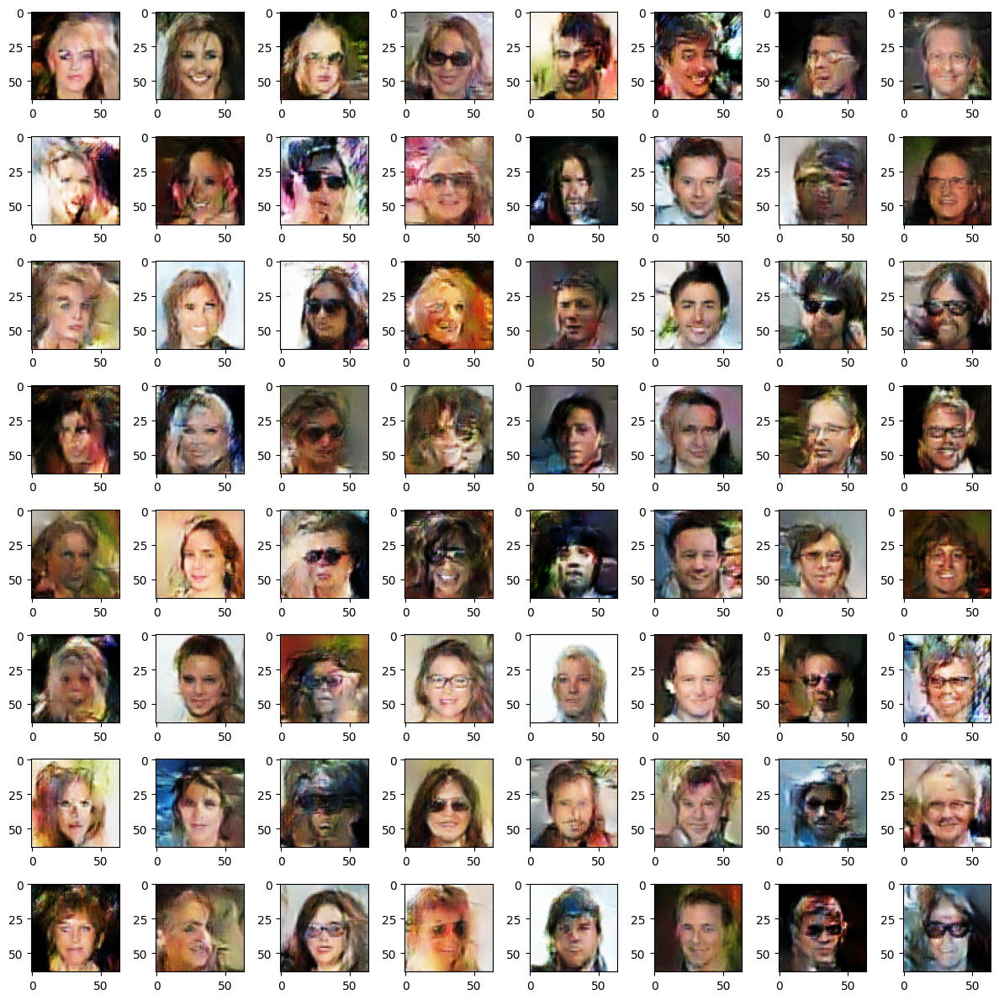


epoch 1297/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5684 | g_loss: 1.5124 | val_attr_acc: 0.9371

epoch 1298/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5744 | g_loss: 1.5039 | val_attr_acc: 0.9329

epoch 1299/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5772 | g_loss: 1.4929 | val_attr_acc: 0.9326

epoch 1300/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5775 | g_loss: 1.4978 | val_attr_acc: 0.9264

epoch 1301/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5743 | g_loss: 1.5038 | val_attr_acc: 0.9267

epoch 1302/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5756 | g_loss: 1.4953 | val_attr_acc: 0.9381

epoch 1303/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5709 | g_loss: 1.5055 | val_attr_acc: 0.9368

epoch 1304/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5777 | g_loss: 1.4980 | val_attr_acc: 0.9351

epoch 1305/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5788 | g_loss: 1.5037 | val_attr_acc: 0.9394

epoch 1306/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5770 | g_loss: 1.4905 | val_attr_acc: 0.9326

epoch 1307/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5841 | g_loss: 1.4970 | val_attr_acc: 0.9309

epoch 1308/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5781 | g_loss: 1.5013 | val_attr_acc: 0.9348

epoch 1309/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5761 | g_loss: 1.5019 | val_attr_acc: 0.9413

epoch 1310/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5776 | g_loss: 1.4962 | val_attr_acc: 0.9433

epoch 1311/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5780 | g_loss: 1.4893 | val_attr_acc: 0.9264

epoch 1312/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5808 | g_loss: 1.5023 | val_attr_acc: 0.9358

epoch 1313/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5765 | g_loss: 1.4880 | val_attr_acc: 0.9384

epoch 1314/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9361
d_loss: 0.5694 | g_loss: 1.5044 | val_attr_acc: 0.9374

epoch 1315/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5768 | g_loss: 1.5020 | val_attr_acc: 0.9429

epoch 1316/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5750 | g_loss: 1.4989 | val_attr_acc: 0.9264

epoch 1317/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5795 | g_loss: 1.4932 | val_attr_acc: 0.9345

epoch 1318/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5761 | g_loss: 1.4983 | val_attr_acc: 0.9397

epoch 1319/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9359
d_loss: 0.5712 | g_loss: 1.5043 | val_attr_acc: 0.9371

epoch 1320/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9359
d_loss: 0.5736 | g_loss: 1.5013 | val_attr_acc: 0.9322

epoch 1321/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5735 | g_loss: 1.5012 | val_attr_acc: 0.9293

epoch 1322/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5734 | g_loss: 1.5001 | val_attr_acc: 0.9339

epoch 1323/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5766 | g_loss: 1.4931 | val_attr_acc: 0.9306

epoch 1324/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5767 | g_loss: 1.4924 | val_attr_acc: 0.9316

epoch 1325/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5726 | g_loss: 1.5066 | val_attr_acc: 0.9397

epoch 1326/1620 - lr: 0.000031


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
reduced lr to 0.000016
d_loss: 0.5774 | g_loss: 1.4907 | val_attr_acc: 0.9397

epoch 1327/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5747 | g_loss: 1.5048 | val_attr_acc: 0.9283

epoch 1328/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5721 | g_loss: 1.5034 | val_attr_acc: 0.9374

epoch 1329/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5824 | g_loss: 1.4895 | val_attr_acc: 0.9355

epoch 1330/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5732 | g_loss: 1.5064 | val_attr_acc: 0.9397

epoch 1331/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5748 | g_loss: 1.4964 | val_attr_acc: 0.9381

epoch 1332/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5733 | g_loss: 1.5019 | val_attr_acc: 0.9329

epoch 1333/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5735 | g_loss: 1.4988 | val_attr_acc: 0.9410

epoch 1334/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5711 | g_loss: 1.5028 | val_attr_acc: 0.9283

epoch 1335/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5825 | g_loss: 1.4846 | val_attr_acc: 0.9319

epoch 1336/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5730 | g_loss: 1.5045 | val_attr_acc: 0.9280

epoch 1337/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5751 | g_loss: 1.5071 | val_attr_acc: 0.9394

epoch 1338/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5763 | g_loss: 1.4964 | val_attr_acc: 0.9374

epoch 1339/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5766 | g_loss: 1.5004 | val_attr_acc: 0.9329

epoch 1340/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9336
d_loss: 0.5738 | g_loss: 1.5010 | val_attr_acc: 0.9332

epoch 1341/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5750 | g_loss: 1.4958 | val_attr_acc: 0.9368

epoch 1342/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5791 | g_loss: 1.4934 | val_attr_acc: 0.9319

epoch 1343/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5787 | g_loss: 1.5034 | val_attr_acc: 0.9335

epoch 1344/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5765 | g_loss: 1.5026 | val_attr_acc: 0.9381

epoch 1345/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5719 | g_loss: 1.5013 | val_attr_acc: 0.9322

epoch 1346/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5796 | g_loss: 1.4988 | val_attr_acc: 0.9342

epoch 1347/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9336
d_loss: 0.5767 | g_loss: 1.4999 | val_attr_acc: 0.9313

epoch 1348/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5745 | g_loss: 1.5013 | val_attr_acc: 0.9329

epoch 1349/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5819 | g_loss: 1.4883 | val_attr_acc: 0.9394

epoch 1350/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5779 | g_loss: 1.4981 | val_attr_acc: 0.9351

epoch 1351/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5795 | g_loss: 1.4851 | val_attr_acc: 0.9303

epoch 1352/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5757 | g_loss: 1.4985 | val_attr_acc: 0.9342

epoch 1353/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9337
d_loss: 0.5772 | g_loss: 1.5123 | val_attr_acc: 0.9303

epoch 1354/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5756 | g_loss: 1.5022 | val_attr_acc: 0.9384

epoch 1355/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5731 | g_loss: 1.4945 | val_attr_acc: 0.9374

epoch 1356/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5789 | g_loss: 1.4866 | val_attr_acc: 0.9303

epoch 1357/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5817 | g_loss: 1.4919 | val_attr_acc: 0.9244

epoch 1358/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5748 | g_loss: 1.4974 | val_attr_acc: 0.9300

epoch 1359/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5790 | g_loss: 1.4948 | val_attr_acc: 0.9358

epoch 1360/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5758 | g_loss: 1.5006 | val_attr_acc: 0.9374

epoch 1361/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5735 | g_loss: 1.5005 | val_attr_acc: 0.9270

epoch 1362/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5736 | g_loss: 1.5031 | val_attr_acc: 0.9390

epoch 1363/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5782 | g_loss: 1.4965 | val_attr_acc: 0.9374

epoch 1364/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5781 | g_loss: 1.5032 | val_attr_acc: 0.9300

epoch 1365/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9362
d_loss: 0.5713 | g_loss: 1.5046 | val_attr_acc: 0.9322

epoch 1366/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5745 | g_loss: 1.5036 | val_attr_acc: 0.9332

epoch 1367/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5793 | g_loss: 1.4906 | val_attr_acc: 0.9309

epoch 1368/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5742 | g_loss: 1.4909 | val_attr_acc: 0.9368

epoch 1369/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5742 | g_loss: 1.5076 | val_attr_acc: 0.9316

epoch 1370/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5813 | g_loss: 1.4980 | val_attr_acc: 0.9403

epoch 1371/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5788 | g_loss: 1.4901 | val_attr_acc: 0.9339

epoch 1372/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5766 | g_loss: 1.4966 | val_attr_acc: 0.9371

epoch 1373/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5795 | g_loss: 1.4939 | val_attr_acc: 0.9355

epoch 1374/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5754 | g_loss: 1.5001 | val_attr_acc: 0.9394

epoch 1375/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5749 | g_loss: 1.5038 | val_attr_acc: 0.9413

epoch 1376/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5797 | g_loss: 1.4942 | val_attr_acc: 0.9381

epoch 1377/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5746 | g_loss: 1.4984 | val_attr_acc: 0.9342

epoch 1378/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5734 | g_loss: 1.4986 | val_attr_acc: 0.9390

epoch 1379/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5719 | g_loss: 1.5132 | val_attr_acc: 0.9339

epoch 1380/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5735 | g_loss: 1.4981 | val_attr_acc: 0.9335

epoch 1381/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5781 | g_loss: 1.4981 | val_attr_acc: 0.9387

epoch 1382/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5796 | g_loss: 1.4914 | val_attr_acc: 0.9296

epoch 1383/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5705 | g_loss: 1.5011 | val_attr_acc: 0.9342

epoch 1384/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5723 | g_loss: 1.5147 | val_attr_acc: 0.9303

epoch 1385/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9359
d_loss: 0.5717 | g_loss: 1.4954 | val_attr_acc: 0.9293

epoch 1386/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5710 | g_loss: 1.4950 | val_attr_acc: 0.9335

epoch 1387/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5771 | g_loss: 1.4902 | val_attr_acc: 0.9322

epoch 1388/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5759 | g_loss: 1.4984 | val_attr_acc: 0.9364

epoch 1389/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5747 | g_loss: 1.4932 | val_attr_acc: 0.9225

epoch 1390/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5790 | g_loss: 1.4926 | val_attr_acc: 0.9394

epoch 1391/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5766 | g_loss: 1.5050 | val_attr_acc: 0.9264

epoch 1392/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9339
d_loss: 0.5741 | g_loss: 1.5013 | val_attr_acc: 0.9361

epoch 1393/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5817 | g_loss: 1.4808 | val_attr_acc: 0.9342

epoch 1394/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5781 | g_loss: 1.5042 | val_attr_acc: 0.9361

epoch 1395/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5739 | g_loss: 1.5046 | val_attr_acc: 0.9335

epoch 1396/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5741 | g_loss: 1.4989 | val_attr_acc: 0.9283

epoch 1397/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9356
d_loss: 0.5780 | g_loss: 1.5087 | val_attr_acc: 0.9339

epoch 1398/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5754 | g_loss: 1.4995 | val_attr_acc: 0.9316

epoch 1399/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5788 | g_loss: 1.5016 | val_attr_acc: 0.9319

epoch 1400/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9356
d_loss: 0.5792 | g_loss: 1.4983 | val_attr_acc: 0.9384

epoch 1401/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5800 | g_loss: 1.4929 | val_attr_acc: 0.9410

epoch 1402/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5750 | g_loss: 1.4949 | val_attr_acc: 0.9364

epoch 1403/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5799 | g_loss: 1.4877 | val_attr_acc: 0.9345

epoch 1404/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5749 | g_loss: 1.4969 | val_attr_acc: 0.9390

epoch 1405/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5760 | g_loss: 1.4980 | val_attr_acc: 0.9358

epoch 1406/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9356
d_loss: 0.5744 | g_loss: 1.4989 | val_attr_acc: 0.9329

epoch 1407/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5727 | g_loss: 1.5058 | val_attr_acc: 0.9381

epoch 1408/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5733 | g_loss: 1.5087 | val_attr_acc: 0.9410

epoch 1409/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5764 | g_loss: 1.5006 | val_attr_acc: 0.9296

epoch 1410/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5822 | g_loss: 1.4940 | val_attr_acc: 0.9348

epoch 1411/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9359
d_loss: 0.5738 | g_loss: 1.4992 | val_attr_acc: 0.9403

epoch 1412/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9359
d_loss: 0.5740 | g_loss: 1.5041 | val_attr_acc: 0.9364

epoch 1413/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5808 | g_loss: 1.4948 | val_attr_acc: 0.9381

epoch 1414/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5734 | g_loss: 1.4936 | val_attr_acc: 0.9342

epoch 1415/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5770 | g_loss: 1.4997 | val_attr_acc: 0.9390

epoch 1416/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5764 | g_loss: 1.5048 | val_attr_acc: 0.9384

epoch 1417/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5779 | g_loss: 1.4925 | val_attr_acc: 0.9381

epoch 1418/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9356
d_loss: 0.5754 | g_loss: 1.4978 | val_attr_acc: 0.9371

epoch 1419/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5749 | g_loss: 1.5052 | val_attr_acc: 0.9303

epoch 1420/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5738 | g_loss: 1.5054 | val_attr_acc: 0.9342

epoch 1421/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5774 | g_loss: 1.4993 | val_attr_acc: 0.9313

epoch 1422/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5792 | g_loss: 1.4922 | val_attr_acc: 0.9348

epoch 1423/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5786 | g_loss: 1.4934 | val_attr_acc: 0.9313

epoch 1424/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5778 | g_loss: 1.4993 | val_attr_acc: 0.9313

epoch 1425/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5747 | g_loss: 1.4965 | val_attr_acc: 0.9368

epoch 1426/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5795 | g_loss: 1.4919 | val_attr_acc: 0.9306

epoch 1427/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5815 | g_loss: 1.4865 | val_attr_acc: 0.9319

epoch 1428/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5738 | g_loss: 1.4938 | val_attr_acc: 0.9384

epoch 1429/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5737 | g_loss: 1.5025 | val_attr_acc: 0.9313

epoch 1430/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5751 | g_loss: 1.5045 | val_attr_acc: 0.9335

epoch 1431/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5761 | g_loss: 1.4943 | val_attr_acc: 0.9351

epoch 1432/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5782 | g_loss: 1.4996 | val_attr_acc: 0.9358

epoch 1433/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5733 | g_loss: 1.4991 | val_attr_acc: 0.9429

epoch 1434/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5781 | g_loss: 1.4941 | val_attr_acc: 0.9410

epoch 1435/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5754 | g_loss: 1.5042 | val_attr_acc: 0.9384

epoch 1436/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5808 | g_loss: 1.4987 | val_attr_acc: 0.9358

epoch 1437/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5777 | g_loss: 1.4954 | val_attr_acc: 0.9348

epoch 1438/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5761 | g_loss: 1.4987 | val_attr_acc: 0.9452

epoch 1439/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5801 | g_loss: 1.4893 | val_attr_acc: 0.9316

epoch 1440/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5748 | g_loss: 1.5061 | val_attr_acc: 0.9394

epoch 1441/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5749 | g_loss: 1.5134 | val_attr_acc: 0.9303

epoch 1442/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5772 | g_loss: 1.4934 | val_attr_acc: 0.9264

epoch 1443/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5808 | g_loss: 1.4974 | val_attr_acc: 0.9345

epoch 1444/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5767 | g_loss: 1.4964 | val_attr_acc: 0.9400

epoch 1445/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5779 | g_loss: 1.5025 | val_attr_acc: 0.9322

epoch 1446/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5751 | g_loss: 1.4915 | val_attr_acc: 0.9381

epoch 1447/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5799 | g_loss: 1.4921 | val_attr_acc: 0.9390

epoch 1448/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5781 | g_loss: 1.4923 | val_attr_acc: 0.9339

epoch 1449/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5715 | g_loss: 1.4957 | val_attr_acc: 0.9264

epoch 1450/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5785 | g_loss: 1.4932 | val_attr_acc: 0.9306

epoch 1451/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5772 | g_loss: 1.4986 | val_attr_acc: 0.9394

epoch 1452/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5774 | g_loss: 1.4966 | val_attr_acc: 0.9355

epoch 1453/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9356
d_loss: 0.5780 | g_loss: 1.4951 | val_attr_acc: 0.9381

epoch 1454/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5748 | g_loss: 1.5018 | val_attr_acc: 0.9313

epoch 1455/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5801 | g_loss: 1.4942 | val_attr_acc: 0.9358

epoch 1456/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5735 | g_loss: 1.4987 | val_attr_acc: 0.9342

epoch 1457/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5753 | g_loss: 1.5020 | val_attr_acc: 0.9319

epoch 1458/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5785 | g_loss: 1.4937 | val_attr_acc: 0.9296


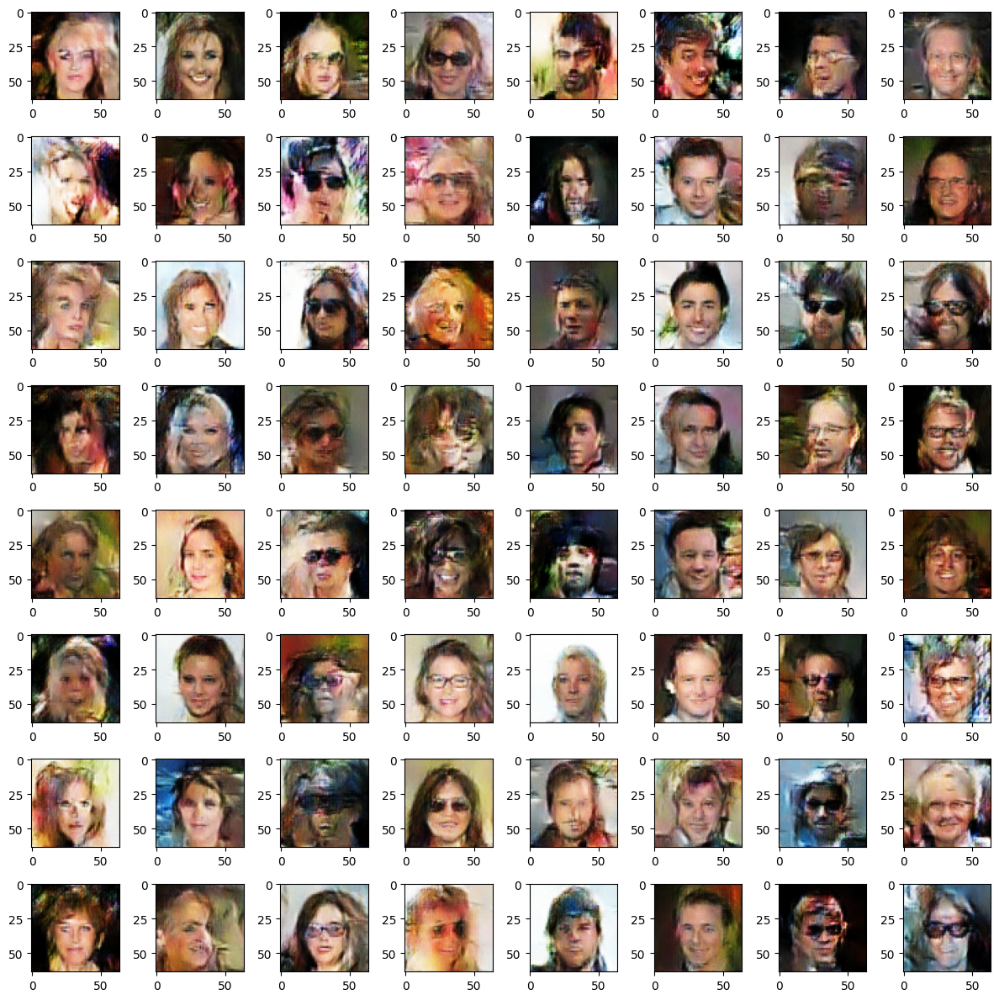


epoch 1459/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5742 | g_loss: 1.4997 | val_attr_acc: 0.9394

epoch 1460/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5729 | g_loss: 1.5043 | val_attr_acc: 0.9345

epoch 1461/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5751 | g_loss: 1.4954 | val_attr_acc: 0.9381

epoch 1462/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5786 | g_loss: 1.4966 | val_attr_acc: 0.9322

epoch 1463/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5751 | g_loss: 1.5014 | val_attr_acc: 0.9384

epoch 1464/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5760 | g_loss: 1.5041 | val_attr_acc: 0.9348

epoch 1465/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5777 | g_loss: 1.4941 | val_attr_acc: 0.9309

epoch 1466/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5724 | g_loss: 1.4952 | val_attr_acc: 0.9316

epoch 1467/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5719 | g_loss: 1.5001 | val_attr_acc: 0.9264

epoch 1468/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5765 | g_loss: 1.4998 | val_attr_acc: 0.9296

epoch 1469/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5831 | g_loss: 1.4872 | val_attr_acc: 0.9361

epoch 1470/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5750 | g_loss: 1.4976 | val_attr_acc: 0.9280

epoch 1471/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5777 | g_loss: 1.4972 | val_attr_acc: 0.9355

epoch 1472/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5763 | g_loss: 1.5101 | val_attr_acc: 0.9313

epoch 1473/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5768 | g_loss: 1.4923 | val_attr_acc: 0.9358

epoch 1474/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5764 | g_loss: 1.5042 | val_attr_acc: 0.9244

epoch 1475/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5723 | g_loss: 1.5033 | val_attr_acc: 0.9303

epoch 1476/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5765 | g_loss: 1.4974 | val_attr_acc: 0.9300

epoch 1477/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5776 | g_loss: 1.4992 | val_attr_acc: 0.9368

epoch 1478/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5807 | g_loss: 1.5010 | val_attr_acc: 0.9351

epoch 1479/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5719 | g_loss: 1.5124 | val_attr_acc: 0.9322

epoch 1480/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5762 | g_loss: 1.4974 | val_attr_acc: 0.9335

epoch 1481/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5751 | g_loss: 1.4901 | val_attr_acc: 0.9423

epoch 1482/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5745 | g_loss: 1.5141 | val_attr_acc: 0.9319

epoch 1483/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5752 | g_loss: 1.5057 | val_attr_acc: 0.9348

epoch 1484/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5804 | g_loss: 1.4856 | val_attr_acc: 0.9290

epoch 1485/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5774 | g_loss: 1.5001 | val_attr_acc: 0.9319

epoch 1486/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5724 | g_loss: 1.5097 | val_attr_acc: 0.9348

epoch 1487/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5775 | g_loss: 1.4994 | val_attr_acc: 0.9371

epoch 1488/1620 - lr: 0.000016


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
reduced lr to 0.000008
d_loss: 0.5756 | g_loss: 1.4959 | val_attr_acc: 0.9374

epoch 1489/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5728 | g_loss: 1.4984 | val_attr_acc: 0.9364

epoch 1490/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5800 | g_loss: 1.4911 | val_attr_acc: 0.9332

epoch 1491/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5836 | g_loss: 1.4923 | val_attr_acc: 0.9322

epoch 1492/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5740 | g_loss: 1.5000 | val_attr_acc: 0.9290

epoch 1493/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5728 | g_loss: 1.5067 | val_attr_acc: 0.9300

epoch 1494/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5753 | g_loss: 1.5064 | val_attr_acc: 0.9322

epoch 1495/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5762 | g_loss: 1.4956 | val_attr_acc: 0.9377

epoch 1496/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5794 | g_loss: 1.4928 | val_attr_acc: 0.9387

epoch 1497/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5759 | g_loss: 1.5005 | val_attr_acc: 0.9407

epoch 1498/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5780 | g_loss: 1.4935 | val_attr_acc: 0.9377

epoch 1499/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5825 | g_loss: 1.4972 | val_attr_acc: 0.9319

epoch 1500/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5760 | g_loss: 1.4928 | val_attr_acc: 0.9335

epoch 1501/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5806 | g_loss: 1.4954 | val_attr_acc: 0.9339

epoch 1502/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5756 | g_loss: 1.5010 | val_attr_acc: 0.9400

epoch 1503/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5758 | g_loss: 1.4959 | val_attr_acc: 0.9309

epoch 1504/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5770 | g_loss: 1.4997 | val_attr_acc: 0.9371

epoch 1505/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5758 | g_loss: 1.4999 | val_attr_acc: 0.9306

epoch 1506/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5771 | g_loss: 1.5061 | val_attr_acc: 0.9374

epoch 1507/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5756 | g_loss: 1.5050 | val_attr_acc: 0.9403

epoch 1508/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5796 | g_loss: 1.4962 | val_attr_acc: 0.9361

epoch 1509/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5770 | g_loss: 1.4973 | val_attr_acc: 0.9381

epoch 1510/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5801 | g_loss: 1.4972 | val_attr_acc: 0.9410

epoch 1511/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9338
d_loss: 0.5777 | g_loss: 1.5012 | val_attr_acc: 0.9300

epoch 1512/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5771 | g_loss: 1.4953 | val_attr_acc: 0.9351

epoch 1513/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5719 | g_loss: 1.4999 | val_attr_acc: 0.9232

epoch 1514/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5728 | g_loss: 1.5009 | val_attr_acc: 0.9416

epoch 1515/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5807 | g_loss: 1.4893 | val_attr_acc: 0.9303

epoch 1516/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5726 | g_loss: 1.5077 | val_attr_acc: 0.9358

epoch 1517/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5775 | g_loss: 1.4936 | val_attr_acc: 0.9387

epoch 1518/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5818 | g_loss: 1.4898 | val_attr_acc: 0.9348

epoch 1519/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5738 | g_loss: 1.4978 | val_attr_acc: 0.9342

epoch 1520/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5761 | g_loss: 1.4945 | val_attr_acc: 0.9322

epoch 1521/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5787 | g_loss: 1.4951 | val_attr_acc: 0.9319

epoch 1522/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9340
d_loss: 0.5776 | g_loss: 1.4964 | val_attr_acc: 0.9355

epoch 1523/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5751 | g_loss: 1.4981 | val_attr_acc: 0.9433

epoch 1524/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5793 | g_loss: 1.4978 | val_attr_acc: 0.9348

epoch 1525/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5767 | g_loss: 1.4990 | val_attr_acc: 0.9270

epoch 1526/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5811 | g_loss: 1.4914 | val_attr_acc: 0.9364

epoch 1527/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5734 | g_loss: 1.5070 | val_attr_acc: 0.9332

epoch 1528/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9356
d_loss: 0.5752 | g_loss: 1.4971 | val_attr_acc: 0.9322

epoch 1529/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5750 | g_loss: 1.4963 | val_attr_acc: 0.9303

epoch 1530/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5762 | g_loss: 1.4951 | val_attr_acc: 0.9348

epoch 1531/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5783 | g_loss: 1.4956 | val_attr_acc: 0.9364

epoch 1532/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5768 | g_loss: 1.4910 | val_attr_acc: 0.9329

epoch 1533/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5704 | g_loss: 1.5035 | val_attr_acc: 0.9381

epoch 1534/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9356
d_loss: 0.5766 | g_loss: 1.4995 | val_attr_acc: 0.9313

epoch 1535/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5756 | g_loss: 1.4953 | val_attr_acc: 0.9355

epoch 1536/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5755 | g_loss: 1.4991 | val_attr_acc: 0.9313

epoch 1537/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5758 | g_loss: 1.5026 | val_attr_acc: 0.9313

epoch 1538/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5742 | g_loss: 1.5022 | val_attr_acc: 0.9290

epoch 1539/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5760 | g_loss: 1.4992 | val_attr_acc: 0.9274

epoch 1540/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5767 | g_loss: 1.4951 | val_attr_acc: 0.9377

epoch 1541/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5789 | g_loss: 1.4996 | val_attr_acc: 0.9257

epoch 1542/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5745 | g_loss: 1.4990 | val_attr_acc: 0.9332

epoch 1543/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5812 | g_loss: 1.4907 | val_attr_acc: 0.9384

epoch 1544/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5745 | g_loss: 1.5073 | val_attr_acc: 0.9368

epoch 1545/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5768 | g_loss: 1.4938 | val_attr_acc: 0.9235

epoch 1546/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5759 | g_loss: 1.4997 | val_attr_acc: 0.9322

epoch 1547/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5767 | g_loss: 1.5054 | val_attr_acc: 0.9316

epoch 1548/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5776 | g_loss: 1.4933 | val_attr_acc: 0.9241

epoch 1549/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5773 | g_loss: 1.4953 | val_attr_acc: 0.9335

epoch 1550/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5755 | g_loss: 1.4934 | val_attr_acc: 0.9361

epoch 1551/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5770 | g_loss: 1.4907 | val_attr_acc: 0.9364

epoch 1552/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5713 | g_loss: 1.5048 | val_attr_acc: 0.9377

epoch 1553/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5735 | g_loss: 1.5047 | val_attr_acc: 0.9306

epoch 1554/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9359
d_loss: 0.5758 | g_loss: 1.4964 | val_attr_acc: 0.9465

epoch 1555/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5803 | g_loss: 1.4968 | val_attr_acc: 0.9381

epoch 1556/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5756 | g_loss: 1.5081 | val_attr_acc: 0.9351

epoch 1557/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5733 | g_loss: 1.5099 | val_attr_acc: 0.9339

epoch 1558/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5712 | g_loss: 1.4969 | val_attr_acc: 0.9306

epoch 1559/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5814 | g_loss: 1.4932 | val_attr_acc: 0.9368

epoch 1560/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5775 | g_loss: 1.4891 | val_attr_acc: 0.9274

epoch 1561/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5734 | g_loss: 1.4995 | val_attr_acc: 0.9358

epoch 1562/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5820 | g_loss: 1.4886 | val_attr_acc: 0.9332

epoch 1563/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5790 | g_loss: 1.4921 | val_attr_acc: 0.9322

epoch 1564/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5749 | g_loss: 1.5100 | val_attr_acc: 0.9358

epoch 1565/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5799 | g_loss: 1.4937 | val_attr_acc: 0.9342

epoch 1566/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5785 | g_loss: 1.4988 | val_attr_acc: 0.9390

epoch 1567/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5773 | g_loss: 1.4981 | val_attr_acc: 0.9407

epoch 1568/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5800 | g_loss: 1.5000 | val_attr_acc: 0.9361

epoch 1569/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5748 | g_loss: 1.5044 | val_attr_acc: 0.9316

epoch 1570/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5734 | g_loss: 1.4942 | val_attr_acc: 0.9290

epoch 1571/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5768 | g_loss: 1.5000 | val_attr_acc: 0.9368

epoch 1572/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5750 | g_loss: 1.5058 | val_attr_acc: 0.9351

epoch 1573/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9356
d_loss: 0.5756 | g_loss: 1.4933 | val_attr_acc: 0.9368

epoch 1574/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5824 | g_loss: 1.4875 | val_attr_acc: 0.9410

epoch 1575/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5758 | g_loss: 1.4986 | val_attr_acc: 0.9326

epoch 1576/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5780 | g_loss: 1.4955 | val_attr_acc: 0.9309

epoch 1577/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5763 | g_loss: 1.4962 | val_attr_acc: 0.9287

epoch 1578/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5740 | g_loss: 1.5059 | val_attr_acc: 0.9319

epoch 1579/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5769 | g_loss: 1.4967 | val_attr_acc: 0.9358

epoch 1580/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5755 | g_loss: 1.4990 | val_attr_acc: 0.9358

epoch 1581/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9355
d_loss: 0.5757 | g_loss: 1.4981 | val_attr_acc: 0.9394

epoch 1582/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5807 | g_loss: 1.4915 | val_attr_acc: 0.9400

epoch 1583/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9349
d_loss: 0.5796 | g_loss: 1.5016 | val_attr_acc: 0.9329

epoch 1584/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5796 | g_loss: 1.4889 | val_attr_acc: 0.9329

epoch 1585/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5796 | g_loss: 1.4922 | val_attr_acc: 0.9313

epoch 1586/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5751 | g_loss: 1.5018 | val_attr_acc: 0.9274

epoch 1587/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9343
d_loss: 0.5734 | g_loss: 1.5079 | val_attr_acc: 0.9407

epoch 1588/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5745 | g_loss: 1.4971 | val_attr_acc: 0.9429

epoch 1589/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9339
d_loss: 0.5766 | g_loss: 1.5017 | val_attr_acc: 0.9387

epoch 1590/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5754 | g_loss: 1.5063 | val_attr_acc: 0.9374

epoch 1591/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5757 | g_loss: 1.4917 | val_attr_acc: 0.9342

epoch 1592/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5786 | g_loss: 1.5051 | val_attr_acc: 0.9403

epoch 1593/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5751 | g_loss: 1.5037 | val_attr_acc: 0.9339

epoch 1594/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5802 | g_loss: 1.5014 | val_attr_acc: 0.9322

epoch 1595/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5761 | g_loss: 1.4981 | val_attr_acc: 0.9358

epoch 1596/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5778 | g_loss: 1.4979 | val_attr_acc: 0.9329

epoch 1597/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5819 | g_loss: 1.4940 | val_attr_acc: 0.9358

epoch 1598/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9357
d_loss: 0.5729 | g_loss: 1.4942 | val_attr_acc: 0.9384

epoch 1599/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9341
d_loss: 0.5798 | g_loss: 1.4952 | val_attr_acc: 0.9371

epoch 1600/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5735 | g_loss: 1.4969 | val_attr_acc: 0.9355

epoch 1601/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5715 | g_loss: 1.5139 | val_attr_acc: 0.9296

epoch 1602/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9348
d_loss: 0.5721 | g_loss: 1.5140 | val_attr_acc: 0.9345

epoch 1603/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9344
d_loss: 0.5811 | g_loss: 1.4877 | val_attr_acc: 0.9410

epoch 1604/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9353
d_loss: 0.5826 | g_loss: 1.4926 | val_attr_acc: 0.9436

epoch 1605/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5779 | g_loss: 1.5018 | val_attr_acc: 0.9322

epoch 1606/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5794 | g_loss: 1.4958 | val_attr_acc: 0.9313

epoch 1607/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9352
d_loss: 0.5726 | g_loss: 1.4966 | val_attr_acc: 0.9296

epoch 1608/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9354
d_loss: 0.5823 | g_loss: 1.4957 | val_attr_acc: 0.9403

epoch 1609/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5830 | g_loss: 1.4903 | val_attr_acc: 0.9322

epoch 1610/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5741 | g_loss: 1.4999 | val_attr_acc: 0.9397

epoch 1611/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9342
d_loss: 0.5749 | g_loss: 1.5039 | val_attr_acc: 0.9410

epoch 1612/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9347
d_loss: 0.5810 | g_loss: 1.5074 | val_attr_acc: 0.9280

epoch 1613/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5773 | g_loss: 1.4958 | val_attr_acc: 0.9290

epoch 1614/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5772 | g_loss: 1.4954 | val_attr_acc: 0.9351

epoch 1615/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9359
d_loss: 0.5777 | g_loss: 1.4934 | val_attr_acc: 0.9322

epoch 1616/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9345
d_loss: 0.5782 | g_loss: 1.4938 | val_attr_acc: 0.9374

epoch 1617/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9351
d_loss: 0.5766 | g_loss: 1.4922 | val_attr_acc: 0.9390

epoch 1618/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9346
d_loss: 0.5717 | g_loss: 1.5028 | val_attr_acc: 0.9342

epoch 1619/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5753 | g_loss: 1.4988 | val_attr_acc: 0.9351

epoch 1620/1620 - lr: 0.000008


training:   0%|          | 0/145 [00:00<?, ?it/s]

train_attr_acc: 0.9350
d_loss: 0.5774 | g_loss: 1.4995 | val_attr_acc: 0.9420


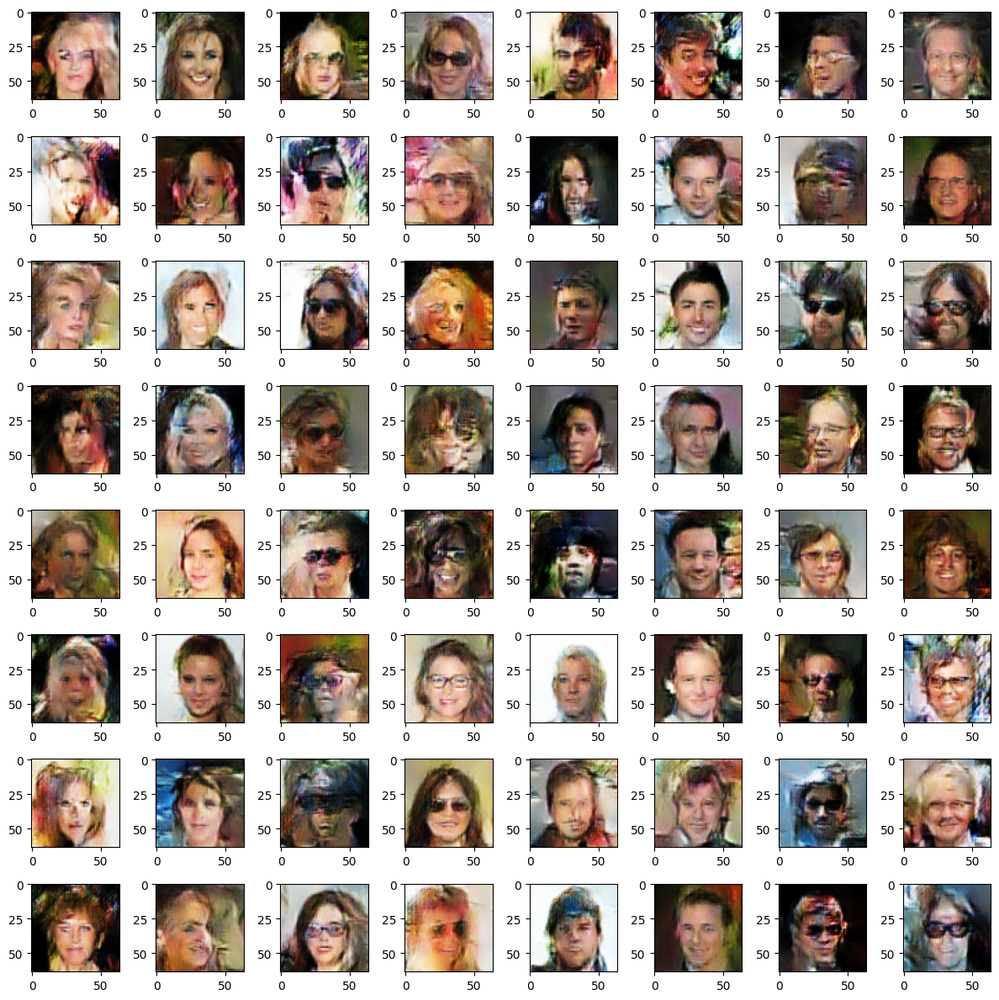

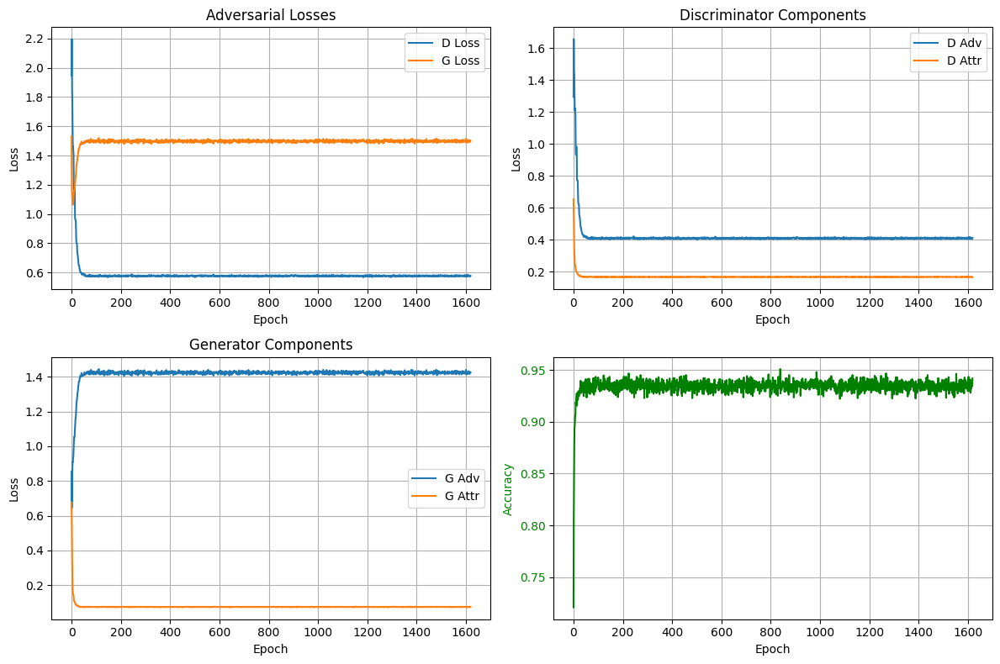


computing confusion matrices...


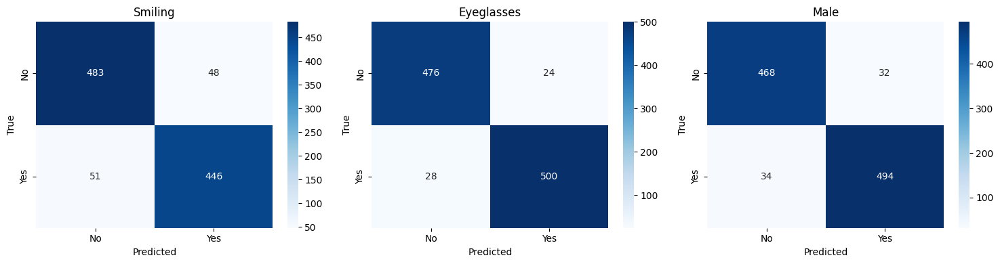


classification report:

Smiling:
              precision    recall  f1-score   support

          No     0.9045    0.9096    0.9070       531
         Yes     0.9028    0.8974    0.9001       497

    accuracy                         0.9037      1028
   macro avg     0.9037    0.9035    0.9036      1028
weighted avg     0.9037    0.9037    0.9037      1028


Eyeglasses:
              precision    recall  f1-score   support

          No     0.9444    0.9520    0.9482       500
         Yes     0.9542    0.9470    0.9506       528

    accuracy                         0.9494      1028
   macro avg     0.9493    0.9495    0.9494      1028
weighted avg     0.9495    0.9494    0.9494      1028


Male:
              precision    recall  f1-score   support

          No     0.9323    0.9360    0.9341       500
         Yes     0.9392    0.9356    0.9374       528

    accuracy                         0.9358      1028
   macro avg     0.9357    0.9358    0.9358      1028
weighted avg     0.9

In [12]:
# cell 12: main training loop
for epoch in range(start_epoch, CONFIG["epochs"] + 1):
    ckpt.epoch.assign(epoch)

    # reset metrics
    train_d_loss.reset_state()
    train_g_loss.reset_state()
    train_d_adv.reset_state()
    train_d_attr.reset_state()
    train_g_adv.reset_state()
    train_g_attr.reset_state()

    # training loop
    new_lr = opt_d_inner.learning_rate.numpy()
    print(f"\nepoch {epoch}/{CONFIG['epochs']} - lr: {new_lr:.6f}")
    pbar = tqdm(train_ds, desc=f"training")

    for step, (imgs, attrs) in enumerate(pbar):
        for _ in range(3): # train d 3 times per g update
            losses = train_step(imgs, attrs)

            _, train_attr_pred = discriminator([imgs, attrs], training=False)
            train_attr_acc.update_state(attrs, train_attr_pred)

            # update metrics
            train_d_loss.update_state(losses["d_loss"])
            train_g_loss.update_state(losses["g_loss"])
            train_d_adv.update_state(losses["d_adv"])
            train_d_attr.update_state(losses["d_attr"])
            train_g_adv.update_state(losses["g_adv"])
            train_g_attr.update_state(losses["g_attr"])

        # update progress bar
        pbar.set_postfix(
            {
                "d": f"{train_d_loss.result().numpy():.4f}",
                "g": f"{train_g_loss.result().numpy():.4f}",
            }
        )

    print(f"train_attr_acc: {train_attr_acc.result().numpy():.4f}")
    train_attr_acc.reset_state()

    # compute validation attribute accuracy
    val_attr_acc.reset_state()
    for v_imgs, v_attrs in val_ds:
        _, v_pred = discriminator([v_imgs, v_attrs], training=False)
        val_attr_acc.update_state(v_attrs, v_pred)

    # save best model by val accuracy
    current_acc = val_attr_acc.result().numpy()
    if current_acc > best_val_acc:
        best_val_acc = current_acc
        patience_counter = 0
        plateau_counter = 0
        manager.save()
        print(f"new best val_acc: {best_val_acc:.4f}")
    else:
        patience_counter += 1
        plateau_counter += 1
    
    # reduce lr on plateau
    if plateau_counter >= plateau_patience:
        new_lr = opt_d_inner.learning_rate.numpy() * 0.5
        opt_d_inner.learning_rate.assign(new_lr)
        opt_g_inner.learning_rate.assign(new_lr)
        print(f"reduced lr to {new_lr:.6f}")
        plateau_counter = 0
    
    # early stopping
    if patience_counter >= patience:
        print(f"early stopping: no improvement for {patience} epochs")
        break
    
    # store history
    history["d_loss"].append(train_d_loss.result().numpy())
    history["g_loss"].append(train_g_loss.result().numpy())
    history["d_adv"].append(train_d_adv.result().numpy())
    history["d_attr"].append(train_d_attr.result().numpy())
    history["g_adv"].append(train_g_adv.result().numpy())
    history["g_attr"].append(train_g_attr.result().numpy())
    history["val_attr_acc"].append(val_attr_acc.result().numpy())
    history["train_attr_acc"].append(train_attr_acc.result().numpy())

    # print epoch summary
    print(
        f"d_loss: {train_d_loss.result().numpy():.4f} | "
        f"g_loss: {train_g_loss.result().numpy():.4f} | "
        f"val_attr_acc: {val_attr_acc.result().numpy():.4f}"
    )

    # generate and display samples every n epochs
    if epoch % 162 == 0 or epoch == CONFIG['epochs']:
        gen_imgs = generator([fixed_z, fixed_attrs], training=False).numpy()
        plot_generated_samples(gen_imgs, epoch, nrow=8)

    # plot losses only at final epoch
    if epoch == CONFIG['epochs']:
        plot_losses(history, epoch)

        # compute confusion matrices
        print("\ncomputing confusion matrices...")
        compute_confusion_matrices(val_ds, discriminator)

print("\ntraining complete!")

loading best checkpoint...
restored from: /kaggle/working/checkpoints/ckpt-27

final confusion matrices on validation set:


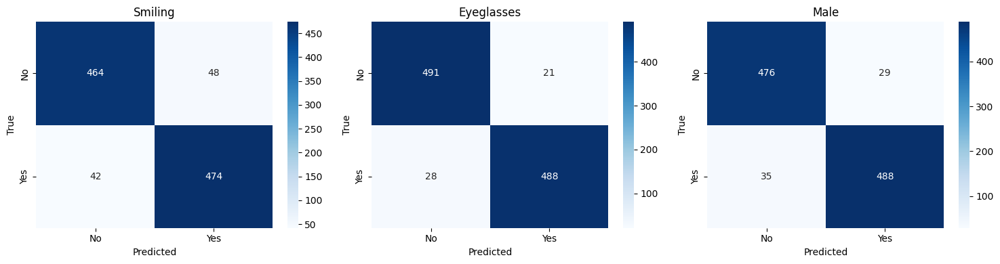


classification report:

Smiling:
              precision    recall  f1-score   support

          No     0.9170    0.9062    0.9116       512
         Yes     0.9080    0.9186    0.9133       516

    accuracy                         0.9125      1028
   macro avg     0.9125    0.9124    0.9124      1028
weighted avg     0.9125    0.9125    0.9124      1028


Eyeglasses:
              precision    recall  f1-score   support

          No     0.9461    0.9590    0.9525       512
         Yes     0.9587    0.9457    0.9522       516

    accuracy                         0.9523      1028
   macro avg     0.9524    0.9524    0.9523      1028
weighted avg     0.9524    0.9523    0.9523      1028


Male:
              precision    recall  f1-score   support

          No     0.9315    0.9426    0.9370       505
         Yes     0.9439    0.9331    0.9385       523

    accuracy                         0.9377      1028
   macro avg     0.9377    0.9378    0.9377      1028
weighted avg     0.9

In [13]:
# cell 13: final evaluation
print("loading best checkpoint...")
if manager.latest_checkpoint:
    ckpt.restore(manager.latest_checkpoint)
    print(f"restored from: {manager.latest_checkpoint}")

# compute final confusion matrices
print("\nfinal confusion matrices on validation set:")
compute_confusion_matrices(val_ds, discriminator)

# compute final accuracy
val_attr_acc.reset_state()
for v_imgs, v_attrs in val_ds:
    _, v_pred = discriminator([v_imgs, v_attrs], training=False)
    val_attr_acc.update_state(v_attrs, v_pred)

print(f"\nfinal validation attribute accuracy: {val_attr_acc.result().numpy():.4f}")

generating final sample grid (50 images)...


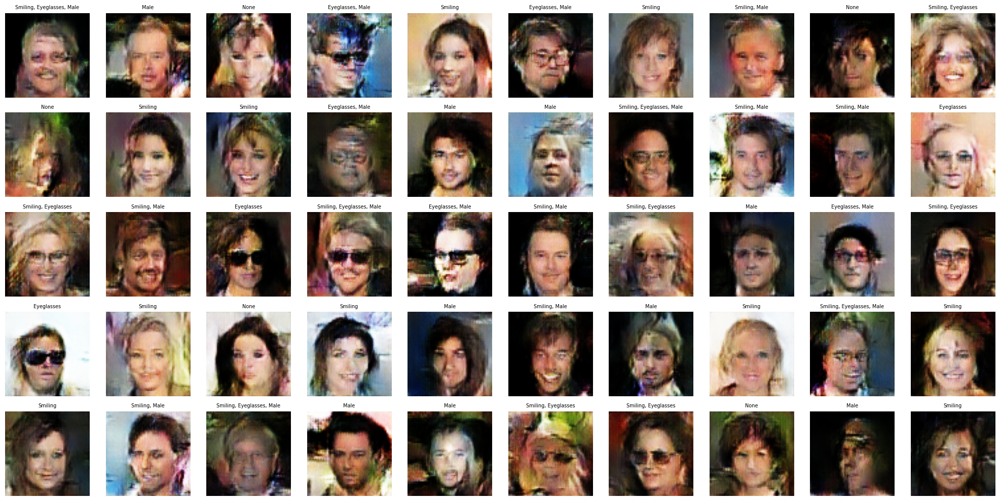

saved final samples


In [14]:
# cell 14: generate final sample grid
print("generating final sample grid (50 images)...")

sample_z = tf.random.normal([50, CONFIG["latent_dim"]])
sample_attrs = np.random.randint(0, 2, (50, 3)).astype(np.float32)
sample_imgs = generator([sample_z, tf.constant(sample_attrs)], training=False).numpy()

fig, axes = plt.subplots(5, 10, figsize=(20, 10))
axes = axes.flatten()

for i in range(50):
    img = (sample_imgs[i] + 1.0) * 0.5
    img = np.clip(img, 0, 1).astype(np.float32)
    axes[i].imshow(img)

    # get attribute labels
    attr_labels = [
        CONFIG["selected_attrs"][j] for j in range(3) if sample_attrs[i, j] > 0.5
    ]
    axes[i].set_title(", ".join(attr_labels) if attr_labels else "None", fontsize=7)
    axes[i].axis("off")

plt.tight_layout()
plt.savefig(os.path.join(CONFIG["exports_dir"], "final_samples.png"), dpi=150)
plt.show()

print("saved final samples")

In [15]:
# cell 15: save metrics to csv
metrics_path = os.path.join(CONFIG["exports_dir"], "training_metrics.csv")

with open(metrics_path, "w", newline="") as f:
    writer = csv.writer(f)
    writer.writerow(
        [
            "epoch",
            "d_loss",
            "g_loss",
            "d_adv",
            "d_attr",
            "g_adv",
            "g_attr",
            "val_attr_acc",
            "train_attr_acc",
        ]
    )

    for i in range(len(history["d_loss"])):
        writer.writerow(
            [
                i + 1,
                history["d_loss"][i],
                history["g_loss"][i],
                history["d_adv"][i],
                history["d_attr"][i],
                history["g_adv"][i],
                history["g_attr"][i],
                history["val_attr_acc"][i],
                history["train_attr_acc"][i],
            ]
        )

print(f"saved metrics to: {metrics_path}")

saved metrics to: /kaggle/working/exports/training_metrics.csv


In [16]:
# cell 16: export generator model
generator_save_path = os.path.join(CONFIG['exports_dir'], 'generator.keras')
generator.save(generator_save_path)
print(f"\nGenerator saved to: {generator_save_path}\n")

# export discriminator as well
discriminator_save_path = os.path.join(CONFIG['exports_dir'], 'discriminator.keras')
discriminator.save(discriminator_save_path)
print(f"\ndiscriminator saved to: {discriminator_save_path}\n")


Generator saved to: /kaggle/working/exports/generator.keras


discriminator saved to: /kaggle/working/exports/discriminator.keras



In [17]:
# cell 17: create sample images zip
zip_path = os.path.join(CONFIG["exports_dir"], "sample_images.zip")

with zipfile.ZipFile(zip_path, "w") as zf:
    for img_file in sorted(glob.glob(os.path.join(CONFIG["samples_dir"], "*.png"))):
        zf.write(img_file, arcname=os.path.basename(img_file))

print(f"sample images zipped to: {zip_path}")

sample images zipped to: /kaggle/working/exports/sample_images.zip


In [18]:
# cell 18: final summary and download instructions
print("TRAINING COMPLETE")

print(f"\ntrained for {len(history['d_loss'])} epochs")
print(f"final d_loss: {history['d_loss'][-1]:.4f}")
print(f"final g_loss: {history['g_loss'][-1]:.4f}")
print(f"final val_attr_acc: {history['val_attr_acc'][-1]:.4f}")

TRAINING COMPLETE

trained for 1620 epochs
final d_loss: 0.5774
final g_loss: 1.4995
final val_attr_acc: 0.9420
